In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import torch
import numpy as np
from scipy import signal
import matplotlib.pylab as plt
!pip install audio2numpy
import audio2numpy as a2n
from scipy.io.wavfile import write
import IPython
import cv2

  Created wheel for ffmpeg: filename=ffmpeg-1.4-py3-none-any.whl size=6084 sha256=f4e9fd7139ae56d846e94c1b6dc4047d66e7ee2310d4dcdda1b114431e47bcb2
  Stored in directory: /root/.cache/pip/wheels/64/80/6e/caa3e16deb0267c3cbfd36862058a724144e19fdb9eb03af0f
Successfully built ffmpeg


In [ ]:
device = torch.device("cuda")

# A)

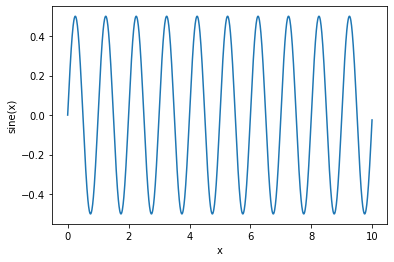

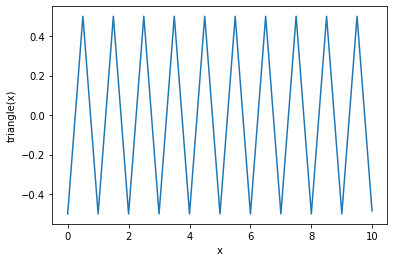

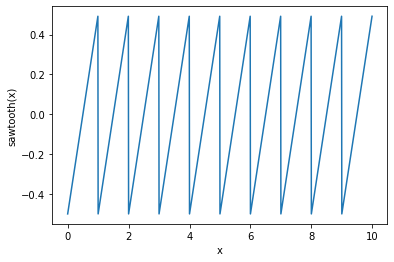

In [ ]:
fs = 128
x = np.linspace(0, 10*(1-1/(10*fs)), 10*fs)
sine = 0.5*np.sin(2*np.pi*x)
plt.plot(x, sine)
plt.xlabel('x')
plt.ylabel('sine(x)')
plt.show()
triangle = 0.5*signal.sawtooth(2*np.pi*x, 0.5)
plt.plot(x, triangle)
plt.xlabel('x')
plt.ylabel('triangle(x)')
plt.show()
sawtooth = 0.5*signal.sawtooth(2*np.pi*x, 1)
plt.plot(x, sawtooth)
plt.xlabel('x')
plt.ylabel('sawtooth(x)')
plt.show()

In [ ]:
sine_train = sine[0:int(7/10*len(sine))]
sine_validation = sine[int(7/10*len(sine)):int(8/10*len(sine))]
sine_test = sine[int(8/10*len(sine)):len(sine)]
triangle_train = triangle[0:int(7/10*len(triangle))]
triangle_validation = triangle[int(7/10*len(triangle)):int(8/10*len(triangle))]
triangle_test = triangle[int(8/10*len(triangle)):len(triangle)]
sawtooth_train = sawtooth[0:int(7/10*len(sawtooth))]
sawtooth_validation = sawtooth[int(7/10*len(sawtooth)):int(8/10*len(sawtooth))]
sawtooth_test = sawtooth[int(8/10*len(sawtooth)):len(sawtooth)]

# B)

Gaussian Noise

In [ ]:
gaussian_noisy_sine = sine + np.random.normal(0, 0.05, size=len(sine))
gaussian_noisy_triangle = triangle + np.random.normal(0, 0.05, size=len(triangle))
gaussian_noisy_sawtooth = sawtooth + np.random.normal(0, 0.05, size=len(sawtooth))

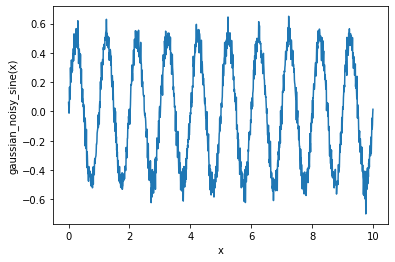

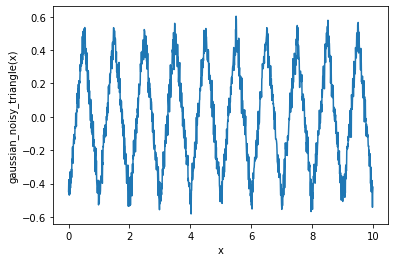

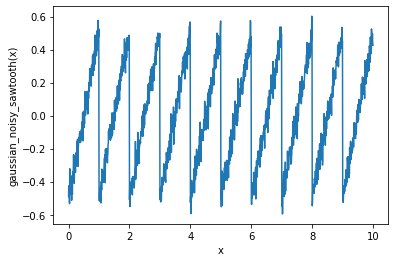

In [ ]:
plt.plot(x, gaussian_noisy_sine)
plt.xlabel('x')
plt.ylabel('gaussian_noisy_sine(x)')
plt.show()
plt.plot(x, gaussian_noisy_triangle)
plt.xlabel('x')
plt.ylabel('gaussian_noisy_triangle(x)')
plt.show()
plt.plot(x, gaussian_noisy_sawtooth)
plt.xlabel('x')
plt.ylabel('gaussian_noisy_sawtooth(x)')
plt.show()

In [ ]:
gaussian_noisy_sine_train = gaussian_noisy_sine[0:int(7/10*len(sine))]
gaussian_noisy_sine_validation = gaussian_noisy_sine[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_test = gaussian_noisy_sine[int(8/10*len(sine)):len(sine)]
gaussian_noisy_triangle_train = gaussian_noisy_triangle[0:int(7/10*len(triangle))]
gaussian_noisy_triangle_validation = gaussian_noisy_triangle[int(7/10*len(triangle)):int(8/10*len(triangle))]
gaussian_noisy_triangle_test = gaussian_noisy_triangle[int(8/10*len(triangle)):len(triangle)]
gaussian_noisy_sawtooth_train = gaussian_noisy_sawtooth[0:int(7/10*len(sawtooth))]
gaussian_noisy_sawtooth_validation = gaussian_noisy_sawtooth[int(7/10*len(sawtooth)):int(8/10*len(sawtooth))]
gaussian_noisy_sawtooth_test = gaussian_noisy_sawtooth[int(8/10*len(sawtooth)):len(sawtooth)]

Uniform Noise

In [ ]:
uniform_noisy_sine = sine + 0.1*(2*np.random.rand(len(sine))-1)
uniform_noisy_triangle = triangle + 0.1*(2*np.random.rand(len(triangle))-1)
uniform_noisy_sawtooth = sawtooth + 0.1*(2*np.random.rand(len(sawtooth))-1)

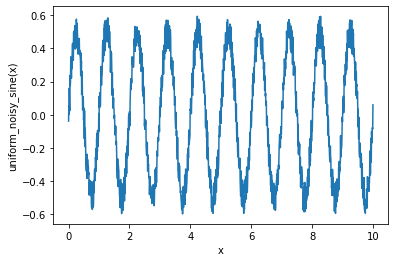

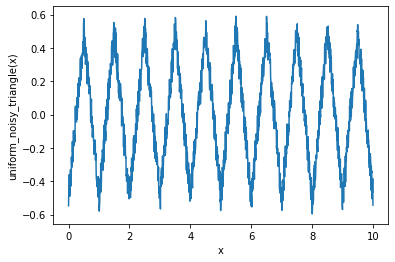

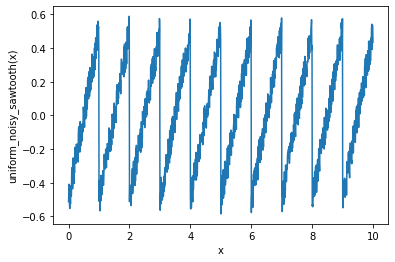

In [ ]:
plt.plot(x, uniform_noisy_sine)
plt.xlabel('x')
plt.ylabel('uniform_noisy_sine(x)')
plt.show()
plt.plot(x, uniform_noisy_triangle)
plt.xlabel('x')
plt.ylabel('uniform_noisy_triangle(x)')
plt.show()
plt.plot(x, uniform_noisy_sawtooth)
plt.xlabel('x')
plt.ylabel('uniform_noisy_sawtooth(x)')
plt.show()

In [ ]:
uniform_noisy_sine_train = uniform_noisy_sine[0:int(7/10*len(sine))]
uniform_noisy_sine_validation = uniform_noisy_sine[int(7/10*len(sine)):int(8/10*len(sine))]
uniform_noisy_sine_test = uniform_noisy_sine[int(8/10*len(sine)):len(sine)]
uniform_noisy_triangle_train = uniform_noisy_triangle[0:int(7/10*len(triangle))]
uniform_noisy_triangle_validation = uniform_noisy_triangle[int(7/10*len(triangle)):int(8/10*len(triangle))]
uniform_noisy_triangle_test = uniform_noisy_triangle[int(8/10*len(triangle)):len(triangle)]
uniform_noisy_sawtooth_train = uniform_noisy_sawtooth[0:int(7/10*len(sawtooth))]
uniform_noisy_sawtooth_validation = uniform_noisy_sawtooth[int(7/10*len(sawtooth)):int(8/10*len(sawtooth))]
uniform_noisy_sawtooth_test = uniform_noisy_sawtooth[int(8/10*len(sawtooth)):len(sawtooth)]

# C)

In [ ]:
def create_dataset(x, noisy_x, n_samples, sample_size):
  data_in = np.zeros((n_samples, sample_size))
  data_out = np.zeros((n_samples, sample_size))
  for i in range(n_samples):
    random_offset = np.random.randint(0, len(x)-sample_size-1)
    data_in[i, :] = noisy_x[random_offset:random_offset+sample_size]
    data_out[i, :] = x[random_offset+1:random_offset+sample_size+1]
  return data_in, data_out

In [ ]:
n_samples = 500
sample_size = int(1.25*fs)
gaussian_sine_train_dataset, gaussian_noisy_sine_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_train, n_samples, sample_size)
gaussian_triangle_train_dataset, gaussian_noisy_triangle_train_dataset = create_dataset(triangle_train, gaussian_noisy_triangle_train, n_samples, sample_size)
gaussian_sawtooth_train_dataset, gaussian_noisy_sawtooth_train_dataset = create_dataset(sawtooth_train, gaussian_noisy_sawtooth_train, n_samples, sample_size)
uniform_sine_train_dataset, uniform_noisy_sine_train_dataset = create_dataset(sine_train, uniform_noisy_sine_train, n_samples, sample_size)
uniform_triangle_train_dataset, uniform_noisy_triangle_train_dataset = create_dataset(triangle_train, uniform_noisy_triangle_train, n_samples, sample_size)
uniform_sawtooth_train_dataset, uniform_noisy_sawtooth_train_dataset = create_dataset(sawtooth_train, uniform_noisy_sawtooth_train, n_samples, sample_size)

In [ ]:
class CustomRNN(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomRNN, self).__init__()
        self.rnn = torch.nn.RNN(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.rnn(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred
class CustomLSTM(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomLSTM, self).__init__()
        self.lstm = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.lstm(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred

## Sine - Gaussain Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_rnn_model = CustomRNN(input_size, hidden_size, output_size)
sine_gaussian_rnn_model = sine_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0014370522694662213
200 0.001190527924336493
300 0.0010679198894649744
400 0.001029177219606936
500 0.0014351066201925278
600 0.0011789965210482478
700 0.0009927505161613226
800 0.0009317395742982626
900 0.0014963565627112985
1000 0.0011676803696900606
1100 0.0007532375166192651
1200 0.0006986429798416793
1300 0.0007197902305051684
1400 0.0005578562268055975
1500 0.0005469354218803346
1600 0.00046237968490459025
1700 0.0004403767525218427
1800 0.00042695217416621745
1900 0.0004290277720429003
2000 0.0004060193314217031
2100 0.00039663256029598415
2200 0.00038547819713130593
2300 0.0003784534346777946
2400 0.0003742125991266221
2500 0.00036387951695360243
2600 0.0003566217783372849
2700 0.0003526201471686363
2800 0.0003408222983125597
2900 0.00033970907679758966
3000 0.0003312444605398923
3100 0.0003258087090216577
3200 0.00032166176242753863
3300 0.0003202294174116105
3400 0.0003135991864837706
3500 0.0003106869990006089
3600 0.0003054737171623856
3700 0.0003019053256139159
3800 

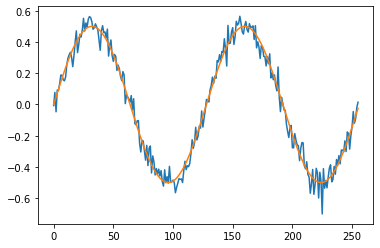

MSE Error = 0.0026861724244590665
SNR = 46.53461515046717
SNR(db) = 16.677761265712235


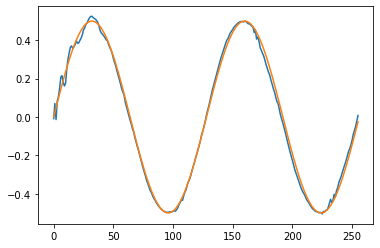

MSE Error = 0.0004982971642544051
SNR = 250.85432743137463
SNR(db) = 23.99421597344461


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_test)), gaussian_noisy_sine_test)
plt.plot(range(len(gaussian_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_lstm_model = sine_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0016825995407998562
200 0.0013845025096088648
300 0.001118697109632194
400 0.0010447603417560458
500 0.0008989113848656416
600 0.0007682773284614086
700 0.000627258385065943
800 0.0006003784947097301
900 0.0006930898525752127
1000 0.0005232539842836559
1100 0.0006824563606642187
1200 0.00043807437759824097
1300 0.0004012699064332992
1400 0.0003819666162598878
1500 0.0003613826120272279
1600 0.00031191244488582015
1700 0.00030714162858203053
1800 0.0002546810719650239
1900 0.00023940904065966606
2000 0.00022964963864069432
2100 0.0002237281296402216
2200 0.00021872867364436388
2300 0.00021452608052641153
2400 0.00021092488896101713
2500 0.00020783307263627648
2600 0.00020516662334557623
2700 0.00020284747006371617
2800 0.00020080899412278086
2900 0.0001989987795241177
3000 0.0001973772596102208
3100 0.00019591515592765063
3200 0.00019459021859802306
3300 0.00019338499987497926
3400 0.00019228529708925635
3500 0.00019127911946270615
3600 0.00019035629520658404
3700 0.00018950807861

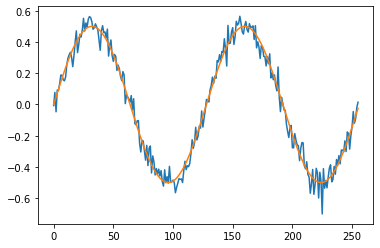

MSE Error = 0.0026861724244590665
SNR = 46.53461515046717
SNR(db) = 16.677761265712235


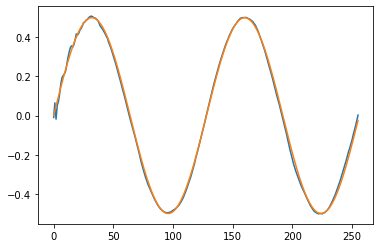

MSE Error = 0.00019535042129702483
SNR = 639.8757636152778
SNR(db) = 28.060956608371896


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_test)), gaussian_noisy_sine_test)
plt.plot(range(len(gaussian_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Triangle - Gaussain Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
triangle_gaussian_rnn_model = CustomRNN(input_size, hidden_size, output_size)
triangle_gaussian_rnn_model = triangle_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(triangle_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_triangle_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_triangle_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = triangle_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0013572201132774353
200 0.001522342674434185
300 0.0013947797706350684
400 0.0020147121977061033
500 0.001308273058384657
600 0.0015151589177548885
700 0.0013100520009174943
800 0.0012031092774122953
900 0.0011808082927018404
1000 0.0011576588731259108
1100 0.0014866245910525322
1200 0.0014005368575453758
1300 0.0013637423980981112
1400 0.001329515827819705
1500 0.0012846119934692979
1600 0.0012176069431006908
1700 0.0011354144662618637
1800 0.0010516801849007607
1900 0.000989883323200047
2000 0.0009378638933412731
2100 0.0008924062713049352
2200 0.0008637540740892291
2300 0.0008349514682777226
2400 0.000923597312066704
2500 0.0008004301926121116
2600 0.0007839230238460004
2700 0.0007711760117672384
2800 0.0007555285119451582
2900 0.0007434803992509842
3000 0.000728681159671396
3100 0.0007173569174483418
3200 0.0007053001900203526
3300 0.0006943847401998937
3400 0.0006835499661974609
3500 0.0006749727763235569
3600 0.0006662884261459112
3700 0.0006586156669072807
3800 0.000652030

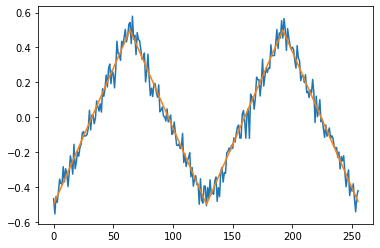

MSE Error = 0.0026794878156555864
SNR = 31.115656861869688
SNR(db) = 14.929789735182803


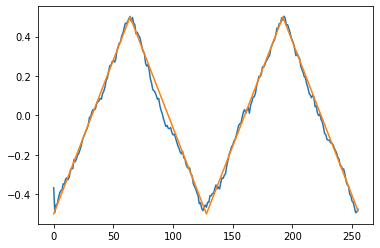

MSE Error = 0.0007317048976621596
SNR = 113.94487545988132
SNR(db) = 20.56694798059255


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_triangle_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(triangle_gaussian_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_triangle_test)), gaussian_noisy_triangle_test)
plt.plot(range(len(gaussian_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - gaussian_noisy_triangle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - gaussian_noisy_triangle_test, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_triangle_test)), pred)
plt.plot(range(len(gaussian_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - pred, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Triangle - Gaussain Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
triangle_gaussian_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
triangle_gaussian_lstm_model = triangle_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(triangle_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_triangle_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_triangle_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = triangle_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0015122905606403947
200 0.0013032464776188135
300 0.0010207139421254396
400 0.0010806919308379292
500 0.0008927236194722354
600 0.0009301418322138488
700 0.000793715356849134
800 0.0007090407307259738
900 0.0005980842397548258
1000 0.0005131069920025766
1100 0.0006947194924578071
1200 0.0003508594527374953
1300 0.0006597723113372922
1400 0.00026904401602223516
1500 0.00025286286836490035
1600 0.00023767139646224678
1700 0.00022931692365091294
1800 0.0002210514503531158
1900 0.000221965805394575
2000 0.00021110023953951895
2100 0.00020722216868307441
2200 0.0002040462422883138
2300 0.00020136414968874305
2400 0.00019921276543755084
2500 0.00019707933824975044
2600 0.00019527054973877966
2700 0.00019364076433703303
2800 0.00019216393411625177
2900 0.00019082118524238467
3000 0.00018959744193125516
3100 0.00018848005856852978
3200 0.0001874579320428893
3300 0.00018652102153282613
3400 0.00018566023209132254
3500 0.00018486741464585066
3600 0.0001841351913753897
3700 0.00018345717398

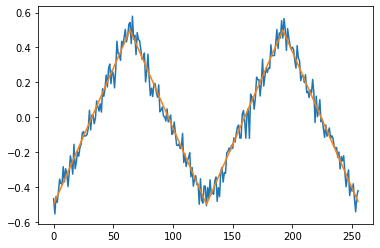

MSE Error = 0.0026794878156555864
SNR = 31.115656861869688
SNR(db) = 14.929789735182803


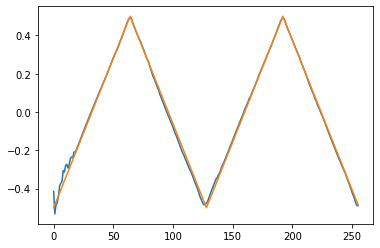

MSE Error = 0.00024124964056543958
SNR = 345.5923218873545
SNR(db) = 25.385640850829102


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_triangle_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(triangle_gaussian_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_triangle_test)), gaussian_noisy_triangle_test)
plt.plot(range(len(gaussian_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - gaussian_noisy_triangle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - gaussian_noisy_triangle_test, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_triangle_test)), pred)
plt.plot(range(len(gaussian_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - pred, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sawtooth - Gaussain Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sawtooth_gaussian_rnn_model = CustomRNN(input_size, hidden_size, output_size)
sawtooth_gaussian_rnn_model = sawtooth_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sawtooth_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sawtooth_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sawtooth_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sawtooth_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.008795543573796749
200 0.008566479198634624
300 0.00843009166419506
400 0.008990875445306301
500 0.007466176990419626
600 0.006875479128211737
700 0.006659161299467087
800 0.005052617285400629
900 0.008194810710847378
1000 0.0030919695273041725
1100 0.0012527795042842627
1200 0.0013608604203909636
1300 0.0008992055663838983
1400 0.0007993170293048024
1500 0.0007356616551987827
1600 0.0008126687025651336
1700 0.0007113197352737188
1800 0.0006709840381518006
1900 0.0006416343385353684
2000 0.0006173691363073885
2100 0.0005961422575637698
2200 0.0005771180731244385
2300 0.0005748316762037575
2400 0.0005540439742617309
2500 0.0005403315299190581
2600 0.0005891830078326166
2700 0.0005242134211584926
2800 0.000513885694090277
2900 0.0005046940641477704
3000 0.0005071379127912223
3100 0.000492325983941555
3200 0.0004852796555496752
3300 0.0004787429643329233
3400 0.0004751537344418466
3500 0.0004695046227425337
3600 0.00046444201143458486
3700 0.00046276929788291454
3800 0.0004563059774

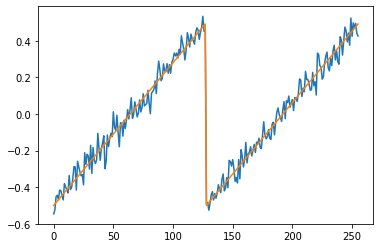

MSE Error = 0.00221543375349321
SNR = 37.619498090593865
SNR(db) = 15.754129970107558


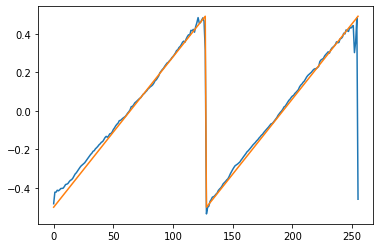

MSE Error = 0.0041588716170568975
SNR = 20.03993235029327
SNR(db) = 13.01896251130142


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sawtooth_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sawtooth_gaussian_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sawtooth_test)), gaussian_noisy_sawtooth_test)
plt.plot(range(len(gaussian_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - gaussian_noisy_sawtooth_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - gaussian_noisy_sawtooth_test, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sawtooth_test)), pred)
plt.plot(range(len(gaussian_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - pred, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sawtooth - Gaussain Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sawtooth_gaussian_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sawtooth_gaussian_lstm_model = sawtooth_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sawtooth_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sawtooth_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sawtooth_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sawtooth_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.00829094834625721
200 0.008114626631140709
300 0.008044798858463764
400 0.008198936469852924
500 0.007683045230805874
600 0.006859895307570696
700 0.004754134453833103
800 0.005097522865980864
900 0.007078889291733503
1000 0.0047987960278987885
1100 0.003449867246672511
1200 0.003289776621386409
1300 0.0033405364956706762
1400 0.0033956703264266253
1500 0.0027582193724811077
1600 0.0028373419772833586
1700 0.002000105567276478
1800 0.0017302051419392228
1900 0.0017036756034940481
2000 0.0013867130037397146
2100 0.0012153844581916928
2200 0.001090081175789237
2300 0.0012073711259290576
2400 0.0010080651845782995
2500 0.000977924675680697
2600 0.0009570565889589489
2700 0.0009405760793015361
2800 0.000926939828786999
2900 0.0009153058636002243
3000 0.0009051503730006516
3100 0.000896130339242518
3200 0.0008880087407305837
3300 0.0008806148543953896
3400 0.0008738211472518742
3500 0.0008675302378833294
3600 0.0008616674458608031
3700 0.0008561744471080601
3800 0.0008510066545568407


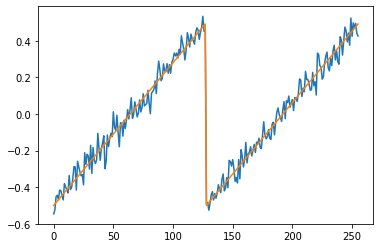

MSE Error = 0.00221543375349321
SNR = 37.619498090593865
SNR(db) = 15.754129970107558


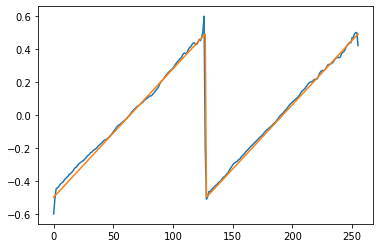

MSE Error = 0.002263898062322954
SNR = 36.814160163138
SNR(db) = 15.66014897419669


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sawtooth_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sawtooth_gaussian_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sawtooth_test)), gaussian_noisy_sawtooth_test)
plt.plot(range(len(gaussian_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - gaussian_noisy_sawtooth_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - gaussian_noisy_sawtooth_test, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sawtooth_test)), pred)
plt.plot(range(len(gaussian_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - pred, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Uniform Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_uniform_rnn_model = CustomRNN(input_size, hidden_size, output_size)
sine_uniform_rnn_model = sine_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_sine_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_sine_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0015762124676257372
200 0.002778128255158663
300 0.0017898635705932975
400 0.001280136057175696
500 0.0012507825158536434
600 0.0015356282237917185
700 0.0014077774249017239
800 0.0012500311713665724
900 0.001219889847561717
1000 0.001201263046823442
1100 0.001178961363621056
1200 0.0011498902458697557
1300 0.0011075246147811413
1400 0.0013307282933965325
1500 0.0012263087555766106
1600 0.0008381602237932384
1700 0.000782518764026463
1800 0.000739441835321486
1900 0.0007020554621703923
2000 0.0007150183664634824
2100 0.0006404582527466118
2200 0.0006137094460427761
2300 0.0006041089654900134
2400 0.0005693160928785801
2500 0.0005509722977876663
2600 0.0005370542639866471
2700 0.0005246548098511994
2800 0.0005131365614943206
2900 0.0005015681381337345
3000 0.0004898881888948381
3100 0.00047709912178106606
3200 0.0004664322186727077
3300 0.00045015205978415906
3400 0.0004365433705970645
3500 0.00042505786404944956
3600 0.00041483371751382947
3700 0.00040599441854283214
3800 0.00039

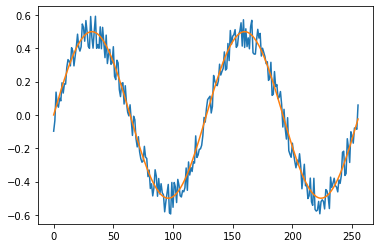

MSE Error = 0.0036616179261393764
SNR = 34.137914583511346
SNR(db) = 15.332369874132734


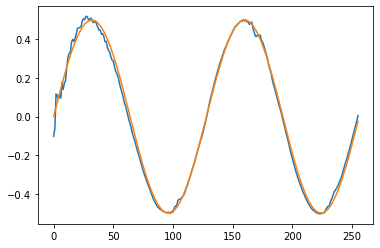

MSE Error = 0.0005714467040155783
SNR = 218.74305883929352
SNR(db) = 23.39934280868657


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_sine_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_uniform_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_sine_test)), uniform_noisy_sine_test)
plt.plot(range(len(uniform_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - uniform_noisy_sine_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - uniform_noisy_sine_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_sine_test)), pred)
plt.plot(range(len(uniform_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Uniform Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_uniform_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_uniform_lstm_model = sine_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_sine_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_sine_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0018884813180193305
200 0.001695282175205648
300 0.0014575514942407608
400 0.0013469959376379848
500 0.0012734708143398166
600 0.0011943394783884287
700 0.0013743427116423845
800 0.0011067315936088562
900 0.0009102121111936867
1000 0.0007324335747398436
1100 0.000652297749184072
1200 0.0006269877194426954
1300 0.0006150334957055748
1400 0.0006010103388689458
1500 0.0005912597407586873
1600 0.0005401868838816881
1700 0.00044040856300853193
1800 0.00040979814366437495
1900 0.00036707232357002795
2000 0.00037121667992323637
2100 0.0003353582869749516
2200 0.00032125928555615246
2300 0.00030894114752300084
2400 0.0002951579517684877
2500 0.00028364566969685256
2600 0.00027483576559461653
2700 0.000267341936705634
2800 0.0002612009411677718
2900 0.0002563126909080893
3000 0.0002520482521504164
3100 0.00024822779232636094
3200 0.0002447647857479751
3300 0.00024159831809811294
3400 0.00023868397693149745
3500 0.00023599332780577242
3600 0.00023351125128101557
3700 0.0002312319411430508


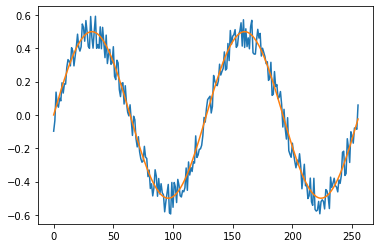

MSE Error = 0.0036616179261393764
SNR = 34.137914583511346
SNR(db) = 15.332369874132734


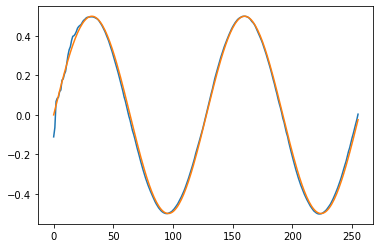

MSE Error = 0.00032349205191224055
SNR = 386.4082572078494
SNR(db) = 25.870463983373718


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_sine_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_uniform_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_sine_test)), uniform_noisy_sine_test)
plt.plot(range(len(uniform_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - uniform_noisy_sine_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - uniform_noisy_sine_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_sine_test)), pred)
plt.plot(range(len(uniform_noisy_sine_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Triangle - Uniform Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
triangle_uniform_rnn_model = CustomRNN(input_size, hidden_size, output_size)
triangle_uniform_rnn_model = triangle_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(triangle_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_triangle_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_triangle_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = triangle_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0019205081043764949
200 0.0011769853299483657
300 0.0012789928587153554
400 0.0010865818476304412
500 0.001039234921336174
600 0.0010171100730076432
700 0.001007262384518981
800 0.0009224252426065505
900 0.0008764392696321011
1000 0.0008880485547706485
1100 0.0007732893573120236
1200 0.0007178304949775338
1300 0.0006679498474113643
1400 0.0006303502595983446
1500 0.0006371936178766191
1600 0.0005918136448599398
1700 0.0005613234243355691
1800 0.0005337503389455378
1900 0.0005066698649898171
2000 0.0008096095989458263
2100 0.0004622248525265604
2200 0.0004433622816577554
2300 0.00042563467286527157
2400 0.0004232252831570804
2500 0.0003901186864823103
2600 0.00038028747076168656
2700 0.0003664570103865117
2800 0.00035839457996189594
2900 0.00034966395469382405
3000 0.0003454290854278952
3100 0.00033869469189085066
3200 0.0003331757034175098
3300 0.00032735959393903613
3400 0.00032104048295877874
3500 0.0003177108592353761
3600 0.0003138083848170936
3700 0.00031022605253383517
3800

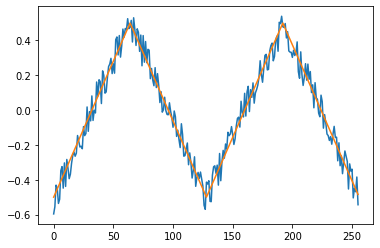

MSE Error = 0.0033888671762005995
SNR = 24.60232847808868
SNR(db) = 13.90976212685866


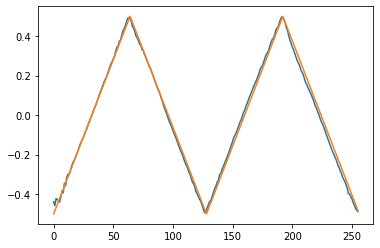

MSE Error = 0.00040469266357500897
SNR = 206.01812422538953
SNR(db) = 23.139054286450403


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_triangle_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(triangle_uniform_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_triangle_test)), uniform_noisy_triangle_test)
plt.plot(range(len(uniform_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - uniform_noisy_triangle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - uniform_noisy_triangle_test, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_triangle_test)), pred)
plt.plot(range(len(uniform_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - pred, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Triangle - Uniform Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
triangle_uniform_lstm_model = CustomRNN(input_size, hidden_size, output_size)
triangle_uniform_lstm_model = triangle_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(triangle_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_triangle_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_triangle_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = triangle_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0018758571241050959
200 0.0015481616137549281
300 0.00152295152656734
400 0.0018114384729415178
500 0.0021999464370310307
600 0.0012238116469234228
700 0.0014916366199031472
800 0.0019360524602234364
900 0.0011519435793161392
1000 0.0010070560965687037
1100 0.0008699134341441095
1200 0.0007398097077384591
1300 0.0006005907780490816
1400 0.0005129353376105428
1500 0.00045912430505268276
1600 0.0004193910863250494
1700 0.00038926673005335033
1800 0.00036870804615318775
1900 0.0003485954075586051
2000 0.0003343380813021213
2100 0.00031994853634387255
2200 0.00031647944706492126
2300 0.0002992012305185199
2400 0.0002908084716182202
2500 0.0002834201150108129
2600 0.0002768422709777951
2700 0.00027094673714600503
2800 0.00026564105064608157
2900 0.00026085355784744024
3000 0.00025652546901255846
3100 0.0002526070747990161
3200 0.0002490548649802804
3300 0.00024583085905760527
3400 0.00024290107830893248
3500 0.0002402353275101632
3600 0.0002378064818913117
3700 0.0002355903561692685
3

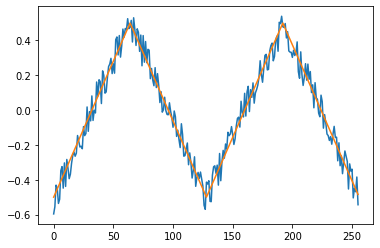

MSE Error = 0.0033888671762005995
SNR = 24.60232847808868
SNR(db) = 13.90976212685866


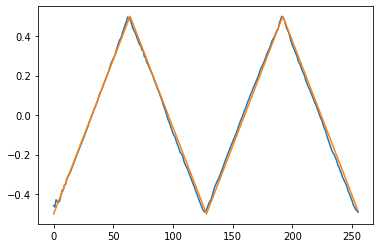

MSE Error = 0.00037596522319186085
SNR = 221.75993494736858
SNR(db) = 23.45883085532709


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_triangle_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(triangle_uniform_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_triangle_test)), uniform_noisy_triangle_test)
plt.plot(range(len(uniform_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - uniform_noisy_triangle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - uniform_noisy_triangle_test, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_triangle_test)), pred)
plt.plot(range(len(uniform_noisy_triangle_test)), triangle_test)
plt.show()
MSE_erreor = np.mean(np.power(triangle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(triangle_test - pred, 2))
signal_power = np.mean(np.power(triangle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sawtooth - Uniform Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sawtooth_uniform_rnn_model = CustomRNN(input_size, hidden_size, output_size)
sawtooth_uniform_rnn_model = sawtooth_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sawtooth_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_sawtooth_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_sawtooth_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sawtooth_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.009470317512750626
200 0.009049100801348686
300 0.009136888198554516
400 0.008910702541470528
500 0.009019048884510994
600 0.007832811214029789
700 0.007411154918372631
800 0.006150444038212299
900 0.006379389204084873
1000 0.005037488881498575
1100 0.0036252376157790422
1200 0.0016181929968297482
1300 0.0015543288318440318
1400 0.0010853917337954044
1500 0.000949426437728107
1600 0.0008462567930109799
1700 0.000804408045951277
1800 0.000951523776166141
1900 0.0006487129139713943
2000 0.0007974194013513625
2100 0.0006296540959738195
2200 0.0005737505853176117
2300 0.0005660170572809875
2400 0.0005405294359661639
2500 0.0005303415236994624
2600 0.0005416292115114629
2700 0.0005123860901221633
2800 0.0005055929068475962
2900 0.0004987224820069969
3000 0.0004939922946505249
3100 0.00048785237595438957
3200 0.0004830947727896273
3300 0.00047879270277917385
3400 0.0004749470972456038
3500 0.00047138164518401027
3600 0.0004681321152020246
3700 0.0004651540657505393
3800 0.0004624182474

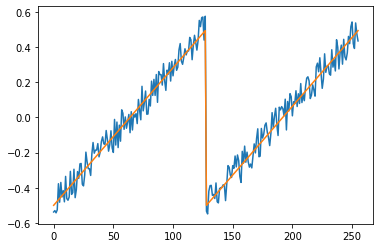

MSE Error = 0.0033091352492917213
SNR = 25.185886819589385
SNR(db) = 14.011572473943827


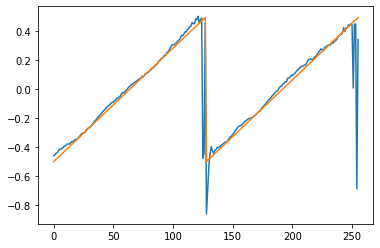

MSE Error = 0.014309301899138045
SNR = 5.824428504397925
SNR(db) = 7.6525331861434225


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_sawtooth_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sawtooth_uniform_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_sawtooth_test)), uniform_noisy_sawtooth_test)
plt.plot(range(len(uniform_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - uniform_noisy_sawtooth_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - uniform_noisy_sawtooth_test, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_sawtooth_test)), pred)
plt.plot(range(len(uniform_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - pred, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sawtooth - Uniform Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sawtooth_uniform_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sawtooth_uniform_lstm_model = sawtooth_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sawtooth_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_sawtooth_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_sawtooth_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sawtooth_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.008179702796041965
200 0.008083178661763668
300 0.005836938042193651
400 0.0045248898677527905
500 0.005296208895742893
600 0.0025997799821197987
700 0.0026974277570843697
800 0.0013647809391841292
900 0.00100315036252141
1000 0.0007365780766122043
1100 0.0006456300616264343
1200 0.0006201387150213122
1300 0.0004993815091438591
1400 0.00046865857439115644
1500 0.00044514884939417243
1600 0.00042634873534552753
1700 0.0004245794552844018
1800 0.0003959966416005045
1900 0.00039849753375165164
2000 0.00038223035517148674
2100 0.0003703284601215273
2200 0.0003655953914858401
2300 0.00035696037230081856
2400 0.0003497140423860401
2500 0.0003455749829299748
2600 0.0003415406681597233
2700 0.0003381397982593626
2800 0.0003352487983647734
2900 0.00033349398290738463
3000 0.0003304680285509676
3100 0.0003284772683400661
3200 0.00032682123128324747
3300 0.00032512773759663105
3400 0.00032369588734582067
3500 0.00032239698339253664
3600 0.0003212138544768095
3700 0.0003201327344868332
3800 

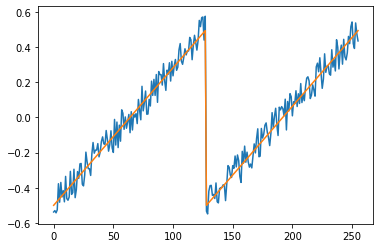

MSE Error = 0.0033091352492917213
SNR = 25.185886819589385
SNR(db) = 14.011572473943827


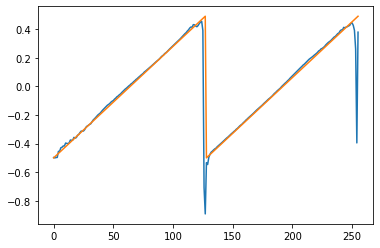

MSE Error = 0.016453322435339847
SNR = 5.065451442218303
SNR(db) = 7.046181565329204


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_sawtooth_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sawtooth_uniform_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_sawtooth_test)), uniform_noisy_sawtooth_test)
plt.plot(range(len(uniform_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - uniform_noisy_sawtooth_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - uniform_noisy_sawtooth_test, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_sawtooth_test)), pred)
plt.plot(range(len(uniform_noisy_sawtooth_test)), sawtooth_test)
plt.show()
MSE_erreor = np.mean(np.power(sawtooth_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sawtooth_test - pred, 2))
signal_power = np.mean(np.power(sawtooth_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

# D)

## Sine - Gaussain Noise with Variance 0.01 - LSTM

In [ ]:
gaussian_noisy_sine_1 = sine + np.random.normal(0, 0.01, size=len(sine))
gaussian_noisy_sine_1_train = gaussian_noisy_sine_1[0:int(7/10*len(sine))]
gaussian_noisy_sine_1_validation = gaussian_noisy_sine_1[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_1_test = gaussian_noisy_sine_1[int(8/10*len(sine)):len(sine)]
gaussian_sine_1_train_dataset, gaussian_noisy_sine_1_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_1_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_1_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_1_lstm_model = sine_gaussian_1_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_1_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_1_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_1_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_1_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0003155435551889241
200 0.000257558305747807
300 0.00024316634517163038
400 0.00022987664851825684
500 0.00021730839216616005
600 0.00020492395560722798
700 0.00019167561549693346
800 0.00017542295972816646
900 0.00016677707026246935
1000 0.0001521014200989157
1100 0.00014078296953812242
1200 0.00013067205145489424
1300 0.00012064811016898602
1400 0.00011532346979947761
1500 0.00010763754835352302
1600 0.0001044436648953706
1700 0.00010202519479207695
1800 0.0001003714423859492
1900 9.839350241236389e-05
2000 9.655067697167397e-05
2100 9.52946356846951e-05
2200 9.330973989563063e-05
2300 9.165072697214782e-05
2400 9.040186705533415e-05
2500 8.859294030116871e-05
2600 8.70629955898039e-05
2700 8.58600324136205e-05
2800 8.429553417954594e-05
2900 8.296417945530266e-05
3000 8.169223292497918e-05
3100 8.05383751867339e-05
3200 7.941287913126871e-05
3300 7.836070290068164e-05
3400 7.736427505733445e-05
3500 7.646893209312111e-05
3600 7.554521289421245e-05
3700 7.471484423149377e-05
38

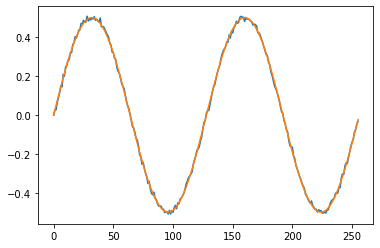

MSE Error = 9.465049656537112e-05
SNR = 1320.6481163431376
SNR(db) = 31.207871162609624


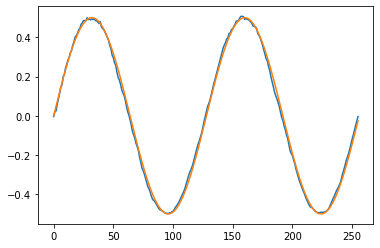

MSE Error = 0.000306454825834428
SNR = 407.8904603954099
SNR(db) = 26.10543548302924


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_1_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_1_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_1_test)), gaussian_noisy_sine_1_test)
plt.plot(range(len(gaussian_noisy_sine_1_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_1_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_1_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_1_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_1_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Variance 0.05 - LSTM

In [ ]:
gaussian_noisy_sine_5 = sine + np.random.normal(0, 0.05, size=len(sine))
gaussian_noisy_sine_5_train = gaussian_noisy_sine_5[0:int(7/10*len(sine))]
gaussian_noisy_sine_5_validation = gaussian_noisy_sine_5[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_5_test = gaussian_noisy_sine_5[int(8/10*len(sine)):len(sine)]
gaussian_sine_5_train_dataset, gaussian_noisy_sine_5_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_5_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_5_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_5_lstm_model = sine_gaussian_5_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_5_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_5_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_5_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_5_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0014445858541876078
200 0.0012066031340509653
300 0.0010388019727542996
400 0.0008891817997209728
500 0.0007395459688268602
600 0.0006423651939257979
700 0.0006090473034419119
800 0.0005460908287204802
900 0.0005185009795241058
1000 0.0004139220982324332
1100 0.0005155369872227311
1200 0.0002553744416218251
1300 0.00023626736947335303
1400 0.00022823867038823664
1500 0.00021217417088337243
1600 0.0002060432598227635
1700 0.0002008115261560306
1800 0.00019650229660328478
1900 0.0001933283929247409
2000 0.0001900333445519209
2100 0.00018753157928586006
2200 0.00018506849301047623
2300 0.0001830176479415968
2400 0.00018197664758190513
2500 0.0001797486620489508
2600 0.00017834588652476668
2700 0.00017706438666209579
2800 0.00017591436335351318
2900 0.00017481943359598517
3000 0.0001738023856887594
3100 0.00017284220666624606
3200 0.0001719318825053051
3300 0.00017106688756030053
3400 0.00017024745466187596
3500 0.0001694698294159025
3600 0.00016873085405677557
3700 0.000168029451742

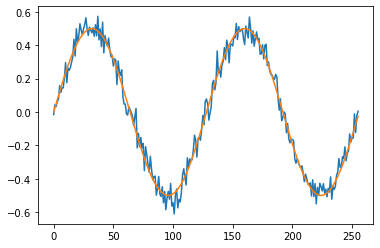

MSE Error = 0.0024529794431305306
SNR = 50.95843764612762
SNR(db) = 17.07216104333829


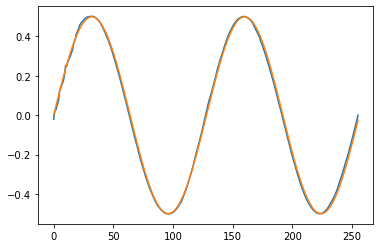

MSE Error = 0.00018507372894432242
SNR = 675.4065026571384
SNR(db) = 28.295652376060527


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_5_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_5_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_5_test)), gaussian_noisy_sine_5_test)
plt.plot(range(len(gaussian_noisy_sine_5_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_5_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_5_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_5_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_5_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Variance 0.1 - LSTM

In [ ]:
gaussian_noisy_sine_10 = sine + np.random.normal(0, 0.1, size=len(sine))
gaussian_noisy_sine_10_train = gaussian_noisy_sine_10[0:int(7/10*len(sine))]
gaussian_noisy_sine_10_validation = gaussian_noisy_sine_10[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_10_test = gaussian_noisy_sine_10[int(8/10*len(sine)):len(sine)]
gaussian_sine_10_train_dataset, gaussian_noisy_sine_10_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_10_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_10_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_10_lstm_model = sine_gaussian_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_10_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_10_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.004139384720474482
200 0.0030392659828066826
300 0.002426078077405691
400 0.002117852447554469
500 0.0020295341964811087
600 0.0014051131438463926
700 0.001280931057408452
800 0.0011378888739272952
900 0.0008898237138055265
1000 0.001072064507752657
1100 0.0007515686447732151
1200 0.0007167888688854873
1300 0.0007074678433127701
1400 0.0006509957020170987
1500 0.0006287540309131145
1600 0.0006188545376062393
1700 0.0006098985904827714
1800 0.0005951595376245677
1900 0.0005863307160325348
2000 0.0005788329290226102
2100 0.0005727495881728828
2200 0.0005683298222720623
2300 0.0005648779333569109
2400 0.0005620305892080069
2500 0.0005595322581939399
2600 0.0005572558147832751
2700 0.0005551378708332777
2800 0.0005531439674086869
2900 0.000551254372112453
3000 0.0005494570359587669
3100 0.0005477443337440491
3200 0.0005461110267788172
3300 0.0005445534479804337
3400 0.0005430683959275484
3500 0.0005416533094830811
3600 0.0005403056275099516
3700 0.000539022556040436
3800 0.0005378013

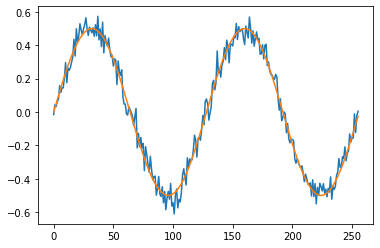

MSE Error = 0.01115493317034082
SNR = 11.205804471545823
SNR(db) = 10.494430402563442


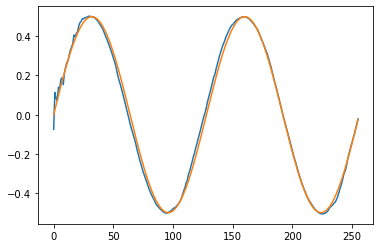

MSE Error = 0.0005654206194181852
SNR = 221.07435722564261
SNR(db) = 23.445383709764958


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_10_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_10_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_10_test)), gaussian_noisy_sine_10_test)
plt.plot(range(len(gaussian_noisy_sine_10_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_10_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_10_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_10_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Variance 0.25 - LSTM

In [ ]:
gaussian_noisy_sine_25 = sine + np.random.normal(0, 0.25, size=len(sine))
gaussian_noisy_sine_25_train = gaussian_noisy_sine_25[0:int(7/10*len(sine))]
gaussian_noisy_sine_25_validation = gaussian_noisy_sine_25[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_25_test = gaussian_noisy_sine_25[int(8/10*len(sine)):len(sine)]
gaussian_sine_25_train_dataset, gaussian_noisy_sine_25_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_25_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_25_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_25_lstm_model = sine_gaussian_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_25_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_25_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.008483999408781528
200 0.00500468909740448
300 0.004288188647478819
400 0.0027736041229218245
500 0.0023534270003437996
600 0.0024126649368554354
700 0.0019427352817729115
800 0.001827396685257554
900 0.002365726511925459
1000 0.0016449843533337116
1100 0.0015802689595147967
1200 0.0015507248463109136
1300 0.0014924273127689958
1400 0.0014668840449303389
1500 0.0014499949757009745
1600 0.0014255284331738949
1700 0.001408558338880539
1800 0.00139480154030025
1900 0.0013851928524672985
2000 0.0013724364107474685
2100 0.0013638673117384315
2200 0.0013509051641449332
2300 0.0013418898452073336
2400 0.001332353218458593
2500 0.0013245928566902876
2600 0.0013150518061593175
2700 0.001308039645664394
2800 0.0012984893983229995
2900 0.0012916333507746458
3000 0.0012841575080528855
3100 0.0012778135715052485
3200 0.0012720999075099826
3300 0.0012666519032791257
3400 0.001261520548723638
3500 0.0012567851226776838
3600 0.0012523168697953224
3700 0.0012480757432058454
3800 0.001244035665877

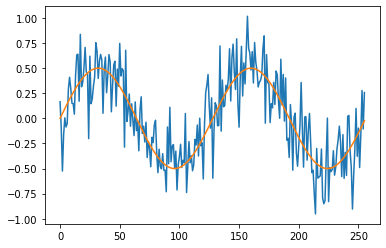

MSE Error = 0.05795556290364469
SNR = 2.15682487991397
SNR(db) = 3.338148846600411


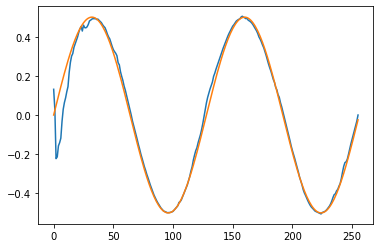

MSE Error = 0.002469293123094891
SNR = 50.62177464104833
SNR(db) = 17.04337366094954


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_25_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_25_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_25_test)), gaussian_noisy_sine_25_test)
plt.plot(range(len(gaussian_noisy_sine_25_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_25_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_25_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_25_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Variance 0.5 - LSTM

In [ ]:
gaussian_noisy_sine_50_50 = sine + np.random.normal(0, 0.5, size=len(sine))
gaussian_noisy_sine_50_50_train = gaussian_noisy_sine_50_50[0:int(7/10*len(sine))]
gaussian_noisy_sine_50_50_validation = gaussian_noisy_sine_50_50[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_50_50_test = gaussian_noisy_sine_50_50[int(8/10*len(sine)):len(sine)]
gaussian_sine_50_50_train_dataset, gaussian_noisy_sine_50_50_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_50_50_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_50_50_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_50_50_lstm_model = sine_gaussian_50_50_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_50_50_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_50_50_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_50_50_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_50_50_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.020811764523386955
200 0.020198263227939606
300 0.008896330371499062
400 0.006322466302663088
500 0.005323322024196386
600 0.004873340483754873
700 0.004616644233465195
800 0.004434539470821619
900 0.004055825527757406
1000 0.003925803117454052
1100 0.003935500513762236
1200 0.0037060026079416275
1300 0.003584399353712797
1400 0.003613128559663892
1500 0.0033401057589799166
1600 0.003198901191353798
1700 0.0031042839400470257
1800 0.003021004842594266
1900 0.0029505938291549683
2000 0.002895287238061428
2100 0.0028500985354185104
2200 0.0028107943944633007
2300 0.002774513093754649
2400 0.002739940071478486
2500 0.0027065742760896683
2600 0.0026742874179035425
2700 0.0026429223362356424
2800 0.0026119148824363947
2900 0.0025807174388319254
3000 0.002550986362621188
3100 0.002523689763620496
3200 0.0024994120467454195
3300 0.0024778463412076235
3400 0.002458446891978383
3500 0.0024409086909145117
3600 0.0024250608403235674
3700 0.0024107557255774736
3800 0.0023978413082659245
3900

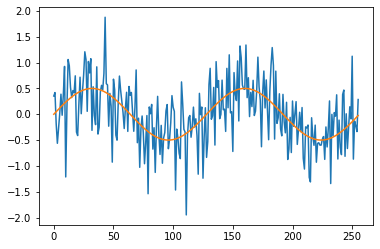

MSE Error = 0.25363745311995656
SNR = 0.49282942429201054
SNR(db) = -3.073033705957245


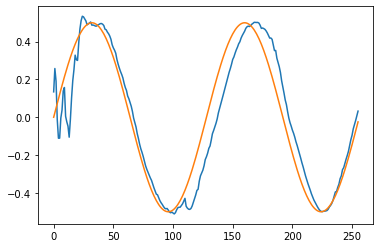

MSE Error = 0.013873180730501622
SNR = 9.010190411862405
SNR(db) = 9.547339689976347


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_50_50_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_50_50_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), gaussian_noisy_sine_50_50_test)
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_50_50_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_50_50_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Comparison

For variances less than 0.1, the performance of the model is acceptable. But the model loses its quality and at some points gets distance from the desired sine when the noise variance increases more than this (variances greater than or equal to 0.5). So the threshold for recovering the signal is variances somewhere between 0.1 to 0.5.

# E)

## Sine - Gaussain Noise with Mean between -0.01 to 0.01 and Variance between 0 to 0.01 - LSTM

In [ ]:
gaussian_noisy_sine_1_1 = sine + np.random.normal(0.01*(2*np.random.rand(len(sine))-1), 0.01*np.random.rand(len(sine)), size=len(sine))
gaussian_noisy_sine_1_1_train = gaussian_noisy_sine_1_1[0:int(7/10*len(sine))]
gaussian_noisy_sine_1_1_validation = gaussian_noisy_sine_1_1[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_1_1_test = gaussian_noisy_sine_1_1[int(8/10*len(sine)):len(sine)]
gaussian_sine_1_1_train_dataset, gaussian_noisy_sine_1_1_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_1_1_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_1_1_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_1_1_lstm_model = sine_gaussian_1_1_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_1_1_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_1_1_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_1_1_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_1_1_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0002623400650918484
200 0.00021454558009281754
300 0.0001760306186042726
400 0.00014354329323396087
500 0.00011427335266489536
600 0.00010104732064064592
700 8.513205102644861e-05
800 7.716994150541723e-05
900 9.454781684326008e-05
1000 7.290326175279915e-05
1100 7.15290370862931e-05
1200 7.042303332127631e-05
1300 6.949153612367809e-05
1400 6.868228956591338e-05
1500 6.796351954108104e-05
1600 6.731483881594613e-05
1700 6.672217568848282e-05
1800 6.617551844101399e-05
1900 6.566738738911226e-05
2000 6.519215094158426e-05
2100 6.474541442003101e-05
2200 6.43237799522467e-05
2300 6.39245699858293e-05
2400 6.354566721711308e-05
2500 6.318533269222826e-05
2600 6.284219125518575e-05
2700 6.251506420085207e-05
2800 6.220302020665258e-05
2900 6.190521526150405e-05
3000 6.162092904560268e-05
3100 6.134955765446648e-05
3200 6.10905044595711e-05
3300 6.084325650590472e-05
3400 6.060734813218005e-05
3500 6.0382306401152164e-05
3600 6.016768020344898e-05
3700 5.996308027533814e-05
3800 5.97

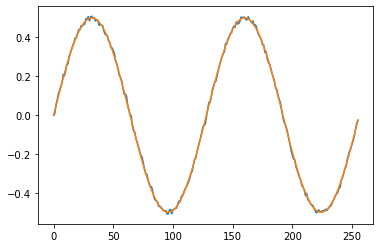

MSE Error = 6.53109229260403e-05
SNR = 1913.921812765578
SNR(db) = 32.81924192072985


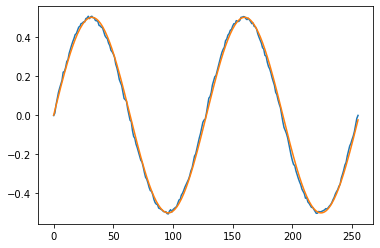

MSE Error = 0.0003140136753979016
SNR = 398.0718350613443
SNR(db) = 25.999614508567564


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_1_1_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_1_1_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_1_1_test)), gaussian_noisy_sine_1_1_test)
plt.plot(range(len(gaussian_noisy_sine_1_1_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_1_1_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_1_1_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_1_1_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_1_1_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Mean between -0.05 to 0.05 and Variance between 0 to 0.05 - LSTM

In [ ]:
gaussian_noisy_sine_5_5 = sine + np.random.normal(0.05*(2*np.random.rand(len(sine))-1), 0.05*np.random.rand(len(sine)), size=len(sine))
gaussian_noisy_sine_5_5_train = gaussian_noisy_sine_5_5[0:int(7/10*len(sine))]
gaussian_noisy_sine_5_5_validation = gaussian_noisy_sine_5_5[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_5_5_test = gaussian_noisy_sine_5_5[int(8/10*len(sine)):len(sine)]
gaussian_sine_5_5_train_dataset, gaussian_noisy_sine_5_5_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_5_5_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_5_5_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_5_5_lstm_model = sine_gaussian_5_5_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_5_5_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_5_5_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_5_5_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_5_5_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0009771224576979876
200 0.0008535592933185399
300 0.000793927873019129
400 0.0007551510352641344
500 0.00100636703427881
600 0.0007758116698823869
700 0.000527229392901063
800 0.00047995976638048887
900 0.00045579407014884055
1000 0.0004913810407742858
1100 0.00040842421003617346
1200 0.0003735309874173254
1300 0.0003412062069401145
1400 0.00033928523771464825
1500 0.0003099412424489856
1600 0.00026685805642046034
1700 0.00022698711836710572
1800 0.0002093603543471545
1900 0.0002484881260897964
2000 0.00018107668438460678
2100 0.00016828783554956317
2200 0.00019466043158899993
2300 0.00016063175280578434
2400 0.00015339936362579465
2500 0.0001506576081737876
2600 0.00014741049380972981
2700 0.00014537974493578076
2800 0.00014336802996695042
2900 0.00014414486940950155
3000 0.00014032360923010856
3100 0.000139067939016968
3200 0.00013796488929074258
3300 0.00013699056580662727
3400 0.00013612594921141863
3500 0.00013535538164433092
3600 0.00013466576638165861
3700 0.00013404614583

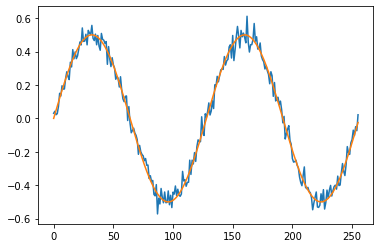

MSE Error = 0.0016038770282399014
SNR = 77.93614959195176
SNR(db) = 18.91738945820602


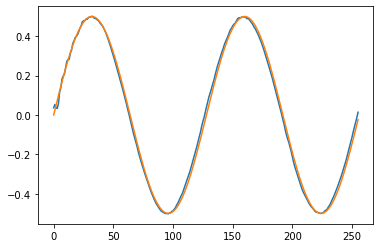

MSE Error = 0.0003908543560850667
SNR = 319.81222174940945
SNR(db) = 25.04895056461203


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_5_5_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_5_5_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_5_5_test)), gaussian_noisy_sine_5_5_test)
plt.plot(range(len(gaussian_noisy_sine_5_5_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_5_5_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_5_5_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_5_5_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_5_5_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Mean between -0.1 to 0.1 and Variance between 0 to 0.1 - LSTM

In [ ]:
gaussian_noisy_sine_10_10 = sine + np.random.normal(0.1*(2*np.random.rand(len(sine))-1), 0.1*np.random.rand(len(sine)), size=len(sine))
gaussian_noisy_sine_10_10_train = gaussian_noisy_sine_10_10[0:int(7/10*len(sine))]
gaussian_noisy_sine_10_10_validation = gaussian_noisy_sine_10_10[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_10_10_test = gaussian_noisy_sine_10_10[int(8/10*len(sine)):len(sine)]
gaussian_sine_10_10_train_dataset, gaussian_noisy_sine_10_10_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_10_10_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_10_10_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_10_10_lstm_model = sine_gaussian_10_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_10_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_10_10_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_10_10_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_10_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0025405199266970158
200 0.0019978589843958616
300 0.00187863246537745
400 0.001658985624089837
500 0.001787140965461731
600 0.006429457105696201
700 0.0010272194631397724
800 0.0008642222383059561
900 0.0007948341080918908
1000 0.0006954816053621471
1100 0.0006179526099003851
1200 0.0006734768976457417
1300 0.0005042374832555652
1400 0.0004661028797272593
1500 0.0004409215471241623
1600 0.00042909453622996807
1700 0.0004077130288351327
1800 0.0003970737452618778
1900 0.0004195326182525605
2000 0.00038024186505936086
2100 0.0003743648121599108
2200 0.0003685182018671185
2300 0.0003640707000158727
2400 0.00036024139262735844
2500 0.0003571051056496799
2600 0.00035435863537713885
2700 0.00035199601552449167
2800 0.0003499580197967589
2900 0.000348117871908471
3000 0.00034645540290512145
3100 0.000344937841873616
3200 0.00034354222589172423
3300 0.0003422517329454422
3400 0.0003410534409340471
3500 0.000339937541866675
3600 0.00033889617770910263
3700 0.00033792262547649443
3800 0.00

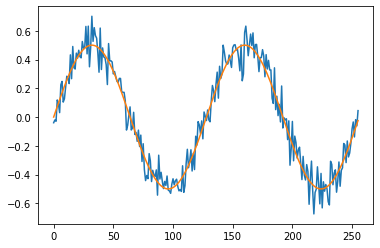

MSE Error = 0.006814683771263148
SNR = 18.34274402094969
SNR(db) = 12.634643053805577


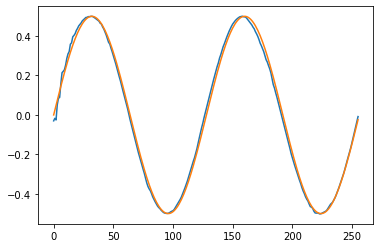

MSE Error = 0.00044750239377914494
SNR = 279.32811474901524
SNR(db) = 24.461146502225095


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_10_10_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_10_10_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_10_10_test)), gaussian_noisy_sine_10_10_test)
plt.plot(range(len(gaussian_noisy_sine_10_10_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_10_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_10_10_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_10_10_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_10_10_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Mean between -0.25 to 0.25 and Variance between 0 to 0.25 - LSTM

In [ ]:
gaussian_noisy_sine_25_25 = sine + np.random.normal(0.25*(2*np.random.rand(len(sine))-1), 0.25*np.random.rand(len(sine)), size=len(sine))
gaussian_noisy_sine_25_25_train = gaussian_noisy_sine_25_25[0:int(7/10*len(sine))]
gaussian_noisy_sine_25_25_validation = gaussian_noisy_sine_25_25[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_25_25_test = gaussian_noisy_sine_25_25[int(8/10*len(sine)):len(sine)]
gaussian_sine_25_25_train_dataset, gaussian_noisy_sine_25_25_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_25_25_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_25_25_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_25_25_lstm_model = sine_gaussian_25_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_25_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_25_25_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_25_25_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_25_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.008001509122550488
200 0.004866058938205242
300 0.0037900530733168125
400 0.0027208805549889803
500 0.002253171755000949
600 0.002105536637827754
700 0.002065956359729171
800 0.0032076172064989805
900 0.0022646395955234766
1000 0.0020486742723733187
1100 0.0019362556049600244
1200 0.001852896879427135
1300 0.0017754981527104974
1400 0.0017117405077442527
1500 0.001656761160120368
1600 0.0016073673032224178
1700 0.0015544036868959665
1800 0.0015183932846412063
1900 0.0014946081209927797
2000 0.0014769809786230326
2100 0.0014674568083137274
2200 0.0014438333455473185
2300 0.0014311261475086212
2400 0.0014203254831954837
2500 0.0014086629962548614
2600 0.0013993815518915653
2700 0.001390906167216599
2800 0.0013830632669851184
2900 0.0013757183915004134
3000 0.0013687815517187119
3100 0.0013621905818581581
3200 0.0013558999635279179
3300 0.0013498729094862938
3400 0.0013440772891044617
3500 0.0013384855119511485
3600 0.0013330766232684255
3700 0.0013278386322781444
3800 0.00132276781

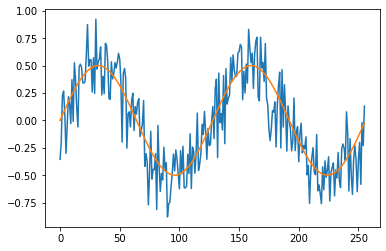

MSE Error = 0.04387831147925622
SNR = 2.8487878358558674
SNR(db) = 4.546601062601481


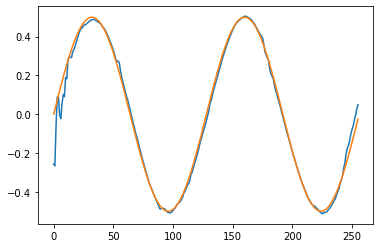

MSE Error = 0.001383389082758675
SNR = 90.35780429229078
SNR(db) = 19.559656689578425


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_25_25_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_25_25_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_25_25_test)), gaussian_noisy_sine_25_25_test)
plt.plot(range(len(gaussian_noisy_sine_25_25_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_25_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_25_25_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_10_10_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_10_10_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Sine - Gaussain Noise with Mean between -0.5 to 0.5 and Variance between 0 to 0.5 - LSTM

In [ ]:
gaussian_noisy_sine_50_50 = sine + np.random.normal(0.5*(2*np.random.rand(len(sine))-1), 0.5*np.random.rand(len(sine)), size=len(sine))
gaussian_noisy_sine_50_50_train = gaussian_noisy_sine_50_50[0:int(7/10*len(sine))]
gaussian_noisy_sine_50_50_validation = gaussian_noisy_sine_50_50[int(7/10*len(sine)):int(8/10*len(sine))]
gaussian_noisy_sine_50_50_test = gaussian_noisy_sine_50_50[int(8/10*len(sine)):len(sine)]
gaussian_sine_50_50_train_dataset, gaussian_noisy_sine_50_50_train_dataset = create_dataset(sine_train, gaussian_noisy_sine_50_50_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
sine_gaussian_50_50_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
sine_gaussian_50_50_lstm_model = sine_gaussian_50_50_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(sine_gaussian_50_50_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_sine_50_50_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_sine_50_50_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = sine_gaussian_50_50_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.013335793279111385
200 0.008442036807537079
300 0.0070505947805941105
400 0.005497574340552092
500 0.004949534311890602
600 0.004974054638296366
700 0.004352239426225424
800 0.00421310355886817
900 0.0041004354134202
1000 0.003937263507395983
1100 0.003769285511225462
1200 0.0036325277760624886
1300 0.003526311367750168
1400 0.0034356925170868635
1500 0.003361941548064351
1600 0.0033304542303085327
1700 0.00326047046110034
1800 0.00322510558180511
1900 0.0031861932948231697
2000 0.003154590493068099
2100 0.00312606617808342
2200 0.0030997698195278645
2300 0.0030752525199204683
2400 0.0030520621221512556
2500 0.003029870567843318
2600 0.003008522093296051
2700 0.0029879920184612274
2800 0.00296825566329062
2900 0.002949312562122941
3000 0.002931474708020687
3100 0.0029147916939109564
3200 0.0028992192819714546
3300 0.002884673187509179
3400 0.002871040953323245
3500 0.002858205698430538
3600 0.002846064046025276
3700 0.002834532642737031
3800 0.0028235469944775105
3900 0.002813061

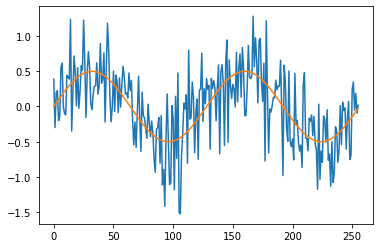

MSE Error = 0.17056446241751072
SNR = 0.7328607508756588
SNR(db) = -1.3497853677949234


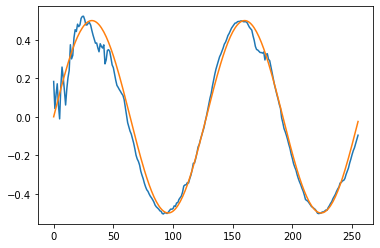

MSE Error = 0.002426135074692229
SNR = 51.52227561602565
SNR(db) = 17.11995036526783


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_sine_50_50_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(sine_gaussian_50_50_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), gaussian_noisy_sine_50_50_test)
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - gaussian_noisy_sine_50_50_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - gaussian_noisy_sine_50_50_test, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), pred)
plt.plot(range(len(gaussian_noisy_sine_50_50_test)), sine_test)
plt.show()
MSE_erreor = np.mean(np.power(sine_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(sine_test - pred, 2))
signal_power = np.mean(np.power(sine_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

Explanation

Yes, the performance of the model is still good. It can still extract the desired signal.

# F)

## F) A)

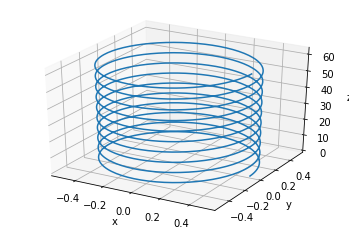

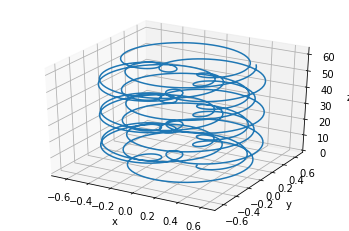

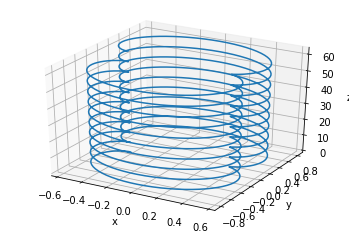

In [ ]:
fs = 128
t = np.linspace(0, 20*np.pi*(1-1/(10*fs)), 10*fs)
circle = 0.5*np.vstack((np.cos(t), np.sin(t)))
ax = plt.axes(projection='3d')
ax.plot3D(circle[0], circle[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
a = 5
b = 3
c = 5
epitrochoid = 0.05*np.vstack(((a+b)*np.cos(t)-c*np.cos((a/b+1)*t), (a+b)*np.sin(t)-c*np.sin((a/b+1)*t)))
ax = plt.axes(projection='3d')
ax.plot3D(epitrochoid[0], epitrochoid[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
a = 2
nephroid = 0.1*np.vstack((a*(np.cos(3*t)-3*np.cos(t)), a*(np.sin(3*t)-3*np.sin(t))))
ax = plt.axes(projection='3d')
ax.plot3D(nephroid[0], nephroid[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()

In [ ]:
circle_train = circle[:, 0:int(7/10*len(t))]
circle_validation = circle[:, int(7/10*len(t)):int(8/10*len(t))]
circle_test = circle[:, int(8/10*len(t)):len(t)]
epitrochoid_train = epitrochoid[:, 0:int(7/10*len(t))]
epitrochoid_validation = epitrochoid[:, int(7/10*len(t)):int(8/10*len(t))]
epitrochoid_test = epitrochoid[:, int(8/10*len(t)):len(t)]
nephroid_train = nephroid[:, 0:int(7/10*len(t))]
nephroid_validation = nephroid[:, int(7/10*len(t)):int(8/10*len(t))]
nephroid_test = nephroid[:, int(8/10*len(t)):len(t)]

Since 'Circle' is a periodic parametric curve, it is possible to take one of its periods and repeat that period for making other periods.

## F) B)

Gaussian Noise

In [ ]:
gaussian_noisy_circle = circle + np.random.normal(0, 0.05, size=circle.shape)
gaussian_noisy_epitrochoid = epitrochoid + np.random.normal(0, 0.05, size=epitrochoid.shape)
gaussian_noisy_nephroid = nephroid + np.random.normal(0, 0.05, size=nephroid.shape)

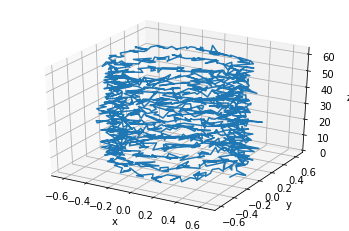

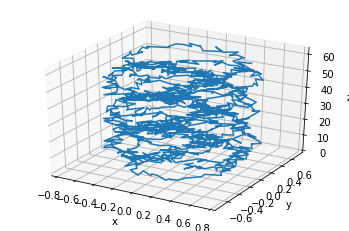

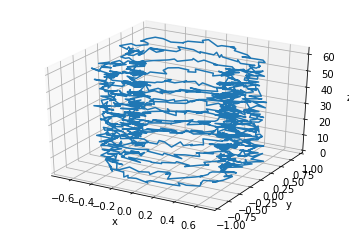

In [ ]:
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle[0], gaussian_noisy_circle[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_epitrochoid[0], gaussian_noisy_epitrochoid[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_nephroid[0], gaussian_noisy_nephroid[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()

In [ ]:
gaussian_noisy_circle_train = gaussian_noisy_circle[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_validation = gaussian_noisy_circle[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_test = gaussian_noisy_circle[:, int(8/10*len(t)):len(t)]
gaussian_noisy_epitrochoid_train = gaussian_noisy_epitrochoid[:, 0:int(7/10*len(t))]
gaussian_noisy_epitrochoid_validation = gaussian_noisy_epitrochoid[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_epitrochoid_test = gaussian_noisy_epitrochoid[:, int(8/10*len(t)):len(t)]
gaussian_noisy_nephroid_train = gaussian_noisy_nephroid[:, 0:int(7/10*len(t))]
gaussian_noisy_nephroid_validation = gaussian_noisy_nephroid[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_nephroid_test = gaussian_noisy_nephroid[:, int(8/10*len(t)):len(t)]

Uniform Noise

In [ ]:
uniform_noisy_circle = circle + 0.1*(2*np.random.rand(circle.shape[0], circle.shape[1])-1)
uniform_noisy_epitrochoid = epitrochoid + 0.1*(2*np.random.rand(epitrochoid.shape[0], epitrochoid.shape[1])-1)
uniform_noisy_nephroid = nephroid + 0.1*(2*np.random.rand(nephroid.shape[0], nephroid.shape[1])-1)

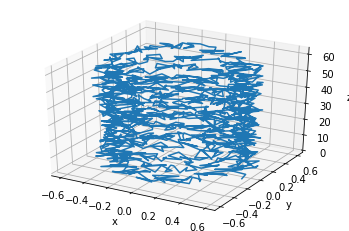

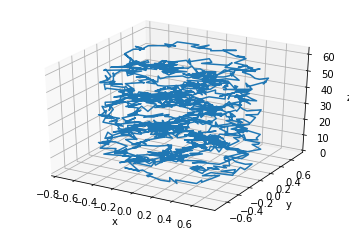

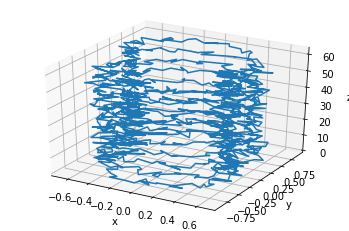

In [ ]:
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_circle[0], uniform_noisy_circle[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_epitrochoid[0], uniform_noisy_epitrochoid[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_nephroid[0], uniform_noisy_nephroid[1], t)
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()

In [ ]:
uniform_noisy_circle_train = uniform_noisy_circle[:, 0:int(7/10*len(t))]
uniform_noisy_circle_validation = uniform_noisy_circle[:, int(7/10*len(t)):int(8/10*len(t))]
uniform_noisy_circle_test = uniform_noisy_circle[:, int(8/10*len(t)):len(t)]
uniform_noisy_epitrochoid_train = uniform_noisy_epitrochoid[:, 0:int(7/10*len(t))]
uniform_noisy_epitrochoid_validation = uniform_noisy_epitrochoid[:, int(7/10*len(t)):int(8/10*len(t))]
uniform_noisy_epitrochoid_test = uniform_noisy_epitrochoid[:, int(8/10*len(t)):len(t)]
uniform_noisy_nephroid_train = uniform_noisy_nephroid[:, 0:int(7/10*len(t))]
uniform_noisy_nephroid_validation = uniform_noisy_nephroid[:, int(7/10*len(t)):int(8/10*len(t))]
uniform_noisy_nephroid_test = uniform_noisy_nephroid[:, int(8/10*len(t)):len(t)]

## F) C)

In [ ]:
def create_dataset(x, noisy_x, n_samples, sample_size):
  data_in = np.zeros((n_samples, sample_size, 2))
  data_out = np.zeros((n_samples, sample_size, 2))
  for i in range(n_samples):
    random_offset = np.random.randint(0, x.shape[1]-sample_size-1)
    data_in[i, :, :] = noisy_x[:, random_offset:random_offset+sample_size].T
    data_out[i, :, :] = x[:, random_offset+1:random_offset+sample_size+1].T
  return data_in, data_out

In [ ]:
n_samples = 500
sample_size = int(1.25*fs)
gaussian_circle_train_dataset, gaussian_noisy_circle_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_train, n_samples, sample_size)
gaussian_epitrochoid_train_dataset, gaussian_noisy_epitrochoid_train_dataset = create_dataset(epitrochoid_train, gaussian_noisy_epitrochoid_train, n_samples, sample_size)
gaussian_nephroid_train_dataset, gaussian_noisy_nephroid_train_dataset = create_dataset(nephroid_train, gaussian_noisy_nephroid_train, n_samples, sample_size)
uniform_circle_train_dataset, uniform_noisy_circle_train_dataset = create_dataset(circle_train, uniform_noisy_circle_train, n_samples, sample_size)
uniform_epitrochoid_train_dataset, uniform_noisy_epitrochoid_train_dataset = create_dataset(epitrochoid_train, uniform_noisy_epitrochoid_train, n_samples, sample_size)
uniform_nephroid_train_dataset, uniform_noisy_nephroid_train_dataset = create_dataset(nephroid_train, uniform_noisy_nephroid_train, n_samples, sample_size)

In [ ]:
class Custom2DRNN(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(Custom2DRNN, self).__init__()
        self.rnn = torch.nn.RNN(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.rnn(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 2)
        return pred
class Custom2DLSTM(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(Custom2DLSTM, self).__init__()
        self.lstm = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.lstm(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 2)
        return pred

### Circle - Gaussain Noise - RNN

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_rnn_model = Custom2DRNN(input_size, hidden_size, output_size)
circle_gaussian_rnn_model = circle_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0009875115938484669
200 0.000910651171579957
300 0.0008714639698155224
400 0.0008243746706284583
500 0.0010447228560224175
600 0.0008265255019068718
700 0.0007760043954476714
800 0.0006480083102360368
900 0.0008205974590964615
1000 0.0005556702380999923
1100 0.000404951220843941
1200 0.0002863870467990637
1300 0.00023321484331972897
1400 0.0002035994693869725
1500 0.00018698751227930188
1600 0.00016975324251689017
1700 0.00015715215704403818
1800 0.00014691174146719277
1900 0.0001382068294333294
2000 0.00013065870734862983
2100 0.00012405382585711777
2200 0.00011824972170870751
2300 0.00011314425501041114
2400 0.00010866358206840232
2500 0.00010475060844328254
2600 0.00010135385673493147
2700 9.842068539001048e-05
2800 9.589603723725304e-05
2900 9.372428030474111e-05
3000 9.185244562104344e-05
3100 9.023280290421098e-05
3200 8.882397378329188e-05
3300 8.759123738855124e-05
3400 8.650607196614146e-05
3500 8.554518717573956e-05
3600 8.468970190733671e-05
3700 8.392423478653654e-05


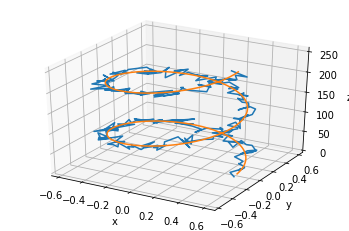

MSE Error = 0.0025075435233205506
SNR = 49.8495834020348
SNR(db) = 16.97661533220323


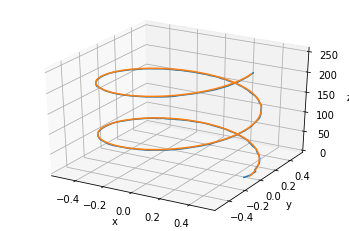

MSE Error = 0.00042533545326843705
SNR = 293.8856825582094
SNR(db) = 24.68178428748947


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_rnn_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_test[0], gaussian_noisy_circle_test[1], range(gaussian_noisy_circle_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussain Noise - LSTM

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_lstm_model = circle_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0009732397738844156
200 0.0009321255492977798
300 0.000888558744918555
400 0.000769633159507066
500 0.000742121774237603
600 0.0004795585118699819
700 0.000344921019859612
800 0.00021406046289484948
900 0.00017068773740902543
1000 0.00014394083700608462
1100 0.00012388775940053165
1200 0.00011234411067562178
1300 0.00010139904043171555
1400 9.35095886234194e-05
1500 8.81325759110041e-05
1600 8.352615259354934e-05
1700 8.006362622836605e-05
1800 7.732681842753664e-05
1900 7.529310823883861e-05
2000 7.339502190006897e-05
2100 7.18929004506208e-05
2200 7.062324584694579e-05
2300 6.954158016014844e-05
2400 6.861452857265249e-05
2500 6.781587580917403e-05
2600 6.712431058986112e-05
2700 6.652218871749938e-05
2800 6.599483458558097e-05
2900 6.553010462084785e-05
3000 6.51180453132838e-05
3100 6.475050759036094e-05
3200 6.442082667490467e-05
3300 6.412359653040767e-05
3400 6.38543424429372e-05
3500 6.360938277794048e-05
3600 6.338569801300764e-05
3700 6.318071245914325e-05
3800 6.299225

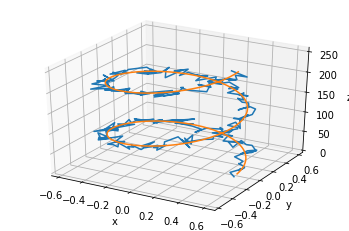

MSE Error = 0.0025075435233205506
SNR = 49.8495834020348
SNR(db) = 16.97661533220323


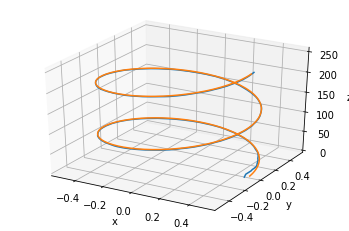

MSE Error = 0.00042485889546822807
SNR = 294.215329685495
SNR(db) = 24.686652972982902


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_test[0], gaussian_noisy_circle_test[1], range(gaussian_noisy_circle_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Epitrochoid - Gaussain Noise - RNN

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
epitrochoid_gaussian_rnn_model = Custom2DRNN(input_size, hidden_size, output_size)
epitrochoid_gaussian_rnn_model = epitrochoid_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(epitrochoid_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_epitrochoid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_epitrochoid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = epitrochoid_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.001741468789987266
200 0.0016606213757768273
300 0.0016272257780656219
400 0.001587807317264378
500 0.0014730342663824558
600 0.0019856097642332315
700 0.0013439940521493554
800 0.0014535245718434453
900 0.0012886583572253585
1000 0.0011367881670594215
1100 0.0010773401008918881
1200 0.0010358579456806183
1300 0.0009912037057802081
1400 0.0009372389758937061
1500 0.0009074084809981287
1600 0.0008551683276891708
1700 0.0007535741897299886
1800 0.0006844867602922022
1900 0.0006403079023584723
2000 0.0005773564334958792
2100 0.0005549069028347731
2200 0.0005129853379912674
2300 0.0004919454222545028
2400 0.00047592801274731755
2500 0.0004579020896926522
2600 0.0004433004360180348
2700 0.0004300612199585885
2800 0.00041815085569396615
2900 0.0004074825264979154
3000 0.00039791467133909464
3100 0.0003892910899594426
3200 0.00038147211307659745
3300 0.00037434539990499616
3400 0.0003678242792375386
3500 0.0003618414921220392
3600 0.0003563427890185267
3700 0.0003512826806399971
3800 0.

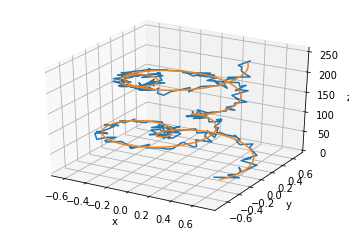

MSE Error = 0.0025573363355245434
SNR = 46.73429870218631
SNR(db) = 16.69635730024436


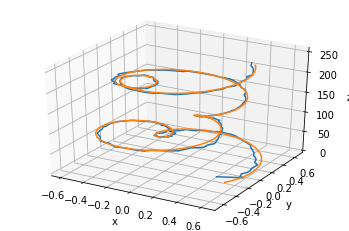

MSE Error = 0.0009618082573448667
SNR = 124.26106687448103
SNR(db) = 20.943350780370423


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_epitrochoid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(epitrochoid_gaussian_rnn_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_epitrochoid_test[0], gaussian_noisy_epitrochoid_test[1], range(gaussian_noisy_epitrochoid_test.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - gaussian_noisy_epitrochoid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - gaussian_noisy_epitrochoid_test, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - pred, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Epitrochoid - Gaussain Noise - LSTM

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
epitrochoid_gaussian_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
epitrochoid_gaussian_lstm_model = epitrochoid_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(epitrochoid_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_epitrochoid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_epitrochoid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = epitrochoid_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0015981075121089816
200 0.001519494690001011
300 0.0013625738210976124
400 0.0012424758169800043
500 0.001216842676512897
600 0.0009336872608400881
700 0.0007698331610299647
800 0.0006217093323357403
900 0.0005418161163106561
1000 0.00045867537846788764
1100 0.00041548899025656283
1200 0.0005811747978441417
1300 0.0003491784445941448
1400 0.0003280783712398261
1500 0.00030768269789405167
1600 0.0002915218356065452
1700 0.0002802048984449357
1800 0.0002654853160493076
1900 0.0002538562403060496
2000 0.00024489822681061924
2100 0.00023489221348427236
2200 0.00023207721824292094
2300 0.0002199829468736425
2400 0.00021363365522120148
2500 0.00020799358026124537
2600 0.00020271335961297154
2700 0.000197950575966388
2800 0.00019626425637397915
2900 0.00018982055189553648
3000 0.00018639375048223883
3100 0.00018332853505853564
3200 0.0001805863284971565
3300 0.00017812816076911986
3400 0.00017591733194421977
3500 0.00017392091103829443
3600 0.00017211030353792012
3700 0.0001704609021544

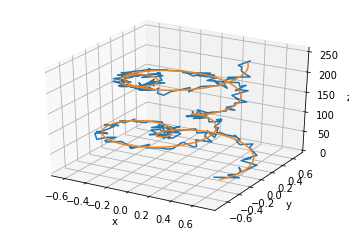

MSE Error = 0.0025573363355245434
SNR = 46.73429870218631
SNR(db) = 16.69635730024436


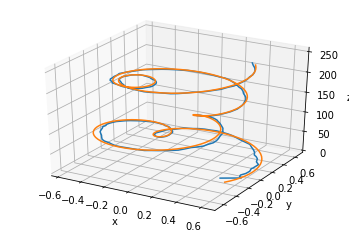

MSE Error = 0.000864744526034655
SNR = 138.20881958559968
SNR(db) = 21.405357577642555


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_epitrochoid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(epitrochoid_gaussian_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_epitrochoid_test[0], gaussian_noisy_epitrochoid_test[1], range(gaussian_noisy_epitrochoid_test.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - gaussian_noisy_epitrochoid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - gaussian_noisy_epitrochoid_test, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - pred, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Nephroid - Gaussain Noise - RNN

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
nephroid_gaussian_rnn_model = Custom2DRNN(input_size, hidden_size, output_size)
nephroid_gaussian_rnn_model = nephroid_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(nephroid_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_nephroid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_nephroid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = nephroid_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0020069435704499483
200 0.0016716044628992677
300 0.0020404160022735596
400 0.0016241633566096425
500 0.0012403351720422506
600 0.0011399606009945273
700 0.0011193359969183803
800 0.0010610806057229638
900 0.0009875892428681254
1000 0.0012388090835884213
1100 0.0009160047047771513
1200 0.0007964646210893989
1300 0.0006519325543195009
1400 0.0006735739880241454
1500 0.0005423040711320937
1600 0.0004336872370913625
1700 0.0007587496656924486
1800 0.0003485458146315068
1900 0.0003149397671222687
2000 0.00029247216298244894
2100 0.00027496868278831244
2200 0.0002606500347610563
2300 0.0002487573365215212
2400 0.00023880410299170762
2500 0.00023041936219669878
2600 0.00022330880165100098
2700 0.00021723765530623496
2800 0.0002120187709806487
2900 0.0002075025549856946
3000 0.00020356914319563657
3100 0.00020012193999718875
3200 0.00019708264153450727
3300 0.00019438743765931576
3400 0.00019198452355340123
3500 0.00018983130576089025
3600 0.00018789287423714995
3700 0.00018614035798236

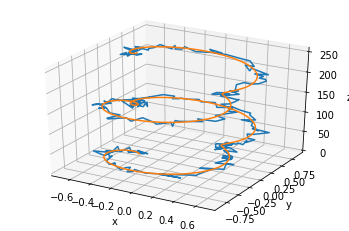

MSE Error = 0.0026683856644057037
SNR = 74.95168433403481
SNR(db) = 18.747813968741944


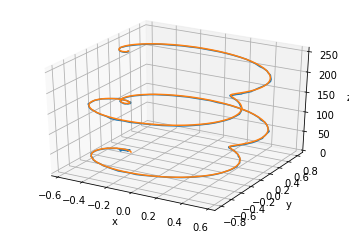

MSE Error = 0.0009628449231773228
SNR = 207.71776969027746
SNR(db) = 23.17473650836144


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_nephroid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(nephroid_gaussian_rnn_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_nephroid_test[0], gaussian_noisy_nephroid_test[1], range(gaussian_noisy_nephroid_test.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - gaussian_noisy_nephroid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - gaussian_noisy_nephroid_test, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - pred, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Nephroid - Gaussain Noise - LSTM

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
nephroid_gaussian_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
nephroid_gaussian_lstm_model = nephroid_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(nephroid_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_nephroid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_nephroid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = nephroid_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0017931662732735276
200 0.0011807450791820884
300 0.0010395071003586054
400 0.0010441977065056562
500 0.0008398870122618973
600 0.0006534410058520734
700 0.0005290767876431346
800 0.00042227853555232286
900 0.00039171986281871796
1000 0.00028867844957858324
1100 0.00026350331609137356
1200 0.00024075376859400421
1300 0.00022854165581520647
1400 0.00020931191102135926
1500 0.00020507583394646645
1600 0.00018919560534413904
1700 0.00018116555293090641
1800 0.00018779680249281228
1900 0.00016830758249852806
2000 0.00016266622697003186
2100 0.00015760735550429672
2200 0.0001530828303657472
2300 0.0001490049617132172
2400 0.0001452775177313015
2500 0.00014192156959325075
2600 0.00013879749167244881
2700 0.00013589121226686984
2800 0.00013321920414455235
2900 0.0001308057107962668
3000 0.00012870212958659977
3100 0.00012677554332185537
3200 0.0001250891509698704
3300 0.00012356248043943197
3400 0.00012217192852403969
3500 0.00012089923257008195
3600 0.0001197298988699913
3700 0.0001186

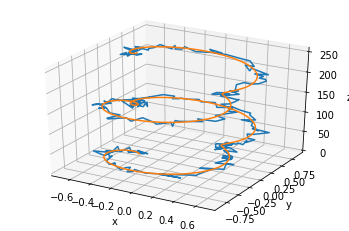

MSE Error = 0.0026683856644057037
SNR = 74.95168433403481
SNR(db) = 18.747813968741944


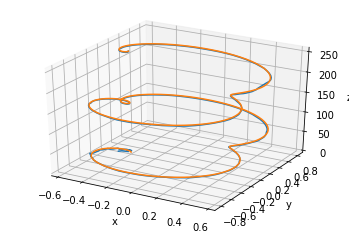

MSE Error = 0.0011950262591248597
SNR = 167.3603391330194
SNR(db) = 22.236525472269133


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_nephroid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(nephroid_gaussian_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_nephroid_test[0], gaussian_noisy_nephroid_test[1], range(gaussian_noisy_nephroid_test.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - gaussian_noisy_nephroid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - gaussian_noisy_nephroid_test, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - pred, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Uniform Noise - RNN

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_uniform_rnn_model = Custom2DRNN(input_size, hidden_size, output_size)
circle_uniform_rnn_model = circle_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_circle_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_circle_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.001201470149680972
200 0.0010556356282904744
300 0.0009470803779549897
400 0.0008808391285128891
500 0.0007104334654286504
600 0.0007859210018068552
700 0.000547882285900414
800 0.0003432461526244879
900 0.00040301840635947883
1000 0.000254570011748001
1100 0.00022437826555687934
1200 0.00020503648556768894
1300 0.00019042109488509595
1400 0.00017847318667918444
1500 0.00016828849038574845
1600 0.0001593627966940403
1700 0.0001513687166152522
1800 0.0001441121712559834
1900 0.00013752961240243167
2000 0.0001316552225034684
2100 0.0001265376340597868
2200 0.00012216527829878032
2300 0.00011845878179883584
2400 0.0001153096673078835
2500 0.00011261417239438742
2600 0.00011028663720935583
2700 0.00010825983190443367
2800 0.00010648150055203587
2900 0.00010491077409824356
3000 0.00010351517266826704
3100 0.000102268582850229
3200 0.00010114983160747215
3300 0.00010014150029746816
3400 9.922915342031047e-05
3500 9.840077836997807e-05
3600 9.764624701347202e-05
3700 9.695696644484997e-

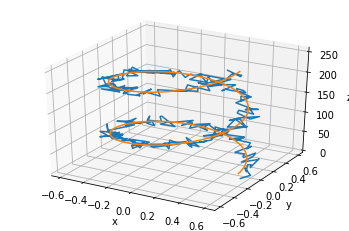

MSE Error = 0.0033999689719261014
SNR = 36.765041396594505
SNR(db) = 15.654350593136735


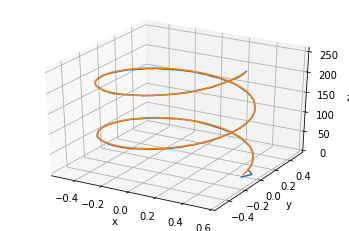

MSE Error = 0.0004061833386362515
SNR = 307.74280505863135
SNR(db) = 24.881879080375978


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_circle_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_uniform_rnn_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_circle_test[0], uniform_noisy_circle_test[1], range(uniform_noisy_circle_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - uniform_noisy_circle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - uniform_noisy_circle_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Uniform Noise - LSTM

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_uniform_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_uniform_lstm_model = circle_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_circle_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_circle_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.001118584186770022
200 0.0010762257734313607
300 0.001036078087054193
400 0.000975308008491993
500 0.0007656475645489991
600 0.0007537357159890234
700 0.0004697936528827995
800 0.00029626276227645576
900 0.00021169883257243782
1000 0.00047865259693935513
1100 0.00014891642786096781
1200 0.0001336036075372249
1300 0.00012079229054506868
1400 0.00011178069689776748
1500 0.0001037755428114906
1600 0.00010389597446192056
1700 9.366545418743044e-05
1800 9.035286348080263e-05
1900 8.780961070442572e-05
2000 8.580348367104307e-05
2100 8.417884237132967e-05
2200 8.283268834929913e-05
2300 8.169652573997155e-05
2400 8.072358468780294e-05
2500 7.988100696820766e-05
2600 7.914477464510128e-05
2700 7.849685789551586e-05
2800 7.79232505010441e-05
2900 7.741279114270583e-05
3000 7.695646490901709e-05
3100 7.654686487512663e-05
3200 7.617784285685048e-05
3300 7.584418926853687e-05
3400 7.554160401923582e-05
3500 7.526636181864887e-05
3600 7.501526124542579e-05
3700 7.478562474716455e-05
3800 7.

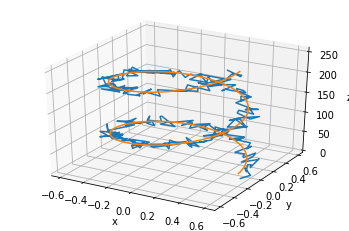

MSE Error = 0.0033999689719261014
SNR = 36.765041396594505
SNR(db) = 15.654350593136735


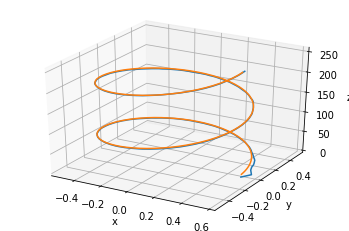

MSE Error = 0.0003501040452120904
SNR = 357.0367201106629
SNR(db) = 25.527128842391974


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_circle_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_uniform_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_circle_test[0], uniform_noisy_circle_test[1], range(uniform_noisy_circle_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - uniform_noisy_circle_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - uniform_noisy_circle_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Epitrochoid - Uniform Noise - RNN

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
epitrochoid_uniform_rnn_model = Custom2DRNN(input_size, hidden_size, output_size)
epitrochoid_uniform_rnn_model = epitrochoid_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(epitrochoid_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_epitrochoid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_epitrochoid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = epitrochoid_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0019355637487024069
200 0.0018271388253197074
300 0.0016943725058808923
400 0.00246630422770977
500 0.0018929691286757588
600 0.0018243821104988456
700 0.0016788588836789131
800 0.0015307829016819596
900 0.00142349349334836
1000 0.0012458417331799865
1100 0.001215962111018598
1200 0.0011911700712516904
1300 0.0011639680014923215
1400 0.0011916074436157942
1500 0.0010921345092356205
1600 0.0010611615143716335
1700 0.000983838690444827
1800 0.0009261940722353756
1900 0.0008816210320219398
2000 0.0008409214788116515
2100 0.0007748150383122265
2200 0.0007364388438872993
2300 0.0006874784012325108
2400 0.0006548170931637287
2500 0.0006276482599787414
2600 0.000606364686973393
2700 0.0005853518377989531
2800 0.0005673080449923873
2900 0.0005506371380761266
3000 0.0005351987783797085
3100 0.0005209571681916714
3200 0.0005078898975625634
3300 0.0004959506914019585
3400 0.000485068594571203
3500 0.00047515882761217654
3600 0.00046613047015853226
3700 0.00045789231080561876
3800 0.00045035

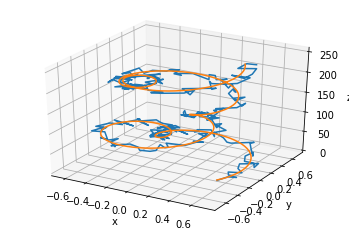

MSE Error = 0.0030815131915728745
SNR = 38.78462065753975
SNR(db) = 15.886595480776666


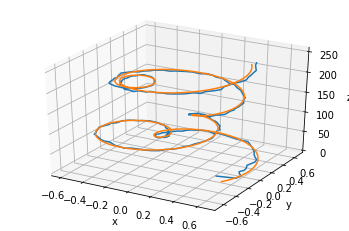

MSE Error = 0.0012083703747208141
SNR = 98.90619853533877
SNR(db) = 19.952235100535706


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_epitrochoid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(epitrochoid_uniform_rnn_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_epitrochoid_test[0], uniform_noisy_epitrochoid_test[1], range(uniform_noisy_epitrochoid_test.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - uniform_noisy_epitrochoid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - uniform_noisy_epitrochoid_test, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - pred, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Epitrochoid - Uniform Noise - LSTM

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
epitrochoid_uniform_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
epitrochoid_uniform_lstm_model = epitrochoid_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(epitrochoid_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_epitrochoid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_epitrochoid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = epitrochoid_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0018980286549776793
200 0.0018151592230424285
300 0.0016972986049950123
400 0.0014269164530560374
500 0.0015564984641969204
600 0.0009362366399727762
700 0.0008438946679234505
800 0.0007218853570520878
900 0.0006351573974825442
1000 0.000569500494748354
1100 0.0005706913070753217
1200 0.0004874916048720479
1300 0.000459292292362079
1400 0.0004196545050945133
1500 0.00039140041917562485
1600 0.00038663914892822504
1700 0.00034211052116006613
1800 0.0003243689425289631
1900 0.00035834708251059055
2000 0.00029631174402311444
2100 0.00028523002401925623
2200 0.000275523605523631
2300 0.0002684255305211991
2400 0.00026175202219747007
2500 0.0002569989301264286
2600 0.00025198934599757195
2700 0.0002479994436725974
2800 0.00024441309506073594
2900 0.0002411509631201625
3000 0.00023816063185222447
3100 0.00023540591064374894
3200 0.0002328601258341223
3300 0.0002305021189386025
3400 0.00022831415117252618
3500 0.00022628063743468374
3600 0.00022438759333454072
3700 0.0002226225333288312

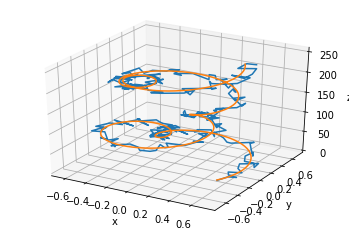

MSE Error = 0.0030815131915728745
SNR = 38.78462065753975
SNR(db) = 15.886595480776666


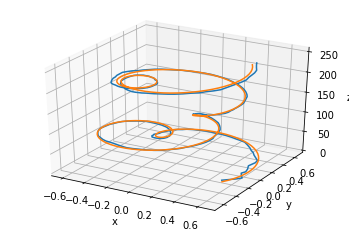

MSE Error = 0.0009250534349240211
SNR = 129.1982880925953
SNR(db) = 21.11256759194166


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_epitrochoid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(epitrochoid_uniform_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_epitrochoid_test[0], uniform_noisy_epitrochoid_test[1], range(uniform_noisy_epitrochoid_test.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - uniform_noisy_epitrochoid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - uniform_noisy_epitrochoid_test, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(epitrochoid_test[0], epitrochoid_test[1], range(epitrochoid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(epitrochoid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(epitrochoid_test - pred, 2))
signal_power = np.mean(np.power(epitrochoid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Nephroid - Uniform Noise - RNN

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
nephroid_uniform_rnn_model = Custom2DRNN(input_size, hidden_size, output_size)
nephroid_uniform_rnn_model = nephroid_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(nephroid_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_nephroid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_nephroid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = nephroid_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0021071075461804867
200 0.001366482931189239
300 0.0014016680652275681
400 0.0011891169706359506
500 0.0010024829534813762
600 0.0011868621222674847
700 0.0010248825419694185
800 0.0008670175448060036
900 0.0010416517034173012
1000 0.0008926811278797686
1100 0.0007963280659168959
1200 0.000693127338308841
1300 0.0005862784455530345
1400 0.0006031317752785981
1500 0.00045836271601729095
1600 0.00040715260547585785
1700 0.00036515179090201855
1800 0.00033783825347200036
1900 0.00031180784571915865
2000 0.0002917128149420023
2100 0.00027568708173930645
2200 0.00026265488122589886
2300 0.0002519038098398596
2400 0.0002429311425657943
2500 0.00023536272055935115
2600 0.0002289132244186476
2700 0.0002233629347756505
2800 0.00021854227816220373
2900 0.00021431937057059258
3000 0.0002105907624354586
3100 0.0002072747884085402
3200 0.00020430619770195335
3300 0.00020163255976513028
3400 0.00019921128114219755
3500 0.0001970076555153355
3600 0.00019499310292303562
3700 0.000193143932847306

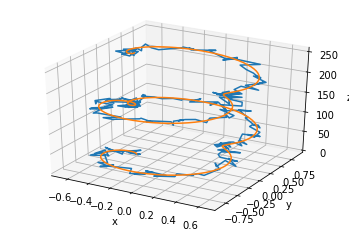

MSE Error = 0.003339664702761823
SNR = 59.88625140559913
SNR(db) = 17.773271291667854


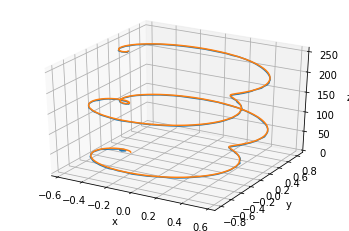

MSE Error = 0.0011903002174550687
SNR = 168.02483698407758
SNR(db) = 22.25373482725101


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_nephroid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(nephroid_uniform_rnn_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_nephroid_test[0], uniform_noisy_nephroid_test[1], range(uniform_noisy_nephroid_test.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - uniform_noisy_nephroid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - uniform_noisy_nephroid_test, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - pred, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Nephroid - Uniform Noise - LSTM

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
nephroid_uniform_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
nephroid_uniform_lstm_model = nephroid_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(nephroid_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_nephroid_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_nephroid_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = nephroid_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.001900640781968832
200 0.0013991228770464659
300 0.0012141350889578462
400 0.0010163484839722514
500 0.0008422471000812948
600 0.0009563740459270775
700 0.0005246545188128948
800 0.0004353037220425904
900 0.0004319929867051542
1000 0.00032137526432052255
1100 0.00029389155679382384
1200 0.0002750452549662441
1300 0.0002570805954746902
1400 0.00024379171372856945
1500 0.00023073820921126753
1600 0.00021945993648841977
1700 0.00020999474509153515
1800 0.0002011571341427043
1900 0.0001932926388690248
2000 0.00018635386368259788
2100 0.00018051423830911517
2200 0.0001753516698954627
2300 0.00017090929031837732
2400 0.00016707823670003563
2500 0.0001637576351640746
2600 0.00016085707466118038
2700 0.0001583011180628091
2800 0.00015602921484969556
2900 0.0001539937948109582
3000 0.00015215753228403628
3100 0.00015049093053676188
3200 0.0001489705464337021
3300 0.0001475773169659078
3400 0.00014629584620706737
3500 0.00014511325571220368
3600 0.00014401892258320004
3700 0.00014300382463

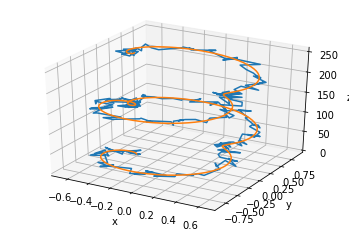

MSE Error = 0.003339664702761823
SNR = 59.88625140559913
SNR(db) = 17.773271291667854


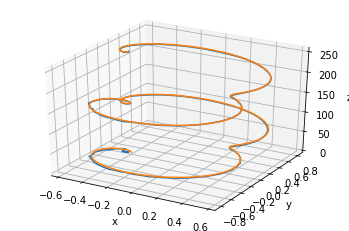

MSE Error = 0.0012387590411016096
SNR = 161.45189933156254
SNR(db) = 22.080431584542332


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_nephroid_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(nephroid_uniform_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(uniform_noisy_nephroid_test[0], uniform_noisy_nephroid_test[1], range(uniform_noisy_nephroid_test.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - uniform_noisy_nephroid_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - uniform_noisy_nephroid_test, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(nephroid_test[0], nephroid_test[1], range(nephroid_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(nephroid_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(nephroid_test - pred, 2))
signal_power = np.mean(np.power(nephroid_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## F) D)

### Circle - Gaussian Noise with Variance 0.01 - LSTM

In [ ]:
gaussian_noisy_circle_1 = circle + np.random.normal(0, 0.01, size=circle.shape)
gaussian_noisy_circle_1_train = gaussian_noisy_circle_1[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_1_validation = gaussian_noisy_circle_1[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_1_test = gaussian_noisy_circle_1[:, int(8/10*len(t)):len(t)]
gaussian_circle_1_train_dataset, gaussian_noisy_circle_1_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_1_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_1_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_1_lstm_model = circle_gaussian_1_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_1_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_1_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_1_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_1_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0002967256586998701
200 0.00021360105893108994
300 0.0001675717649050057
400 0.00014345899398904294
500 0.00012760823301505297
600 0.00011296835873508826
700 9.653400775277987e-05
800 8.050720498431474e-05
900 7.28215673007071e-05
1000 6.851276702946052e-05
1100 6.465522892540321e-05
1200 6.048683280823752e-05
1300 6.346835289150476e-05
1400 5.198870348976925e-05
1500 4.666904351324774e-05
1600 4.318711216910742e-05
1700 3.8482747186208144e-05
1800 3.417710104258731e-05
1900 3.1746894819661975e-05
2000 2.8762795409420505e-05
2100 2.6369963961769827e-05
2200 2.4620441763545386e-05
2300 2.2882129997015e-05
2400 2.1510883016162552e-05
2500 2.0503386622294784e-05
2600 1.9536733816494234e-05
2700 1.8753578842733987e-05
2800 1.809794775908813e-05
2900 1.7556458260514773e-05
3000 1.7092168491217308e-05
3100 1.6692138160578907e-05
3200 1.63423264893936e-05
3300 1.6032887288019992e-05
3400 1.5756500943098217e-05
3500 1.550760498503223e-05
3600 1.528196116851177e-05
3700 1.5076219824550208

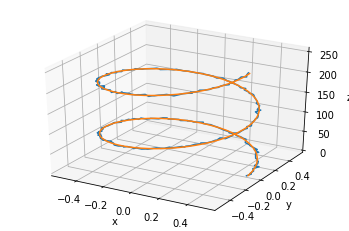

MSE Error = 9.002221933606002e-05
SNR = 1388.5460825328596
SNR(db) = 31.42560297523533


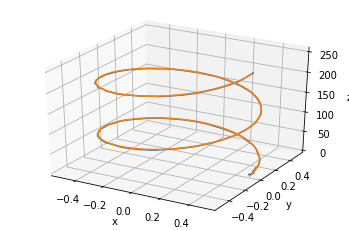

MSE Error = 0.00029142605659871206
SNR = 428.9252699600658
SNR(db) = 26.32381633277837


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_1_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_1_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_1_test[0], gaussian_noisy_circle_1_test[1], range(gaussian_noisy_circle_1_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_1_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_1_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussian Noise with Variance 0.05 - LSTM

In [ ]:
gaussian_noisy_circle_5 = circle + np.random.normal(0, 0.05, size=circle.shape)
gaussian_noisy_circle_5_train = gaussian_noisy_circle_5[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_5_validation = gaussian_noisy_circle_5[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_5_test = gaussian_noisy_circle_5[:, int(8/10*len(t)):len(t)]
gaussian_circle_5_train_dataset, gaussian_noisy_circle_5_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_5_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_5_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_5_lstm_model = circle_gaussian_5_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_5_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_5_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_5_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_5_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0009823063155636191
200 0.000949238077737391
300 0.0009173462749458849
400 0.0008527655154466629
500 0.000754230422899127
600 0.0005995621904730797
700 0.00045173062244430184
800 0.00034037945442833006
900 0.000262835412286222
1000 0.0002268379321321845
1100 0.00018996094877365977
1200 0.00017121658311225474
1300 0.00015092623652890325
1400 0.0001368124649161473
1500 0.00012705745757557452
1600 0.00011747024836950004
1700 0.00010942616063402966
1800 0.00010255121014779434
1900 9.679848881205544e-05
2000 9.212089207721874e-05
2100 8.872229955159128e-05
2200 8.574240928282961e-05
2300 8.343098306795582e-05
2400 8.153938688337803e-05
2500 7.996169006219134e-05
2600 7.862344500608742e-05
2700 7.747250492684543e-05
2800 7.647151505807415e-05
2900 7.559292862424627e-05
3000 7.481594366254285e-05
3100 7.41243566153571e-05
3200 7.350536179728806e-05
3300 7.29486855561845e-05
3400 7.244582229759544e-05
3500 7.198979437816888e-05
3600 7.157483196351677e-05
3700 7.119601650629193e-05
3800 7

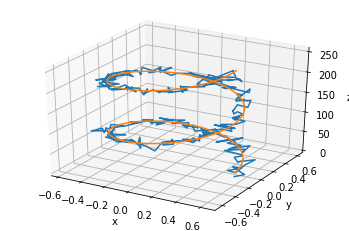

MSE Error = 0.0027271802941997245
SNR = 45.83488677512629
SNR(db) = 16.611961628596916


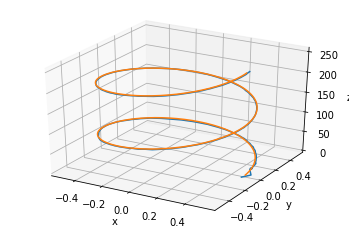

MSE Error = 0.0004457544608648089
SNR = 280.42344154557037
SNR(db) = 24.478143149592572


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_5_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_5_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_5_test[0], gaussian_noisy_circle_5_test[1], range(gaussian_noisy_circle_5_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_5_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_5_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussian Noise with Variance 0.1 - LSTM

In [ ]:
gaussian_noisy_circle_10 = circle + np.random.normal(0, 0.1, size=circle.shape)
gaussian_noisy_circle_10_train = gaussian_noisy_circle_10[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_10_validation = gaussian_noisy_circle_10[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_10_test = gaussian_noisy_circle_10[:, int(8/10*len(t)):len(t)]
gaussian_circle_10_train_dataset, gaussian_noisy_circle_10_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_10_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_10_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_10_lstm_model = circle_gaussian_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_10_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_10_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0021629834081977606
200 0.0019115847535431385
300 0.0017299354076385498
400 0.0011207335628569126
500 0.0009076307178474963
600 0.00046309659956023097
700 0.00037604235694743693
800 0.00033723219530656934
900 0.0003086562210228294
1000 0.00027952148229815066
1100 0.00026842739316634834
1200 0.00025518861366435885
1300 0.00024858606047928333
1400 0.0002418993681203574
1500 0.00023700999736320227
1600 0.0002331632567802444
1700 0.00023004069225862622
1800 0.0002274277649121359
1900 0.00022518109472002834
2000 0.0002232069382444024
2100 0.00022144369722809643
2200 0.00021984998602420092
2300 0.00021839699184056371
2400 0.00021706354164052755
2500 0.00021583365742117167
2600 0.00021469456260092556
2700 0.00021363593987189233
2800 0.00021264907263685018
2900 0.00021172664128243923
3000 0.00021086237393319607
3100 0.0002100508863804862
3200 0.00020928759477101266
3300 0.000208568453672342
3400 0.00020788998517673463
3500 0.00020724901696667075
3600 0.00020664295880123973
3700 0.0002060

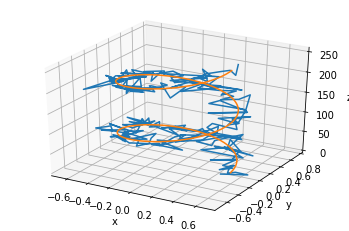

MSE Error = 0.009488560600102612
SNR = 13.173757882586344
SNR(db) = 11.197096773821773


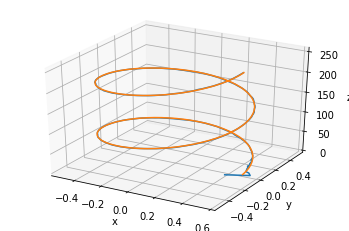

MSE Error = 0.00011507430234115366
SNR = 1086.254684642104
SNR(db) = 30.35931662423193


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_10_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_10_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_10_test[0], gaussian_noisy_circle_10_test[1], range(gaussian_noisy_circle_10_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_10_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussian Noise with Variance 0.25 - LSTM

In [ ]:
gaussian_noisy_circle_25 = circle + np.random.normal(0, 0.25, size=circle.shape)
gaussian_noisy_circle_25_train = gaussian_noisy_circle_25[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_25_validation = gaussian_noisy_circle_25[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_25_test = gaussian_noisy_circle_25[:, int(8/10*len(t)):len(t)]
gaussian_circle_25_train_dataset, gaussian_noisy_circle_25_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_25_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_25_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_25_lstm_model = circle_gaussian_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_25_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_25_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.003998685162514448
200 0.002430336782708764
300 0.0017426994163542986
400 0.0015399331459775567
500 0.001312572625465691
600 0.0012110112002119422
700 0.0011295083677396178
800 0.0010833325795829296
900 0.0010392070980742574
1000 0.0010092566953971982
1100 0.0010171594331040978
1200 0.000958551187068224
1300 0.000936579133849591
1400 0.0009183967486023903
1500 0.0009020271827466786
1600 0.0008921578992158175
1700 0.0008763549849390984
1800 0.0008643179899081588
1900 0.0008582791779190302
2000 0.0008465881110168993
2100 0.0008355194586329162
2200 0.0008351898868568242
2300 0.0008241162868216634
2400 0.0008185383630916476
2500 0.0008137071272358298
2600 0.0008095555822364986
2700 0.0008057673112489283
2800 0.0008022502879612148
2900 0.0007989649311639369
3000 0.0007958820788189769
3100 0.0007929801940917969
3200 0.000790243037045002
3300 0.0007876575691625476
3400 0.0007852132548578084
3500 0.0007829012465663254
3600 0.0007807136862538755
3700 0.0007786436472088099
3800 0.000776684

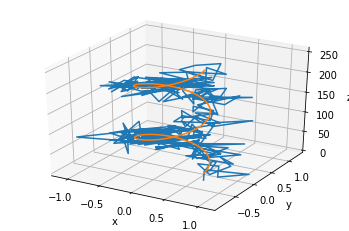

MSE Error = 0.062065513975495784
SNR = 2.014000883797587
SNR(db) = 3.040596567977039


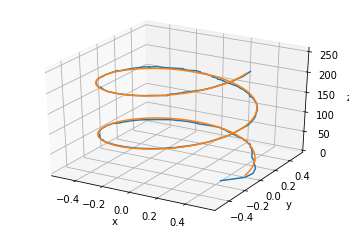

MSE Error = 0.001676905275527621
SNR = 74.5420757058982
SNR(db) = 18.72401481992631


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_25_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_25_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_25_test[0], gaussian_noisy_circle_25_test[1], range(gaussian_noisy_circle_25_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_25_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussian Noise with Variance 0.5 - LSTM

In [ ]:
gaussian_noisy_circle_50 = circle + np.random.normal(0, 0.5, size=circle.shape)
gaussian_noisy_circle_50_train = gaussian_noisy_circle_50[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_50_validation = gaussian_noisy_circle_50[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_50_test = gaussian_noisy_circle_50[:, int(8/10*len(t)):len(t)]
gaussian_circle_50_train_dataset, gaussian_noisy_circle_50_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_50_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_50_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_50_lstm_model = circle_gaussian_50_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_50_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_50_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_50_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_50_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.005430280230939388
200 0.004445481579750776
300 0.0035536852665245533
400 0.0031052264384925365
500 0.003038963535800576
600 0.002752617234364152
700 0.002625636290758848
800 0.0025243163108825684
900 0.0024480419233441353
1000 0.0023799361661076546
1100 0.002310392912477255
1200 0.0022587007842957973
1300 0.0022244956344366074
1400 0.0021820857655256987
1500 0.0021503735333681107
1600 0.0021241926588118076
1700 0.0020996551029384136
1800 0.002079040976241231
1900 0.0020612580701708794
2000 0.002045356435701251
2100 0.0020310182590037584
2200 0.0020173201337456703
2300 0.002004855778068304
2400 0.0019934438169002533
2500 0.0019825163763016462
2600 0.0019723675213754177
2700 0.0019628051668405533
2800 0.0019537925254553556
2900 0.0019453046843409538
3000 0.0019373212708160281
3100 0.0019298234255984426
3200 0.0019227906595915556
3300 0.0019161994569003582
3400 0.001910024555400014
3500 0.0019042396452277899
3600 0.0018988176016137004
3700 0.0018937337445095181
3800 0.0018889638595

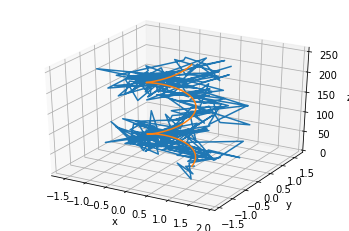

MSE Error = 0.23709468478458595
SNR = 0.5272155304264607
SNR(db) = -2.7801180501653033


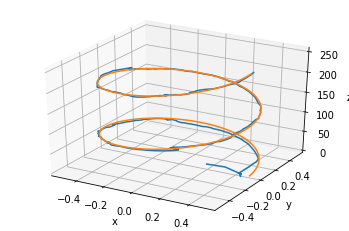

MSE Error = 0.0036322751385036416
SNR = 34.41369258483409
SNR(db) = 15.367312748638122


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_50_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_50_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_50_test[0], gaussian_noisy_circle_50_test[1], range(gaussian_noisy_circle_50_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_50_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_50_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## F) E)

### Circle - Gaussain Noise with Mean between -0.01 to 0.01 and Variance between 0 to 0.01 - LSTM

In [ ]:
gaussian_noisy_circle_1_1 = circle + np.random.normal(0.01*(2*np.random.rand(circle.shape[0], circle.shape[1])-1), 0.01*np.random.rand(circle.shape[0], circle.shape[1]), size=circle.shape)
gaussian_noisy_circle_1_1_train = gaussian_noisy_circle_1_1[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_1_1_validation = gaussian_noisy_circle_1_1[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_1_1_test = gaussian_noisy_circle_1_1[:, int(8/10*len(t)):len(t)]
gaussian_circle_1_1_train_dataset, gaussian_noisy_circle_1_1_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_1_1_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_1_1_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_1_1_lstm_model = circle_gaussian_1_1_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_1_1_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_1_1_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_1_1_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_1_1_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.00034800704452209175
200 0.00023392665025312454
300 0.00017038198711816221
400 0.00013871189730707556
500 0.00011868008004967123
600 0.00010029714030679315
700 7.923554949229583e-05
800 6.491348904091865e-05
900 5.7326178648509085e-05
1000 5.339536437531933e-05
1100 5.103841976961121e-05
1200 4.921816071146168e-05
1300 4.763807010021992e-05
1400 4.6186120016500354e-05
1500 4.480177813093178e-05
1600 4.344812987255864e-05
1700 4.210258339298889e-05
1800 4.075278411619365e-05
1900 3.939473390346393e-05
2000 3.803261279244907e-05
2100 3.6679160984931514e-05
2200 3.5354143619770184e-05
2300 3.4078697353834286e-05
2400 3.286573337391019e-05
2500 3.171528078382835e-05
2600 3.0620572943007573e-05
2700 2.9575710868812166e-05
2800 2.8577929697348736e-05
2900 2.762670374067966e-05
3000 2.672220034583006e-05
3100 2.586380833236035e-05
3200 2.504988333384972e-05
3300 2.4277609554701485e-05
3400 2.35491716011893e-05
3500 2.2860582248540595e-05
3600 2.22062662942335e-05
3700 2.1579506210400723

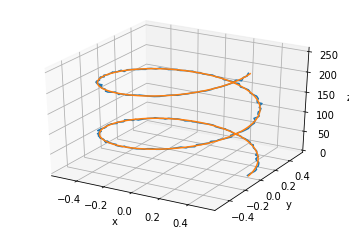

MSE Error = 5.823635866569757e-05
SNR = 2146.4254095547976
SNR(db) = 33.31715800906949


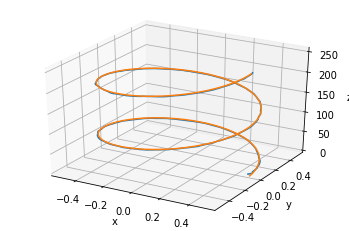

MSE Error = 0.00031990331772883284
SNR = 390.74305601905843
SNR(db) = 25.918912688168756


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_1_1_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_1_1_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_1_1_test[0], gaussian_noisy_circle_1_1_test[1], range(gaussian_noisy_circle_1_1_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_1_1_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_1_1_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussain Noise with Mean between -0.05 to 0.05 and Variance between 0 to 0.05 - LSTM

In [ ]:
gaussian_noisy_circle_5_5 = circle + np.random.normal(0.05*(2*np.random.rand(circle.shape[0], circle.shape[1])-1), 0.05*np.random.rand(circle.shape[0], circle.shape[1]), size=circle.shape)
gaussian_noisy_circle_5_5_train = gaussian_noisy_circle_5_5[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_5_5_validation = gaussian_noisy_circle_5_5[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_5_5_test = gaussian_noisy_circle_5_5[:, int(8/10*len(t)):len(t)]
gaussian_circle_5_5_train_dataset, gaussian_noisy_circle_5_5_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_5_5_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_5_5_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_5_5_lstm_model = circle_gaussian_5_5_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_5_5_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_5_5_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_5_5_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_5_5_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0007647150778211653
200 0.000740008894354105
300 0.000706337159499526
400 0.0006329452735371888
500 0.0005355006433092058
600 0.0004617181548383087
700 0.000407980231102556
800 0.0002823004324454814
900 0.0002646598150022328
1000 0.00021020075655542314
1100 0.00021058750280644745
1200 0.00016377407882828265
1300 0.00014262435433920473
1400 0.0001244736777152866
1500 0.00012109671661164612
1600 0.00010106462286785245
1700 9.180267807096243e-05
1800 8.436053758487105e-05
1900 7.835662108846009e-05
2000 7.348198414547369e-05
2100 6.946751818759367e-05
2200 7.194403588073328e-05
2300 6.355028017424047e-05
2400 6.127704546088353e-05
2500 5.934101136517711e-05
2600 5.768070695921779e-05
2700 5.6245051382575184e-05
2800 5.4992222430882975e-05
2900 5.388872523326427e-05
3000 5.2908122597727925e-05
3100 5.202954343985766e-05
3200 5.123662776895799e-05
3300 5.0516635383246467e-05
3400 4.985963460057974e-05
3500 4.925820030621253e-05
3600 4.870678822044283e-05
3700 4.820125104743056e-05
380

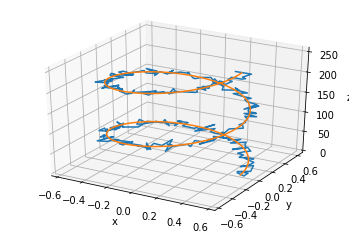

MSE Error = 0.0014953379424400034
SNR = 83.59314403273446
SNR(db) = 19.221706598451195


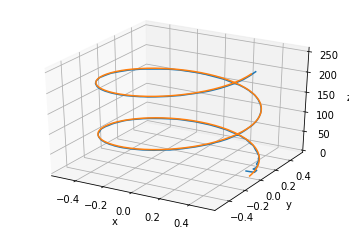

MSE Error = 0.0007523030709374417
SNR = 166.1564399095673
SNR(db) = 22.20517178374216


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_5_5_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_5_5_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_5_5_test[0], gaussian_noisy_circle_5_5_test[1], range(gaussian_noisy_circle_5_5_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_5_5_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_5_5_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussain Noise with Mean between -0.1 to 0.1 and Variance between 0 to 0.1 - LSTM

In [ ]:
gaussian_noisy_circle_10_10 = circle + np.random.normal(0.1*(2*np.random.rand(circle.shape[0], circle.shape[1])-1), 0.1*np.random.rand(circle.shape[0], circle.shape[1]), size=circle.shape)
gaussian_noisy_circle_10_10_train = gaussian_noisy_circle_10_10[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_10_10_validation = gaussian_noisy_circle_10_10[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_10_10_test = gaussian_noisy_circle_10_10[:, int(8/10*len(t)):len(t)]
gaussian_circle_10_10_train_dataset, gaussian_noisy_circle_10_10_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_10_10_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_10_10_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_10_10_lstm_model = circle_gaussian_10_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_10_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_10_10_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_10_10_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_10_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0017005143454298377
200 0.0015663659432902932
300 0.001461752806790173
400 0.00503509072586894
500 0.001144553767517209
600 0.0006993371644057333
700 0.0005281423218548298
800 0.00033209280809387565
900 0.00024924956960603595
1000 0.00020920412498526275
1100 0.00020172777294646949
1200 0.00017617776757106185
1300 0.00016710242198314518
1400 0.00016053204308263958
1500 0.00015558408631477505
1600 0.00015189169789664447
1700 0.00014888572331983596
1800 0.00014648606884293258
1900 0.00014453211042564362
2000 0.00014291932166088372
2100 0.00014157057739794254
2200 0.0001404281210852787
2300 0.00013944850070402026
2400 0.0001385986979585141
2500 0.00013785359624307603
2600 0.00013719388516619802
2700 0.00013660463446285576
2800 0.00013607414439320564
2900 0.00013559326180256903
3000 0.00013515466707758605
3100 0.00013475252490025014
3200 0.00013438203313853592
3300 0.00013403932098299265
3400 0.0001337211433565244
3500 0.0001334248372586444
3600 0.00013314814714249223
3700 0.000132889

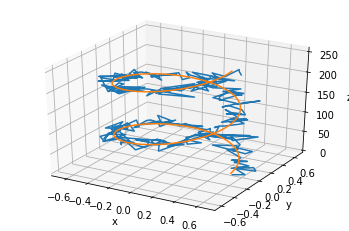

MSE Error = 0.006807642484651091
SNR = 18.361716303673745
SNR(db) = 12.639132730731545


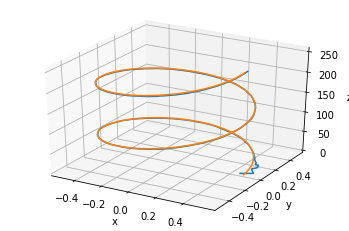

MSE Error = 0.0004398245927962288
SNR = 284.20420787591706
SNR(db) = 24.536305037243245


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_10_10_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_10_10_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_10_10_test[0], gaussian_noisy_circle_10_10_test[1], range(gaussian_noisy_circle_10_10_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_10_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_10_10_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussain Noise with Mean between -0.25 to 0.25 and Variance between 0 to 0.25 - LSTM

In [ ]:
gaussian_noisy_circle_25_25 = circle + np.random.normal(0.25*(2*np.random.rand(circle.shape[0], circle.shape[1])-1), 0.25*np.random.rand(circle.shape[0], circle.shape[1]), size=circle.shape)
gaussian_noisy_circle_25_25_train = gaussian_noisy_circle_25_25[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_25_25_validation = gaussian_noisy_circle_25_25[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_25_25_test = gaussian_noisy_circle_25_25[:, int(8/10*len(t)):len(t)]
gaussian_circle_25_25_train_dataset, gaussian_noisy_circle_25_25_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_25_25_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_25_25_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_25_25_lstm_model = circle_gaussian_25_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_25_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_25_25_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_25_25_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_25_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0034487901721149683
200 0.002322789281606674
300 0.0015208236873149872
400 0.0012867271434515715
500 0.0010708767222240567
600 0.0009639172349125147
700 0.0011779250344261527
800 0.000835950078908354
900 0.0007980266236700118
1000 0.0007977396016940475
1100 0.000749338825698942
1200 0.0007284603198058903
1300 0.0007098191999830306
1400 0.0008264253265224397
1500 0.0006790790939703584
1600 0.0006655610632151365
1700 0.0006538999150507152
1800 0.0006422540755011141
1900 0.0006324650603346527
2000 0.0006225078250281513
2100 0.0006152291898615658
2200 0.0006061671301722527
2300 0.0005990813951939344
2400 0.0005932814092375338
2500 0.000588054652325809
2600 0.0005835191695950925
2700 0.0005795265315100551
2800 0.000575966842006892
2900 0.0005727630923502147
3000 0.0005698605673387647
3100 0.0005672184634022415
3200 0.0005648051155731082
3300 0.0005625943886116147
3400 0.000560564105398953
3500 0.0005586950574070215
3600 0.00055697065545246
3700 0.000555376464035362
3800 0.000553899270

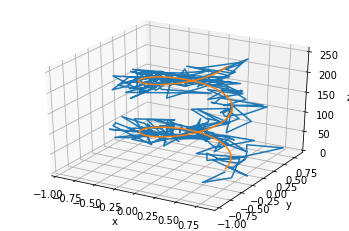

MSE Error = 0.0420783405888111
SNR = 2.9706494659924463
SNR(db) = 4.728514084624848


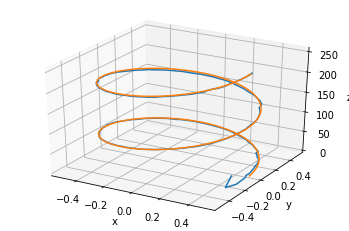

MSE Error = 0.0014754689805899835
SNR = 84.7188261118287
SNR(db) = 19.27979929433149


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_25_25_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_25_25_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_25_25_test[0], gaussian_noisy_circle_25_25_test[1], range(gaussian_noisy_circle_25_25_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_25_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_25_25_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Circle - Gaussain Noise with Mean between -0.5 to 0.5 and Variance between 0 to 0.5 - LSTM

In [ ]:
gaussian_noisy_circle_50_50 = circle + np.random.normal(0.5*(2*np.random.rand(circle.shape[0], circle.shape[1])-1), 0.5*np.random.rand(circle.shape[0], circle.shape[1]), size=circle.shape)
gaussian_noisy_circle_50_50_train = gaussian_noisy_circle_50_50[:, 0:int(7/10*len(t))]
gaussian_noisy_circle_50_50_validation = gaussian_noisy_circle_50_50[:, int(7/10*len(t)):int(8/10*len(t))]
gaussian_noisy_circle_50_50_test = gaussian_noisy_circle_50_50[:, int(8/10*len(t)):len(t)]
gaussian_circle_50_50_train_dataset, gaussian_noisy_circle_50_50_train_dataset = create_dataset(circle_train, gaussian_noisy_circle_50_50_train, n_samples, sample_size)

In [ ]:
input_size = 2
hidden_size = 50
output_size = 2
circle_gaussian_50_50_lstm_model = Custom2DLSTM(input_size, hidden_size, output_size)
circle_gaussian_50_50_lstm_model = circle_gaussian_50_50_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(circle_gaussian_50_50_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(10000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_circle_50_50_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_circle_50_50_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = circle_gaussian_50_50_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.004069705028086901
200 0.0031498651951551437
300 0.0026879869401454926
400 0.002432504901662469
500 0.00241807266138494
600 0.002073031384497881
700 0.002061745384708047
800 0.001849920256063342
900 0.001784173189662397
1000 0.0017293522832915187
1100 0.0017095207003876567
1200 0.0016490116249769926
1300 0.0016171765746548772
1400 0.0015913114184513688
1500 0.0015684966929256916
1600 0.0015476563712581992
1700 0.0015259106876328588
1800 0.0015061474405229092
1900 0.0014887168072164059
2000 0.0014734918950125575
2100 0.0014605981996282935
2200 0.0014472013572230935
2300 0.0014364499365910888
2400 0.0014264151686802506
2500 0.001417518244124949
2600 0.001409177202731371
2700 0.0014091350603848696
2800 0.0013944065431132913
2900 0.0013878040481358767
3000 0.0013816559221595526
3100 0.0013759275898337364
3200 0.001370587502606213
3300 0.0013656059745699167
3400 0.0013609555317088962
3500 0.0013566099805757403
3600 0.0013525460381060839
3700 0.0013487424002960324
3800 0.00134517950937

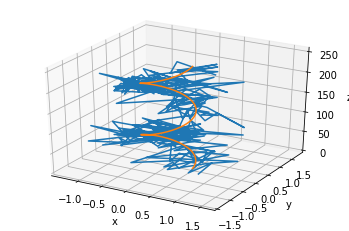

MSE Error = 0.16411601389114655
SNR = 0.7616563249148185
SNR(db) = -1.1824094711412498


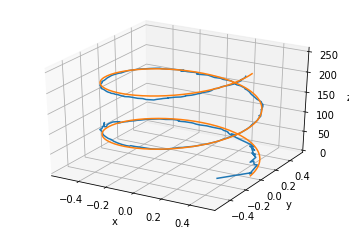

MSE Error = 0.004223291662009251
SNR = 29.597766387872593
SNR(db) = 14.712589380176128


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_circle_50_50_test.T[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.squeeze(circle_gaussian_50_50_lstm_model(model_input).cpu().numpy()).T
ax = plt.axes(projection='3d')
ax.plot3D(gaussian_noisy_circle_50_50_test[0], gaussian_noisy_circle_50_50_test[1], range(gaussian_noisy_circle_50_50_test.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - gaussian_noisy_circle_50_50_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - gaussian_noisy_circle_50_50_test, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
ax = plt.axes(projection='3d')
ax.plot3D(pred[0], pred[1], range(pred.shape[1]))
ax.plot3D(circle_test[0], circle_test[1], range(circle_test.shape[1]))
plt.xlabel('x')
plt.ylabel('y')
ax.set_zlabel('z')
plt.show()
MSE_erreor = np.mean(np.power(circle_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(circle_test - pred, 2))
signal_power = np.mean(np.power(circle_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

# G)

In [ ]:
voice, fs = a2n.audio_from_file('/content/drive/MyDrive/DL - HW3 Practical/Voice.mp3')
voice = (voice[:, 0]+voice[:, 1]).T/2
short_voice = voice[0: int(len(voice)/5)]
long_voice = voice.copy()

## Short Voice

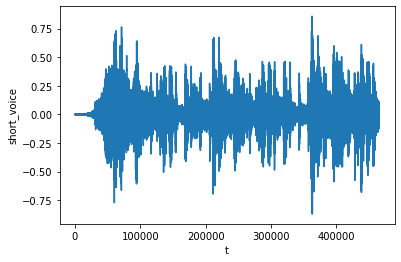

In [ ]:
plt.plot(range(len(short_voice)), short_voice)
plt.xlabel('t')
plt.ylabel('short_voice')
plt.show()
write('/content/drive/MyDrive/DL - HW3 Practical/short_voice.wav', fs, np.int16(short_voice/np.max(np.abs(short_voice))*(np.power(2, 15)-1)))
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/short_voice.wav')

In [ ]:
short_voice_train = short_voice[0:int(7/10*len(short_voice))]
short_voice_validation = short_voice[int(7/10*len(short_voice)):int(8/10*len(short_voice))]
short_voice_test = short_voice[int(8/10*len(short_voice)):len(short_voice)]

In [ ]:
gaussian_noisy_short_voice = short_voice + np.random.normal(0, 0.05, size=len(short_voice))

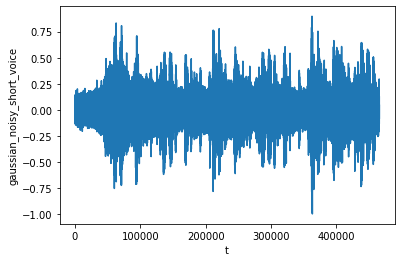

In [ ]:
plt.plot(range(len(gaussian_noisy_short_voice)), gaussian_noisy_short_voice)
plt.xlabel('t')
plt.ylabel('gaussian_noisy_short_voice')
plt.show()
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice.wav', fs, np.int16(gaussian_noisy_short_voice/np.max(np.abs(gaussian_noisy_short_voice))*(np.power(2, 15)-1)))
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice.wav')

In [ ]:
gaussian_noisy_short_voice_train = gaussian_noisy_short_voice[0:int(7/10*len(gaussian_noisy_short_voice))]
gaussian_noisy_short_voice_validation = gaussian_noisy_short_voice[int(7/10*len(gaussian_noisy_short_voice)):int(8/10*len(gaussian_noisy_short_voice))]
gaussian_noisy_short_voice_test = gaussian_noisy_short_voice[int(8/10*len(gaussian_noisy_short_voice)):len(gaussian_noisy_short_voice)]

In [ ]:
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_test.wav', fs, np.int16(gaussian_noisy_short_voice_test/np.max(np.abs(gaussian_noisy_short_voice_test))*(np.power(2, 15)-1)))

In [ ]:
uniform_noisy_short_voice = short_voice + 0.1*(2*np.random.rand(len(short_voice))-1)

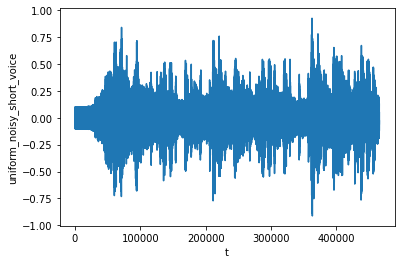

In [ ]:
plt.plot(range(len(uniform_noisy_short_voice)), uniform_noisy_short_voice)
plt.xlabel('t')
plt.ylabel('uniform_noisy_short_voice')
plt.show()
write('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice.wav', fs, np.int16(uniform_noisy_short_voice/np.max(np.abs(uniform_noisy_short_voice))*(np.power(2, 15)-1)))
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice.wav')

In [ ]:
uniform_noisy_short_voice_train = uniform_noisy_short_voice[0:int(7/10*len(uniform_noisy_short_voice))]
uniform_noisy_short_voice_validation = uniform_noisy_short_voice[int(7/10*len(uniform_noisy_short_voice)):int(8/10*len(uniform_noisy_short_voice))]
uniform_noisy_short_voice_test = uniform_noisy_short_voice[int(8/10*len(uniform_noisy_short_voice)):len(uniform_noisy_short_voice)]

In [ ]:
write('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice_test.wav', fs, np.int16(uniform_noisy_short_voice_test/np.max(np.abs(uniform_noisy_short_voice_test))*(np.power(2, 15)-1)))

In [ ]:
def create_dataset(x, noisy_x, n_samples, sample_size):
  data_in = np.zeros((n_samples, sample_size))
  data_out = np.zeros((n_samples, sample_size))
  for i in range(n_samples):
    random_offset = np.random.randint(0, len(x)-sample_size-1)
    data_in[i, :] = noisy_x[random_offset:random_offset+sample_size]
    data_out[i, :] = x[random_offset+1:random_offset+sample_size+1]
  return data_in, data_out

In [ ]:
n_samples = 500
sample_size = 2048
gaussian_short_voice_train_dataset, gaussian_noisy_short_voice_train_dataset = create_dataset(short_voice_train, gaussian_noisy_short_voice_train, n_samples, sample_size)
uniform_short_voice_train_dataset, uniform_noisy_short_voice_train_dataset = create_dataset(short_voice_train, uniform_noisy_short_voice_train, n_samples, sample_size)

In [ ]:
class CustomRNN(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomRNN, self).__init__()
        self.rnn = torch.nn.RNN(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.rnn(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred
class CustomLSTM(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomLSTM, self).__init__()
        self.lstm = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.lstm(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred

### Short Voice - Gaussain Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_gaussian_rnn_model = CustomRNN(input_size, hidden_size, output_size)
short_voice_gaussian_rnn_model = short_voice_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_short_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_short_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0015263875247910619
200 0.0027884822338819504
300 0.0013946447288617492
400 0.0013129102298989892
500 0.0012914048274978995
600 0.0012827790342271328
700 0.0012735327472910285
800 0.0012748154113069177
900 0.0012696870835497975
1000 0.0022484923247247934
1100 0.0016205196734517813
1200 0.0014110291376709938
1300 0.0013781338930130005
1400 0.0013627057196572423
1500 0.0013558096252381802
1600 0.0013498086482286453
1700 0.0013456132728606462
1800 0.0013415541034191847
1900 0.0013392858672887087
2000 0.0013366254279389977


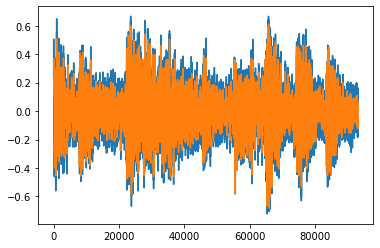

MSE Error = 0.002474707970141962
SNR = 9.209378852335167
SNR(db) = 9.642303391978908


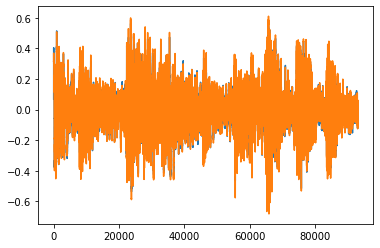

MSE Error = 0.0009925112
SNR = 22.962486
SNR(db) = 13.610188781738671


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_short_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_gaussian_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_short_voice_test)), gaussian_noisy_short_voice_test)
plt.plot(range(len(gaussian_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_short_voice_test)), pred)
plt.plot(range(len(gaussian_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_RNN.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_RNN.wav')

### Short Voice - Gaussain Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_gaussian_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
short_voice_gaussian_lstm_model = short_voice_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_short_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_short_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0013724933378398418
200 0.0013546441914513707
300 0.0013200920075178146
400 0.0012487242929637432
500 0.0012411386705935001
600 0.0012319887755438685
700 0.0012240309733897448
800 0.0012145480141043663
900 0.0012021466391161084
1000 0.0012681352673098445
1100 0.001225392217747867
1200 0.0012153938878327608
1300 0.0012074243277311325
1400 0.0012264366960152984
1500 0.0011948960600420833
1600 0.0012056839186698198
1700 0.0011789440177381039
1800 0.0011835712939500809
1900 0.001170744770206511
2000 0.001158778090029955


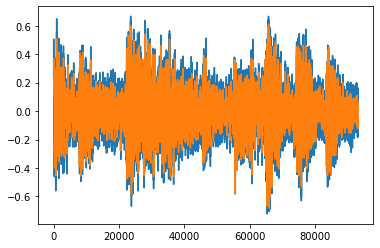

MSE Error = 0.002474707970141962
SNR = 9.209378852335167
SNR(db) = 9.642303391978908


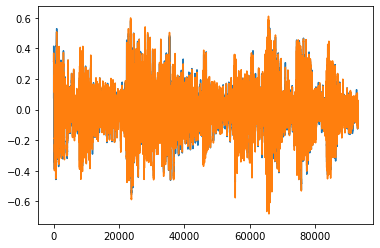

MSE Error = 0.0009981947
SNR = 22.831741
SNR(db) = 13.58539002408643


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_short_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_gaussian_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_short_voice_test)), gaussian_noisy_short_voice_test)
plt.plot(range(len(gaussian_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_short_voice_test)), pred)
plt.plot(range(len(gaussian_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_LSTM.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_LSTM.wav')

### Short Voice - Uniform Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_uniform_rnn_model = CustomRNN(input_size, hidden_size, output_size)
short_voice_uniform_rnn_model = short_voice_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_short_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_short_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0020167140755802393
200 0.001945118186995387
300 0.0018170058028772473
400 0.0017925327410921454
500 0.0020390739664435387
600 0.0017126906896010041
700 0.0017202998278662562
800 0.0017100960249081254
900 0.0017096565570682287
1000 0.001693590427748859
1100 0.0016898356843739748
1200 0.0016878924798220396
1300 0.0016860999166965485
1400 0.0016844866331666708
1500 0.0016831057146191597
1600 0.001681945868767798
1700 0.0016811774112284184
1800 0.0016800567973405123
1900 0.0016791728558018804
2000 0.0016782906604930758


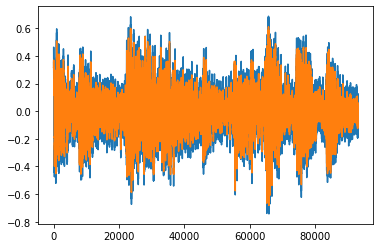

MSE Error = 0.003341533415749951
SNR = 6.820378673608363
SNR(db) = 8.338084877493088


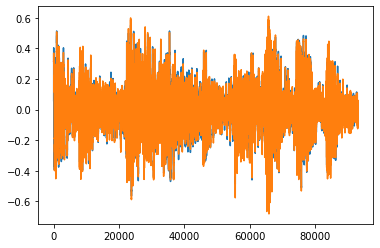

MSE Error = 0.0012400666
SNR = 18.378468
SNR(db) = 12.643093146992813


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_short_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_uniform_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_short_voice_test)), uniform_noisy_short_voice_test)
plt.plot(range(len(uniform_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - uniform_noisy_short_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - uniform_noisy_short_voice_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_short_voice_test)), pred)
plt.plot(range(len(uniform_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice_RNN.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice_RNN.wav')

### Short Voice - Uniform Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_uniform_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
short_voice_uniform_lstm_model = short_voice_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_short_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_short_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0019431429682299495
200 0.0019201200921088457
300 0.001904779695905745
400 0.001845856080763042
500 0.001754873082973063
600 0.0017345055239275098
700 0.0017221987945958972
800 0.001707903342321515
900 0.0017165886238217354
1000 0.0016789485234767199
1100 0.0016839266754686832
1200 0.0016225345898419619
1300 0.0016580773517489433
1400 0.0016880800249055028
1500 0.0017372873844578862
1600 0.0016398990992456675
1700 0.0017355825984850526
1800 0.0017084069550037384
1900 0.0016922272043302655
2000 0.001678462140262127


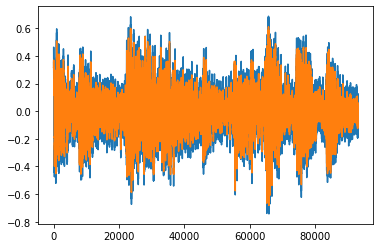

MSE Error = 0.003341533415749951
SNR = 6.820378673608363
SNR(db) = 8.338084877493088


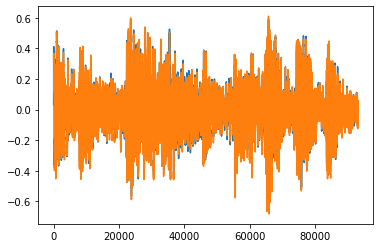

MSE Error = 0.0012216145
SNR = 18.656067
SNR(db) = 12.708200499076959


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_short_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_uniform_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_short_voice_test)), uniform_noisy_short_voice_test)
plt.plot(range(len(uniform_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - uniform_noisy_short_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - uniform_noisy_short_voice_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_short_voice_test)), pred)
plt.plot(range(len(uniform_noisy_short_voice_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice_LSTM.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/uniform_noisy_short_voice_LSTM.wav')

### Short Voice - Gaussian Noise with Variance 0.1 - LSTM

In [ ]:
gaussian_noisy_short_voice_10 = short_voice + np.random.normal(0, 0.1, size=len(short_voice))
gaussian_noisy_short_voice_10_train = gaussian_noisy_short_voice_10[0:int(7/10*len(short_voice))]
gaussian_noisy_short_voice_10_validation = gaussian_noisy_short_voice_10[int(7/10*len(short_voice)):int(8/10*len(short_voice))]
gaussian_noisy_short_voice_10_test = gaussian_noisy_short_voice_10[int(8/10*len(short_voice)):len(short_voice)]
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_test.wav', fs, np.int16(gaussian_noisy_short_voice_10_test/np.max(np.abs(gaussian_noisy_short_voice_10_test))*(np.power(2, 15)-1)))
gaussian_short_voice_10_train_dataset, gaussian_noisy_short_voice_10_train_dataset = create_dataset(short_voice_train, gaussian_noisy_short_voice_10_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_gaussian_10_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
short_voice_gaussian_10_lstm_model = short_voice_gaussian_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_gaussian_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_short_voice_10_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_short_voice_10_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_gaussian_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.002115631243214011
200 0.0020093247294425964
300 0.0018947835778817534
400 0.0018782680854201317
500 0.001969168893992901
600 0.001870864536613226
700 0.0018582155462354422
800 0.001849405700340867
900 0.0018415643135085702
1000 0.0018502753227949142
1100 0.0018271978478878736
1200 0.0018174765864387155
1300 0.0018408475443720818
1400 0.0017873640172183514
1500 0.0018082126043736935
1600 0.0017632654635235667
1700 0.0017447170102968812
1800 0.001894502667710185
1900 0.0017734571592882276
2000 0.0017557890387251973


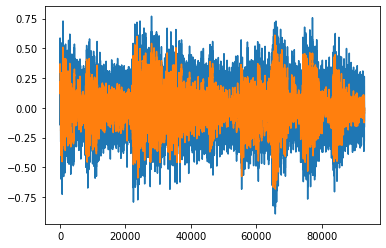

MSE Error = 0.009998749230261526
SNR = 2.27933741721959
SNR(db) = 3.5780861986653942


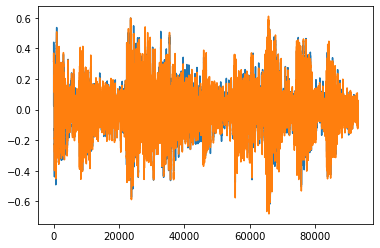

MSE Error = 0.0017225358
SNR = 13.230798
SNR(db) = 11.215859929185488


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_short_voice_10_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_gaussian_10_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_short_voice_10_test)), gaussian_noisy_short_voice_10_test)
plt.plot(range(len(gaussian_noisy_short_voice_10_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_10_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_short_voice_10_test)), pred)
plt.plot(range(len(gaussian_noisy_short_voice_10_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_LSTM.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_LSTM.wav')

### Short Voice - Gaussian Noise with Variance 0.25 - LSTM

In [ ]:
gaussian_noisy_short_voice_25 = short_voice + np.random.normal(0, 0.25, size=len(short_voice))
gaussian_noisy_short_voice_25_train = gaussian_noisy_short_voice_25[0:int(7/10*len(short_voice))]
gaussian_noisy_short_voice_25_validation = gaussian_noisy_short_voice_25[int(7/10*len(short_voice)):int(8/10*len(short_voice))]
gaussian_noisy_short_voice_25_test = gaussian_noisy_short_voice_25[int(8/10*len(short_voice)):len(short_voice)]
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_test.wav', fs, np.int16(gaussian_noisy_short_voice_25_test/np.max(np.abs(gaussian_noisy_short_voice_25_test))*(np.power(2, 15)-1)))
gaussian_short_voice_25_train_dataset, gaussian_noisy_short_voice_25_train_dataset = create_dataset(short_voice_train, gaussian_noisy_short_voice_25_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_gaussian_25_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
short_voice_gaussian_25_lstm_model = short_voice_gaussian_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_gaussian_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_short_voice_25_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_short_voice_25_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_gaussian_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.004472734872251749
200 0.004283281043171883
300 0.004074144642800093
400 0.004156544804573059
500 0.004075862001627684
600 0.004063155502080917
700 0.003842829028144479
800 0.0038297141436487436
900 0.004249997437000275
1000 0.004086649976670742
1100 0.003890189342200756
1200 0.003889726707711816
1300 0.0038569141179323196
1400 0.003724075620993972
1500 0.003768532071262598
1600 0.003645514138042927
1700 0.0036410174798220396
1800 0.0036114922259002924
1900 0.003596766386181116
2000 0.003833027556538582


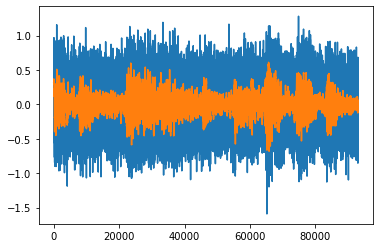

MSE Error = 0.06220117745872464
SNR = 0.36640019010980895
SNR(db) = -4.360443096667975


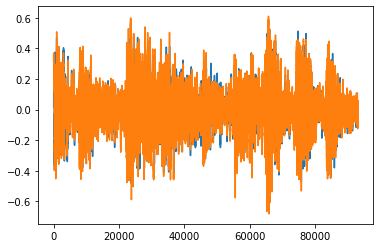

MSE Error = 0.004203964
SNR = 5.4211984
SNR(db) = 7.340953090746235


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_short_voice_25_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_gaussian_25_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_short_voice_25_test)), gaussian_noisy_short_voice_25_test)
plt.plot(range(len(gaussian_noisy_short_voice_25_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_25_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_short_voice_25_test)), pred)
plt.plot(range(len(gaussian_noisy_short_voice_25_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_LSTM.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_LSTM.wav')

### Short Voice - Gaussain Noise with Mean between -0.1 to 0.1 and Variance between 0 to 0.1 - LSTM

In [ ]:
gaussian_noisy_short_voice_10_10 = short_voice + np.random.normal(0.1*(2*np.random.rand(len(short_voice))-1), 0.1*np.random.rand(len(short_voice)), size=len(short_voice))
gaussian_noisy_short_voice_10_10_train = gaussian_noisy_short_voice_10_10[0:int(7/10*len(short_voice))]
gaussian_noisy_short_voice_10_10_validation = gaussian_noisy_short_voice_10_10[int(7/10*len(short_voice)):int(8/10*len(short_voice))]
gaussian_noisy_short_voice_10_10_test = gaussian_noisy_short_voice_10_10[int(8/10*len(short_voice)):len(short_voice)]
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_10_test.wav', fs, np.int16(gaussian_noisy_short_voice_10_10_test/np.max(np.abs(gaussian_noisy_short_voice_10_10_test))*(np.power(2, 15)-1)))
gaussian_short_voice_10_10_train_dataset, gaussian_noisy_short_voice_10_10_train_dataset = create_dataset(short_voice_train, gaussian_noisy_short_voice_10_10_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_gaussian_10_10_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
short_voice_gaussian_10_10_lstm_model = short_voice_gaussian_10_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_gaussian_10_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_short_voice_10_10_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_short_voice_10_10_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_gaussian_10_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.002011837437748909
200 0.001984640955924988
300 0.0018639396876096725
400 0.0018424533773213625
500 0.0018062437884509563
600 0.001813890179619193
700 0.0017818459309637547
800 0.0017815949395298958
900 0.0017218698048964143
1000 0.001745538436807692
1100 0.0017582782311365008
1200 0.0017007250571623445
1300 0.0019561101216822863
1400 0.0018605041550472379
1500 0.0018325470155104995
1600 0.0018139253370463848
1700 0.0018067924538627267
1800 0.001794332405552268
1900 0.0017852323362603784
2000 0.0018498455174267292


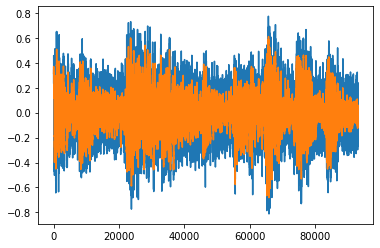

MSE Error = 0.00665089684570379
SNR = 3.42668421637789
SNR(db) = 5.3487408417789


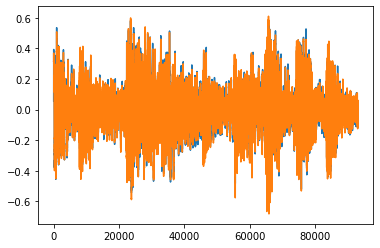

MSE Error = 0.0015719914
SNR = 14.497868
SNR(db) = 11.613041801849711


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_short_voice_10_10_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_gaussian_10_10_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_short_voice_10_10_test)), gaussian_noisy_short_voice_10_10_test)
plt.plot(range(len(gaussian_noisy_short_voice_10_10_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_10_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_10_10_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_short_voice_10_10_test)), pred)
plt.plot(range(len(gaussian_noisy_short_voice_10_10_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_10_LSTM.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_10_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_10_10_LSTM.wav')

### Short Voice - Gaussain Noise with Mean between -0.25 to 0.25 and Variance between 0 to 0.25 - LSTM

In [ ]:
gaussian_noisy_short_voice_25_25 = short_voice + np.random.normal(0.25*(2*np.random.rand(len(short_voice))-1), 0.25*np.random.rand(len(short_voice)), size=len(short_voice))
gaussian_noisy_short_voice_25_25_train = gaussian_noisy_short_voice_25_25[0:int(7/10*len(short_voice))]
gaussian_noisy_short_voice_25_25_validation = gaussian_noisy_short_voice_25_25[int(7/10*len(short_voice)):int(8/10*len(short_voice))]
gaussian_noisy_short_voice_25_25_test = gaussian_noisy_short_voice_25_25[int(8/10*len(short_voice)):len(short_voice)]
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_25_test.wav', fs, np.int16(gaussian_noisy_short_voice_25_25_test/np.max(np.abs(gaussian_noisy_short_voice_25_25_test))*(np.power(2, 15)-1)))
gaussian_short_voice_25_25_train_dataset, gaussian_noisy_short_voice_25_25_train_dataset = create_dataset(short_voice_train, gaussian_noisy_short_voice_25_25_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
short_voice_gaussian_25_25_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
short_voice_gaussian_25_25_lstm_model = short_voice_gaussian_25_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(short_voice_gaussian_25_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(2000):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_short_voice_25_25_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_short_voice_25_25_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = short_voice_gaussian_25_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0036487942561507225
200 0.0034385600592941046
300 0.0032253246754407883
400 0.0031511809211224318
500 0.0034491121768951416
600 0.003347690450027585
700 0.0031942103523761034
800 0.003158314386382699
900 0.0034713384229689837
1000 0.003252420574426651
1100 0.003189526265487075
1200 0.0031495748553425074
1300 0.0031184672843664885
1400 0.003120206529274583
1500 0.0031110146082937717
1600 0.003073445986956358
1700 0.003088682424277067
1800 0.0030227594543248415
1900 0.0030143512412905693
2000 0.003007656428962946


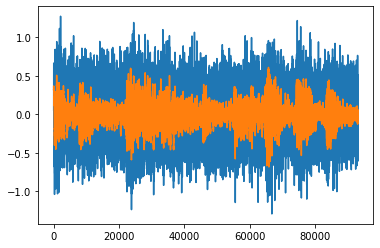

MSE Error = 0.04208316214154765
SNR = 0.54155919104354
SNR(db) = -2.663540691610665


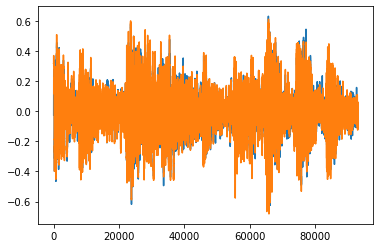

MSE Error = 0.0034421594
SNR = 6.620996
SNR(db) = 8.209233183178725


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_short_voice_25_25_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(short_voice_gaussian_25_25_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_short_voice_25_25_test)), gaussian_noisy_short_voice_25_25_test)
plt.plot(range(len(gaussian_noisy_short_voice_25_25_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_25_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - gaussian_noisy_short_voice_25_25_test, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_short_voice_25_25_test)), pred)
plt.plot(range(len(gaussian_noisy_short_voice_25_25_test)), short_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(short_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(short_voice_test - pred, 2))
signal_power = np.mean(np.power(short_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
write('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_25_LSTM.wav', fs, np.int16(pred/np.max(np.abs(pred))*(np.power(2, 15)-1)))

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_25_test.wav')

In [ ]:
IPython.display.Audio('/content/drive/MyDrive/DL - HW3 Practical/gaussian_noisy_short_voice_25_25_LSTM.wav')

## Long Voice

In [ ]:
long_voice_train = long_voice[0:int(7/10*len(long_voice))]
long_voice_validation = long_voice[int(7/10*len(long_voice)):int(8/10*len(long_voice))]
long_voice_test = long_voice[int(8/10*len(long_voice)):len(long_voice)]

In [ ]:
gaussian_noisy_long_voice = long_voice + np.random.normal(0, 0.05, size=len(long_voice))

In [ ]:
gaussian_noisy_long_voice_train = gaussian_noisy_long_voice[0:int(7/10*len(gaussian_noisy_long_voice))]
gaussian_noisy_long_voice_validation = gaussian_noisy_long_voice[int(7/10*len(gaussian_noisy_long_voice)):int(8/10*len(gaussian_noisy_long_voice))]
gaussian_noisy_long_voice_test = gaussian_noisy_long_voice[int(8/10*len(gaussian_noisy_long_voice)):len(gaussian_noisy_long_voice)]

In [ ]:
uniform_noisy_long_voice = long_voice + 0.1*(2*np.random.rand(len(long_voice))-1)

In [ ]:
uniform_noisy_long_voice_train = uniform_noisy_long_voice[0:int(7/10*len(uniform_noisy_long_voice))]
uniform_noisy_long_voice_validation = uniform_noisy_long_voice[int(7/10*len(uniform_noisy_long_voice)):int(8/10*len(uniform_noisy_long_voice))]
uniform_noisy_long_voice_test = uniform_noisy_long_voice[int(8/10*len(uniform_noisy_long_voice)):len(uniform_noisy_long_voice)]

In [ ]:
def create_dataset(x, noisy_x, n_samples, sample_size):
  data_in = np.zeros((n_samples, sample_size))
  data_out = np.zeros((n_samples, sample_size))
  for i in range(n_samples):
    random_offset = np.random.randint(0, len(x)-sample_size-1)
    data_in[i, :] = noisy_x[random_offset:random_offset+sample_size]
    data_out[i, :] = x[random_offset+1:random_offset+sample_size+1]
  return data_in, data_out

In [ ]:
n_samples = 2000
sample_size = 2048
gaussian_long_voice_train_dataset, gaussian_noisy_long_voice_train_dataset = create_dataset(long_voice_train, gaussian_noisy_long_voice_train, n_samples, sample_size)
uniform_long_voice_train_dataset, uniform_noisy_long_voice_train_dataset = create_dataset(long_voice_train, uniform_noisy_long_voice_train, n_samples, sample_size)

In [ ]:
class CustomRNN(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomRNN, self).__init__()
        self.rnn = torch.nn.RNN(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.rnn(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred
class CustomLSTM(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomLSTM, self).__init__()
        self.lstm = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.lstm(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred

### long Voice - Gaussain Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_gaussian_rnn_model = CustomRNN(input_size, hidden_size, output_size)
long_voice_gaussian_rnn_model = long_voice_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_long_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_long_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0013696623500436544
200 0.001291539752855897
300 0.001255856710486114
400 0.0014207250205799937
500 0.001245556166395545


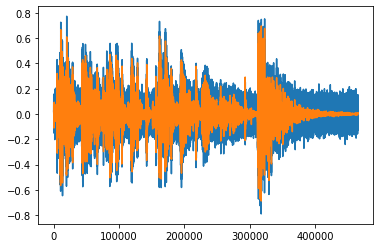

MSE Error = 0.0024969917574997895
SNR = 4.634569589430179
SNR(db) = 6.660094076034978


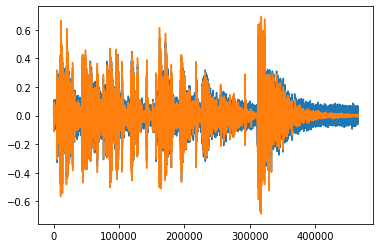

MSE Error = 0.00052795565
SNR = 21.91942
SNR(db) = 13.408290654093772


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_long_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_gaussian_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_long_voice_test)), gaussian_noisy_long_voice_test)
plt.plot(range(len(gaussian_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_long_voice_test)), pred)
plt.plot(range(len(gaussian_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### long Voice - Gaussain Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_gaussian_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
long_voice_gaussian_lstm_model = long_voice_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_long_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_long_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0012181043857708573
200 0.0011806990951299667
300 0.0011649220250546932
400 0.0011409707367420197
500 0.0011665511410683393


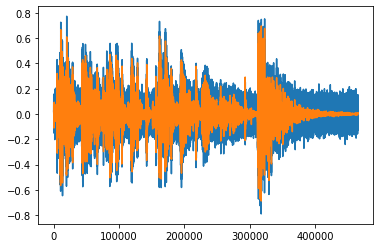

MSE Error = 0.0024969917574997895
SNR = 4.634569589430179
SNR(db) = 6.660094076034978


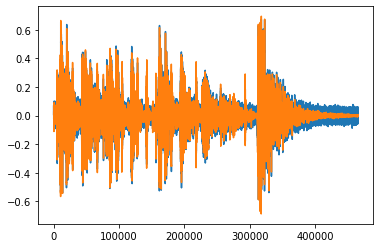

MSE Error = 0.00044883587
SNR = 25.783327
SNR(db) = 14.113389226261479


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_long_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_gaussian_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_long_voice_test)), gaussian_noisy_long_voice_test)
plt.plot(range(len(gaussian_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_long_voice_test)), pred)
plt.plot(range(len(gaussian_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### long Voice - Uniform Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_uniform_rnn_model = CustomRNN(input_size, hidden_size, output_size)
long_voice_uniform_rnn_model = long_voice_uniform_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_uniform_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_long_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_long_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_uniform_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0013637177180498838
200 0.001480376347899437
300 0.0012952318647876382
400 0.0013335701078176498
500 0.001264997641555965


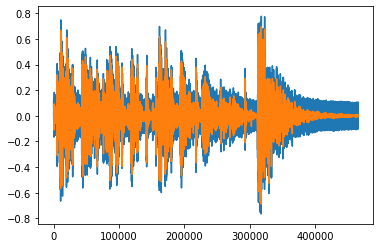

MSE Error = 0.003335014483095067
SNR = 3.469994545159059
SNR(db) = 5.403287920792937


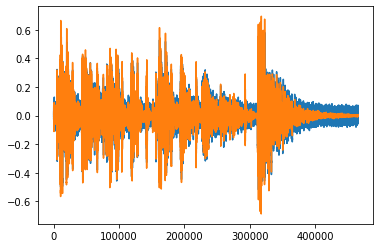

MSE Error = 0.00059938576
SNR = 19.307236
SNR(db) = 12.857201168175719


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_long_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_uniform_rnn_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_long_voice_test)), uniform_noisy_long_voice_test)
plt.plot(range(len(uniform_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - uniform_noisy_long_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - uniform_noisy_long_voice_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_long_voice_test)), pred)
plt.plot(range(len(uniform_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### long Voice - Uniform Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_uniform_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
long_voice_uniform_lstm_model = long_voice_uniform_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_uniform_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(uniform_long_voice_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(uniform_noisy_long_voice_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_uniform_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0012817286187782884
200 0.0012240043142810464
300 0.0012156402226537466
400 0.0012073908001184464
500 0.0012000217102468014


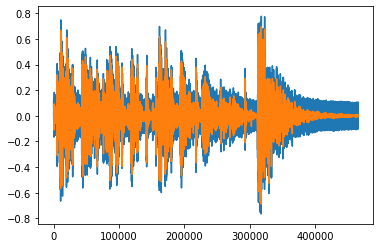

MSE Error = 0.003335014483095067
SNR = 3.469994545159059
SNR(db) = 5.403287920792937


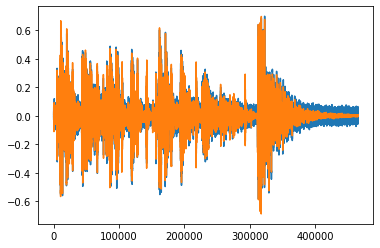

MSE Error = 0.00053807104
SNR = 21.507349
SNR(db) = 13.325868695518569


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(uniform_noisy_long_voice_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_uniform_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(uniform_noisy_long_voice_test)), uniform_noisy_long_voice_test)
plt.plot(range(len(uniform_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - uniform_noisy_long_voice_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - uniform_noisy_long_voice_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(uniform_noisy_long_voice_test)), pred)
plt.plot(range(len(uniform_noisy_long_voice_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### long Voice - Gaussian Noise with Variance 0.1 - LSTM

In [ ]:
gaussian_noisy_long_voice_10 = long_voice + np.random.normal(0, 0.1, size=len(long_voice))
gaussian_noisy_long_voice_10_train = gaussian_noisy_long_voice_10[0:int(7/10*len(long_voice))]
gaussian_noisy_long_voice_10_validation = gaussian_noisy_long_voice_10[int(7/10*len(long_voice)):int(8/10*len(long_voice))]
gaussian_noisy_long_voice_10_test = gaussian_noisy_long_voice_10[int(8/10*len(long_voice)):len(long_voice)]
gaussian_long_voice_10_train_dataset, gaussian_noisy_long_voice_10_train_dataset = create_dataset(long_voice_train, gaussian_noisy_long_voice_10_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_gaussian_10_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
long_voice_gaussian_10_lstm_model = long_voice_gaussian_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_gaussian_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_long_voice_10_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_long_voice_10_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_gaussian_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.001981188775971532
200 0.001944051356986165
300 0.0019131702138110995
400 0.0018798336386680603
500 0.001897340058349073


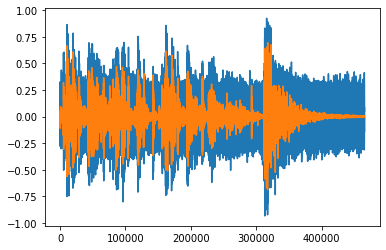

MSE Error = 0.010014307217549057
SNR = 1.1555948717138156
SNR(db) = 0.6280560586917094


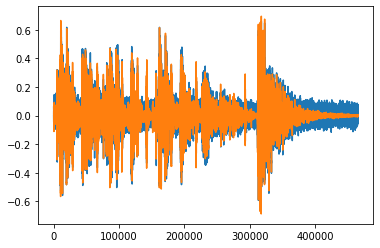

MSE Error = 0.00096220523
SNR = 12.027041
SNR(db) = 10.80158814023524


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_long_voice_10_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_gaussian_10_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_long_voice_10_test)), gaussian_noisy_long_voice_10_test)
plt.plot(range(len(gaussian_noisy_long_voice_10_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_10_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_long_voice_10_test)), pred)
plt.plot(range(len(gaussian_noisy_long_voice_10_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### long Voice - Gaussian Noise with Variance 0.25 - LSTM

In [ ]:
gaussian_noisy_long_voice_25 = long_voice + np.random.normal(0, 0.25, size=len(long_voice))
gaussian_noisy_long_voice_25_train = gaussian_noisy_long_voice_25[0:int(7/10*len(long_voice))]
gaussian_noisy_long_voice_25_validation = gaussian_noisy_long_voice_25[int(7/10*len(long_voice)):int(8/10*len(long_voice))]
gaussian_noisy_long_voice_25_test = gaussian_noisy_long_voice_25[int(8/10*len(long_voice)):len(long_voice)]
gaussian_long_voice_25_train_dataset, gaussian_noisy_long_voice_25_train_dataset = create_dataset(long_voice_train, gaussian_noisy_long_voice_25_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_gaussian_25_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
long_voice_gaussian_25_lstm_model = long_voice_gaussian_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_gaussian_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_long_voice_25_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_long_voice_25_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_gaussian_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.004330245312303305
200 0.004090077243745327
300 0.0040365299209952354
400 0.004122911486774683
500 0.003937394358217716


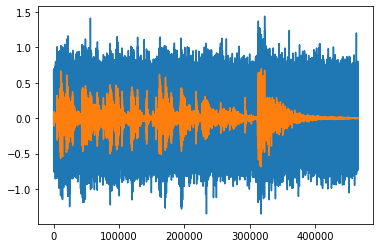

MSE Error = 0.062393215145374444
SNR = 0.18547661051610792
SNR(db) = -7.3171084919849445


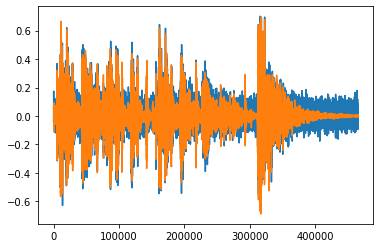

MSE Error = 0.0021492676
SNR = 5.384384
SNR(db) = 7.311360251760805


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_long_voice_25_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_gaussian_25_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_long_voice_25_test)), gaussian_noisy_long_voice_25_test)
plt.plot(range(len(gaussian_noisy_long_voice_25_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_25_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_long_voice_25_test)), pred)
plt.plot(range(len(gaussian_noisy_long_voice_25_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### long Voice - Gaussain Noise with Mean between -0.1 to 0.1 and Variance between 0 to 0.1 - LSTM

In [ ]:
gaussian_noisy_long_voice_10_10 = long_voice + np.random.normal(0.1*(2*np.random.rand(len(long_voice))-1), 0.1*np.random.rand(len(long_voice)), size=len(long_voice))
gaussian_noisy_long_voice_10_10_train = gaussian_noisy_long_voice_10_10[0:int(7/10*len(long_voice))]
gaussian_noisy_long_voice_10_10_validation = gaussian_noisy_long_voice_10_10[int(7/10*len(long_voice)):int(8/10*len(long_voice))]
gaussian_noisy_long_voice_10_10_test = gaussian_noisy_long_voice_10_10[int(8/10*len(long_voice)):len(long_voice)]
gaussian_long_voice_10_10_train_dataset, gaussian_noisy_long_voice_10_10_train_dataset = create_dataset(long_voice_train, gaussian_noisy_long_voice_10_10_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_gaussian_10_10_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
long_voice_gaussian_10_10_lstm_model = long_voice_gaussian_10_10_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_gaussian_10_10_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_long_voice_10_10_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_long_voice_10_10_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_gaussian_10_10_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0017084594583138824
200 0.001674808794632554
300 0.0016593013424426317
400 0.0016383437905460596
500 0.0016095947939902544


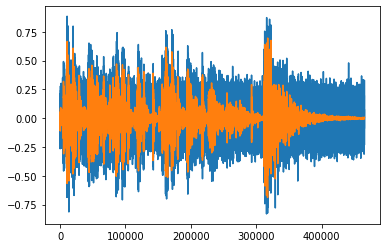

MSE Error = 0.006647075620718342
SNR = 1.740988477443516
SNR(db) = 2.407958967926567


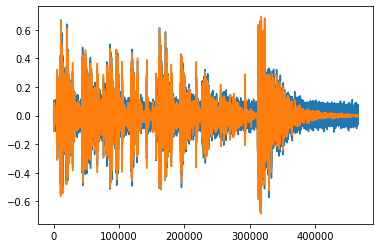

MSE Error = 0.000751245
SNR = 15.404405
SNR(db) = 11.876449131982033


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_long_voice_10_10_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_gaussian_10_10_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_long_voice_10_10_test)), gaussian_noisy_long_voice_10_10_test)
plt.plot(range(len(gaussian_noisy_long_voice_10_10_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_10_10_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_10_10_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_long_voice_10_10_test)), pred)
plt.plot(range(len(gaussian_noisy_long_voice_10_10_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### long Voice - Gaussain Noise with Mean between -0.25 to 0.25 and Variance between 0 to 0.25 - LSTM

In [ ]:
gaussian_noisy_long_voice_25_25 = long_voice + np.random.normal(0.25*(2*np.random.rand(len(long_voice))-1), 0.25*np.random.rand(len(long_voice)), size=len(long_voice))
gaussian_noisy_long_voice_25_25_train = gaussian_noisy_long_voice_25_25[0:int(7/10*len(long_voice))]
gaussian_noisy_long_voice_25_25_validation = gaussian_noisy_long_voice_25_25[int(7/10*len(long_voice)):int(8/10*len(long_voice))]
gaussian_noisy_long_voice_25_25_test = gaussian_noisy_long_voice_25_25[int(8/10*len(long_voice)):len(long_voice)]
gaussian_long_voice_25_25_train_dataset, gaussian_noisy_long_voice_25_25_train_dataset = create_dataset(long_voice_train, gaussian_noisy_long_voice_25_25_train, n_samples, sample_size)

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
long_voice_gaussian_25_25_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
long_voice_gaussian_25_25_lstm_model = long_voice_gaussian_25_25_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(long_voice_gaussian_25_25_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_long_voice_25_25_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_long_voice_25_25_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = long_voice_gaussian_25_25_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.0036403541453182697
200 0.0034702513366937637
300 0.0034719498362392187
400 0.0033954845275729895
500 0.003481219755485654


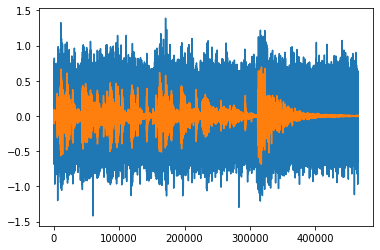

MSE Error = 0.041642112434751515
SNR = 0.277903338417308
SNR(db) = -5.561062360671525


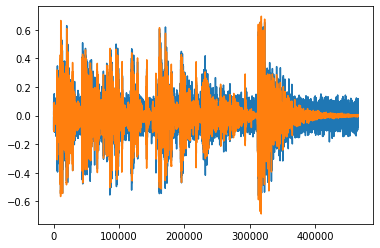

MSE Error = 0.0019310043
SNR = 5.992986
SNR(db) = 7.776432735823131


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_long_voice_25_25_test[np.newaxis, ..., np.newaxis])
  model_input = model_input.to(device)
  pred = np.squeeze(long_voice_gaussian_25_25_lstm_model(model_input).cpu().numpy()[0])
plt.plot(range(len(gaussian_noisy_long_voice_25_25_test)), gaussian_noisy_long_voice_25_25_test)
plt.plot(range(len(gaussian_noisy_long_voice_25_25_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_25_25_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - gaussian_noisy_long_voice_25_25_test, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.plot(range(len(gaussian_noisy_long_voice_25_25_test)), pred)
plt.plot(range(len(gaussian_noisy_long_voice_25_25_test)), long_voice_test)
plt.show()
MSE_erreor = np.mean(np.power(long_voice_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(long_voice_test - pred, 2))
signal_power = np.mean(np.power(long_voice_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Expanation

It is evident from the results that the model decreases the level of noise and the output voice is much cleaner. But as the voice gets longer, denoising becomes harder.

In this part we will explain the method discused in [this paper](https://arxiv.org/abs/1805.00579).

> About the network used in the paper:

Instead of using vanilla MLP, they employ both convolutional and recurrent neural networks because they believe MLPs usually cannot exploit the rich patterns in spectrograms. This assumption is correct because always when we have time-series data, like here, not ignoring the relationship between the consecutive samples is a better choice. So they decided to use convolutional kernels. They do not make any assumptions about the type or the stationarity of the input speech signal's noise.


> Network parts:

*   The convolutional component exploits the local patterns in the spectrogram in both frequency and temporal domains.

*   The bidirectional recurrent component to model the dynamic correlations between consecutive frames

*   A fully-connected layer that predicts the clean spectrograms


> Each layers' input shape:

1) Input: Each input data contains a pair of noisy and clean spectrogram with size $ R^{d*t} $. It means that we have d frames (for the sound data-type, for example, the number of frequency bins) from a spectrogram with length t.

2) Convolutional Component: Convolutional kernel size is $b*w$. So for input x and a kernel z, we have:
$$ h_z(x) = ReLU(x * z) $$
so by applying k kernels with zero-padding of size $ d*[w/2] $ at both sides (because they need to maintain the dimension of the input to t), they get $ (d-b+1)*(t-w+1+2*[w/2]) $ equals to $ (d-b+1)*t $  output size for each kernel.

3) Bi-directional RNN: The input of this part is the output of the convolutional layer. Because we have k kernels, we can make a 2D feature map as follows:
$$ Input_{BENN} = [h_{z_1}(x); h_{z_2}(x); ...; h_{z_k}(x) ] → R^{pk*t} $$

4) Finally, the FC component of the network gets the output of the previous LSTM layer, which is $H'(x) ∈ R^{q*t}$. Because the output shape should be $d*t$, &nbsp; this layer weights and biases should be in form something like this:
$$ ouput_t = ReLU(0, W*H'_t+b_w)  W∈R^{d*q}, b_w∈R^d $$

> The Network's cost function :

As we described for the network input, we have $ n $ samples that contains a pair of noisy and clean spectrogram each, with the shape $d*t$. So after the network FC layer we will get spectrogram for each frame of our input. We can annotate the network ouput of $x_i$ as $ g_θ(x_i) $ and define the optimization problem with the loss function equals to norm 2 of the difference between the clean spectrogram ($y_i$) and the network's output for the input $x_i$ ($g_θ(x_i)$)

$$ OP:  min_{θ} \sum _{i=1} ^{n} || g_θ(x_i) - y_i ||^{2}_{F} $$

# H)

## Gray Image

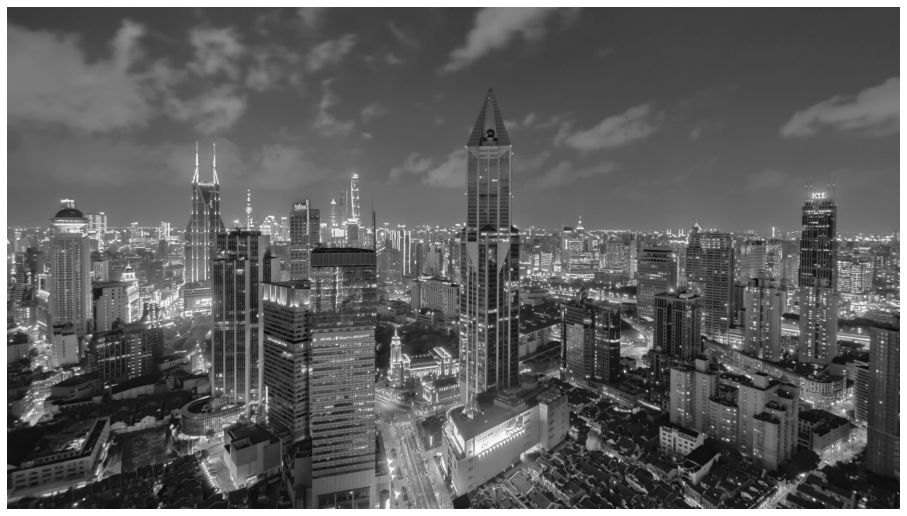

In [ ]:
image = cv2.imread('/content/drive/MyDrive/DL - HW3 Practical/city-sample.jpg', cv2.IMREAD_GRAYSCALE)/255
plt.figure(figsize=(16, 12))
plt.imshow(image, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
image_train = image[:, range(0, image.shape[1], 2)]
flatten_image_train = np.reshape(image_train, (-1, 1), order='F')
image_test = image[:, range(1, image.shape[1]+1, 2)]
flatten_image_test = np.reshape(image_test, (-1, 1), order='F')

In [ ]:
gaussian_noisy_image = image + np.random.normal(0, 0.25, size=image.shape)
gaussian_noisy_image = np.clip(gaussian_noisy_image, 0, 1)

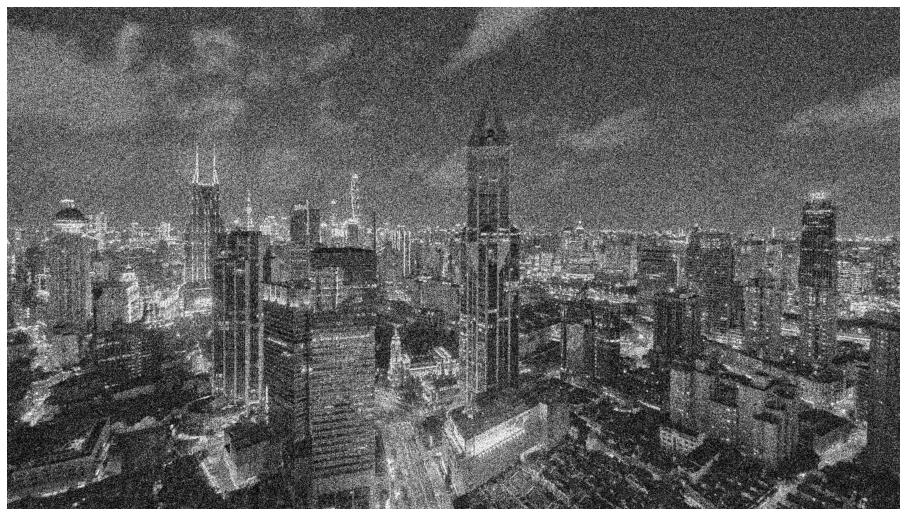

In [ ]:
plt.figure(figsize=(16, 12))
plt.imshow(gaussian_noisy_image, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
gaussian_noisy_image_train = np.reshape(gaussian_noisy_image[:, range(0, gaussian_noisy_image.shape[1], 2)], (-1, 1), order='F')
gaussian_noisy_image_test = np.reshape(gaussian_noisy_image[:, range(1, gaussian_noisy_image.shape[1]+1, 2)], (-1, 1), order='F')

In [ ]:
salt_and_peper_noisy_image = image.copy()
pixels_X = np.random.choice(image.shape[0], int(0.1*image.shape[0]*image.shape[1]), True)
pixels_Y = np.random.choice(image.shape[1], int(0.1*image.shape[0]*image.shape[1]), True)
salt_and_peper_noisy_image[pixels_X, pixels_Y] = 0
pixels_X = np.random.choice(image.shape[0], int(0.1*image.shape[0]*image.shape[1]), True)
pixels_Y = np.random.choice(image.shape[1], int(0.1*image.shape[0]*image.shape[1]), True)
salt_and_peper_noisy_image[pixels_X, pixels_Y] = 1

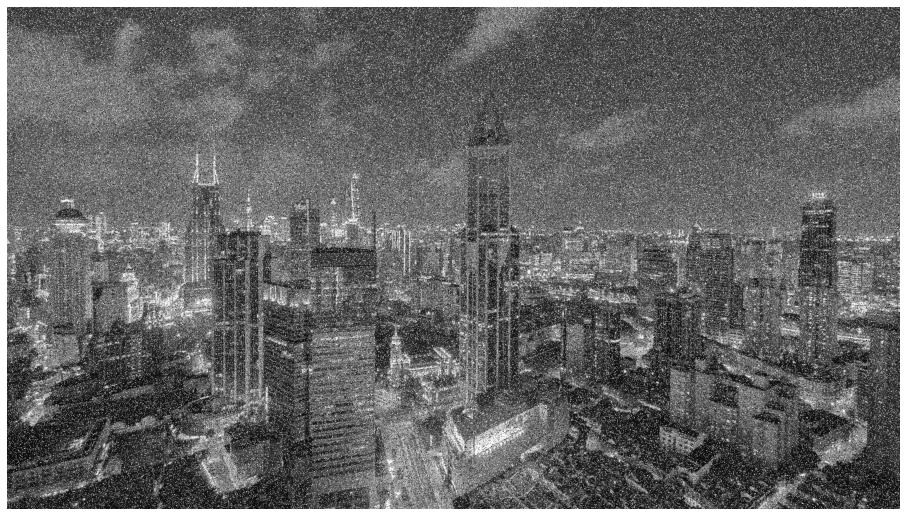

In [ ]:
plt.figure(figsize=(16, 12))
plt.imshow(salt_and_peper_noisy_image, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
salt_and_peper_noisy_image_train = np.reshape(salt_and_peper_noisy_image[:, range(0, salt_and_peper_noisy_image.shape[1], 2)], (-1, 1), order='F')
salt_and_peper_noisy_image_test = np.reshape(salt_and_peper_noisy_image[:, range(1, salt_and_peper_noisy_image.shape[1]+1, 2)], (-1, 1), order='F')

In [ ]:
def create_dataset(x, noisy_x, n_samples, sample_size):
  data_in = np.zeros((n_samples, sample_size))
  data_out = np.zeros((n_samples, sample_size))
  for i in range(n_samples):
    random_offset = np.random.randint(0, len(x)-sample_size-1)
    data_in[i, :] = noisy_x[random_offset:random_offset+sample_size].T
    data_out[i, :] = x[random_offset+1:random_offset+sample_size+1].T
  return data_in, data_out

In [ ]:
n_samples = image.shape[1]
sample_size = image.shape[0]
gaussian_image_train_dataset, gaussian_noisy_image_train_dataset = create_dataset(flatten_image_train, gaussian_noisy_image_train, n_samples, sample_size)
salt_and_peper_image_train_dataset, salt_and_peper_noisy_image_train_dataset = create_dataset(flatten_image_train, salt_and_peper_noisy_image_train, n_samples, sample_size)

In [ ]:
class CustomRNN(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomRNN, self).__init__()
        self.rnn = torch.nn.RNN(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.rnn(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred
class CustomLSTM(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(CustomLSTM, self).__init__()
        self.lstm = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.lstm(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 1)
        return pred

### Image - Gaussain Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
image_gaussian_rnn_model = CustomRNN(input_size, hidden_size, output_size)
image_gaussian_rnn_model = image_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_image_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_image_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.010387002490460873
200 0.009798910468816757
300 0.00984591618180275
400 0.0097341975197196
500 0.0100836381316185


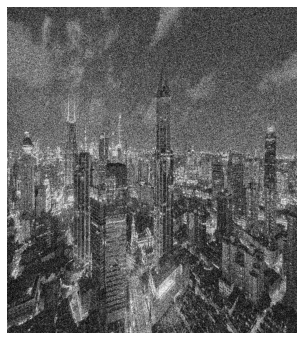

MSE Error = 0.050336720555218
SNR = 2.789766988397
SNR(db) = 4.455679309153891


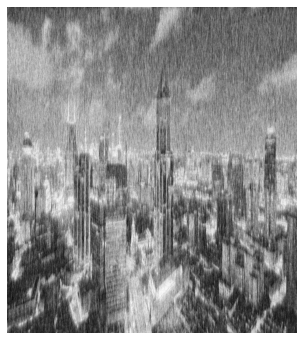

MSE Error = 0.0092152892892412
SNR = 15.238558107238203
SNR(db) = 11.829438754225293


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_gaussian_rnn_model(model_input).cpu().numpy(), image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(gaussian_noisy_image_test, image_test.shape, order='F'), cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - gaussian_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - gaussian_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred, cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Image - Gaussain Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
image_gaussian_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
image_gaussian_lstm_model = image_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_image_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_image_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.009757264517247677
200 0.00964517891407013
300 0.009560040198266506
400 0.009536531753838062
500 0.009572495706379414


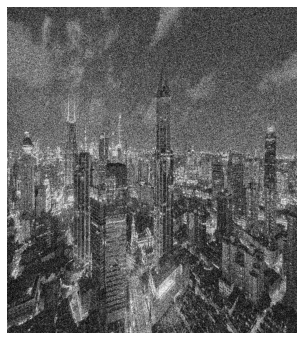

MSE Error = 0.050336720555218
SNR = 2.789766988397
SNR(db) = 4.455679309153891


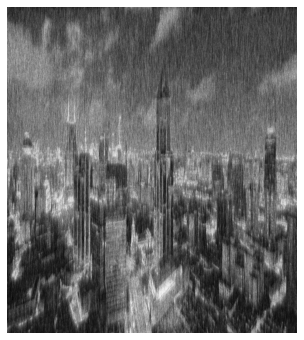

MSE Error = 0.008397374454816439
SNR = 16.72281283450061
SNR(db) = 12.233093290693748


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_gaussian_lstm_model(model_input).cpu().numpy(), image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(gaussian_noisy_image_test, image_test.shape, order='F'), cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - gaussian_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - gaussian_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred, cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Image - Salt and Peper Noise - RNN

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
image_salt_and_peper_rnn_model = CustomRNN(input_size, hidden_size, output_size)
image_salt_and_peper_rnn_model = image_salt_and_peper_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_salt_and_peper_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(salt_and_peper_image_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(salt_and_peper_noisy_image_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_salt_and_peper_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.010371911339461803
200 0.010322384536266327
300 0.01027679443359375
400 0.011281929910182953
500 0.009777450002729893


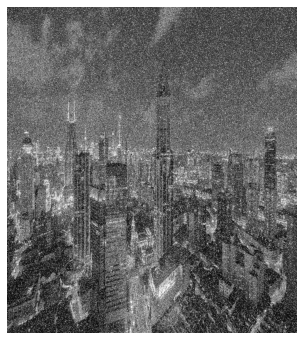

MSE Error = 0.05532889369769934
SNR = 2.538054024292755
SNR(db) = 4.045008621253222


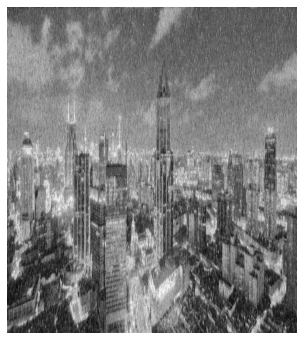

MSE Error = 0.007670060697977846
SNR = 18.30855410911345
SNR(db) = 12.626540478938198


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(salt_and_peper_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_salt_and_peper_rnn_model(model_input).cpu().numpy(), image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(salt_and_peper_noisy_image_test, image_test.shape, order='F'), cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - salt_and_peper_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - salt_and_peper_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred, cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Image - Salt and Peper Noise - LSTM

In [ ]:
input_size = 1
hidden_size = 50
output_size = 1
image_salt_and_peper_lstm_model = CustomLSTM(input_size, hidden_size, output_size)
image_salt_and_peper_lstm_model = image_salt_and_peper_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_salt_and_peper_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(salt_and_peper_image_train_dataset[..., np.newaxis])
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(salt_and_peper_noisy_image_train_dataset[..., np.newaxis])
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_salt_and_peper_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.010257037356495857
200 0.009635594673454762
300 0.009138857945799828
400 0.00892459787428379
500 0.008326929993927479


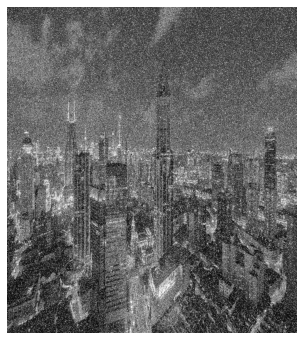

MSE Error = 0.05532889369769934
SNR = 2.538054024292755
SNR(db) = 4.045008621253222


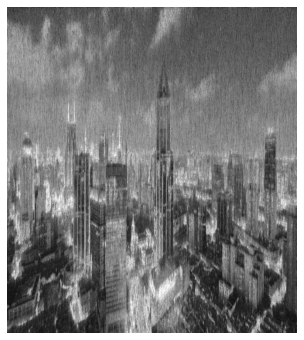

MSE Error = 0.007018571828243198
SNR = 20.008019401329115
SNR(db) = 13.012040998483002


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(salt_and_peper_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_salt_and_peper_lstm_model(model_input).cpu().numpy(), image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(salt_and_peper_noisy_image_test, image_test.shape, order='F'), cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - salt_and_peper_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F') - salt_and_peper_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test, (-1, 1), order='F'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred, cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## RGB Image

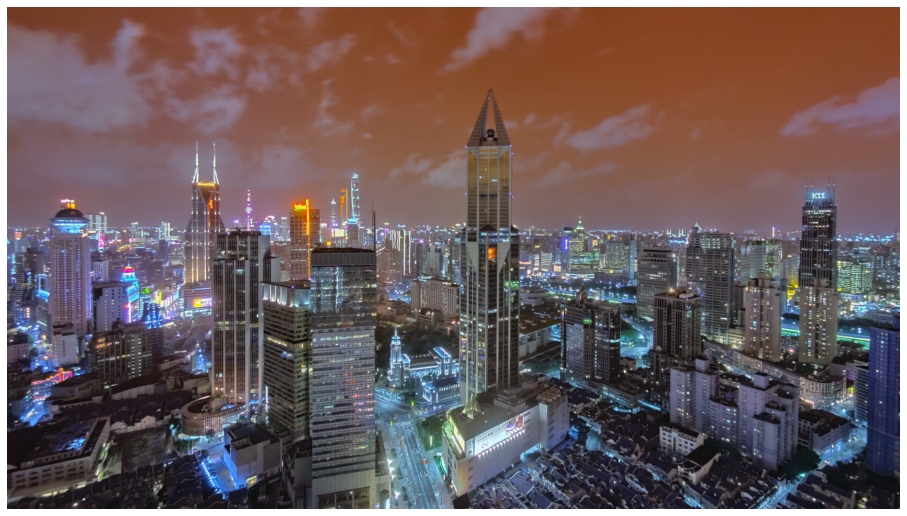

In [ ]:
image = cv2.imread('/content/drive/MyDrive/DL - HW3 Practical/city-sample.jpg', cv2.IMREAD_COLOR)/255
plt.figure(figsize=(16, 12))
plt.imshow(image)
plt.axis('off')
plt.show()

In [ ]:
image_train = image[:, range(0, image.shape[1], 2), :]
flatten_image_train = np.reshape(image_train.T, (-1, 3), order='C')
image_test = image[:, range(1, image.shape[1]+1, 2), :]
flatten_image_test = np.reshape(image_test.T, (-1, 3), order='C')

In [ ]:
gaussian_noisy_image = image + np.random.normal(0, 0.25, size=image.shape)
gaussian_noisy_image = np.clip(gaussian_noisy_image, 0, 1)

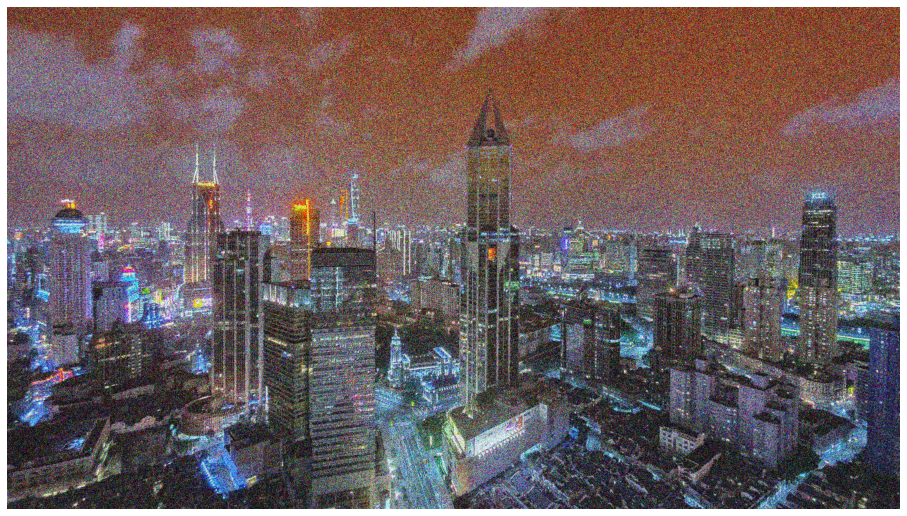

In [ ]:
plt.figure(figsize=(16, 12))
plt.imshow(gaussian_noisy_image, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
gaussian_noisy_image_train = np.reshape(gaussian_noisy_image[:, range(0, gaussian_noisy_image.shape[1], 2)].T, (-1, 3), order='C')
gaussian_noisy_image_test = np.reshape(gaussian_noisy_image[:, range(1, gaussian_noisy_image.shape[1]+1, 2)].T, (-1, 3), order='C')

In [ ]:
salt_and_peper_noisy_image = image.copy()
pixels_X = np.random.choice(image.shape[0], int(0.1*image.shape[0]*image.shape[1]), True)
pixels_Y = np.random.choice(image.shape[1], int(0.1*image.shape[0]*image.shape[1]), True)
salt_and_peper_noisy_image[pixels_X, pixels_Y] = 0
pixels_X = np.random.choice(image.shape[0], int(0.1*image.shape[0]*image.shape[1]), True)
pixels_Y = np.random.choice(image.shape[1], int(0.1*image.shape[0]*image.shape[1]), True)
salt_and_peper_noisy_image[pixels_X, pixels_Y] = 1

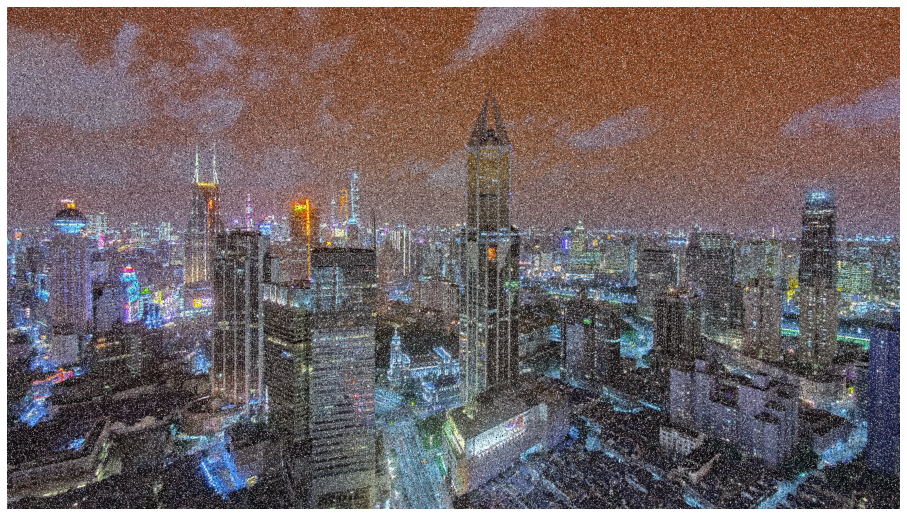

In [ ]:
plt.figure(figsize=(16, 12))
plt.imshow(salt_and_peper_noisy_image, cmap='gray')
plt.axis('off')
plt.show()

In [ ]:
salt_and_peper_noisy_image_train = np.reshape(salt_and_peper_noisy_image[:, range(0, salt_and_peper_noisy_image.shape[1], 2)].T, (-1, 3), order='C')
salt_and_peper_noisy_image_test = np.reshape(salt_and_peper_noisy_image[:, range(1, salt_and_peper_noisy_image.shape[1]+1, 2)].T, (-1, 3), order='C')

In [ ]:
def create_dataset(x, noisy_x, n_samples, sample_size):
  data_in = np.zeros((n_samples, sample_size, 3))
  data_out = np.zeros((n_samples, sample_size, 3))
  for i in range(n_samples):
    random_offset = np.random.randint(0, x.shape[0]-sample_size-1)
    data_in[i, :, :] = noisy_x[random_offset:random_offset+sample_size, :]
    data_out[i, :, :] = x[random_offset+1:random_offset+sample_size+1, :]
  return data_in, data_out

In [ ]:
n_samples = image.shape[1]
sample_size = image.shape[0]
gaussian_image_train_dataset, gaussian_noisy_image_train_dataset = create_dataset(flatten_image_train, gaussian_noisy_image_train, n_samples, sample_size)
salt_and_peper_image_train_dataset, salt_and_peper_noisy_image_train_dataset = create_dataset(flatten_image_train, salt_and_peper_noisy_image_train, n_samples, sample_size)

In [ ]:
class Custom3DRNN(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(Custom3DRNN, self).__init__()
        self.rnn = torch.nn.RNN(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.rnn(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 3)
        return pred
class Custom3DLSTM(torch.nn.Module):
    def __init__(self, input_size, hidden_size, output_size):
        super(Custom3DLSTM, self).__init__()
        self.lstm = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size, batch_first=True)
        self.linear1 = torch.nn.Linear(hidden_size, hidden_size)
        self.activation1 = torch.nn.Tanh()
        self.linear2 = torch.nn.Linear(hidden_size, output_size)
        self.activation2 = torch.nn.Tanh()
    def forward(self, x):
        pred, hidden = self.lstm(x, None)
        pred = self.activation2(self.linear2(self.activation1(self.linear1(pred)))).view(pred.data.shape[0], -1, 3)
        return pred

### Image - Gaussain Noise - RNN

In [ ]:
input_size = 3
hidden_size = 50
output_size = 3
image_gaussian_rnn_model = Custom3DRNN(input_size, hidden_size, output_size)
image_gaussian_rnn_model = image_gaussian_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_gaussian_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_image_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_image_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_gaussian_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.011086462065577507
200 0.010990047827363014
300 0.01105016004294157
400 0.010936269536614418
500 0.010903001762926579


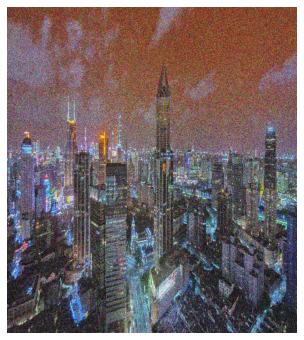

MSE Error = 0.05017459919270649
SNR = 3.117247548764036
SNR(db) = 4.937712921046621


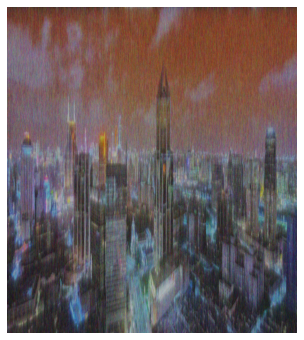

MSE Error = 0.008302256352654129
SNR = 18.839052867077637
SNR(db) = 12.750590648612345


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_gaussian_rnn_model(model_input).cpu().numpy().T, image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(gaussian_noisy_image_test.T, image_test.shape, order='F'))
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C') - gaussian_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C') - gaussian_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred)
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Image - Gaussain Noise - LSTM

In [ ]:
input_size = 3
hidden_size = 50
output_size = 3
image_gaussian_lstm_model = Custom3DLSTM(input_size, hidden_size, output_size)
image_gaussian_lstm_model = image_gaussian_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_gaussian_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(gaussian_image_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(gaussian_noisy_image_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_gaussian_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.010986165143549442
200 0.010889806784689426
300 0.010840610601007938
400 0.010615297593176365
500 0.010469544678926468


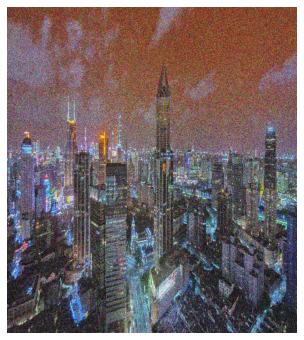

MSE Error = 0.05017459919270649
SNR = 3.117247548764036
SNR(db) = 4.937712921046621


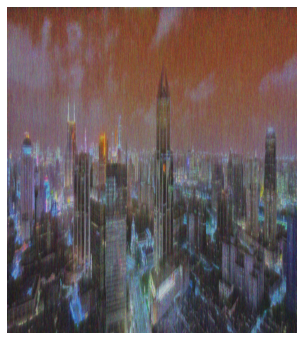

MSE Error = 0.007749725771453375
SNR = 20.182216888217706
SNR(db) = 13.049688690089319


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(gaussian_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_gaussian_lstm_model(model_input).cpu().numpy().T, image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(gaussian_noisy_image_test.T, image_test.shape, order='F'))
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C') - gaussian_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C') - gaussian_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred)
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Image - Salt and Peper Noise - RNN

In [ ]:
input_size = 3
hidden_size = 50
output_size = 3
image_salt_and_peper_rnn_model = Custom3DRNN(input_size, hidden_size, output_size)
image_salt_and_peper_rnn_model = image_salt_and_peper_rnn_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_salt_and_peper_rnn_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(salt_and_peper_image_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(salt_and_peper_noisy_image_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_salt_and_peper_rnn_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.011749591678380966
200 0.011452571488916874
300 0.011340218596160412
400 0.011244130320847034
500 0.011149220168590546


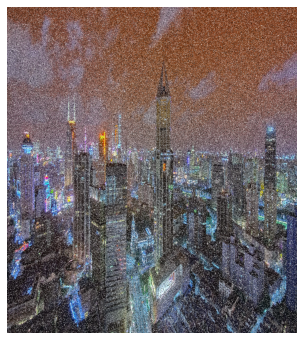

MSE Error = 0.09982578099413325
SNR = 1.5667961200611529
SNR(db) = 1.9501248741111177


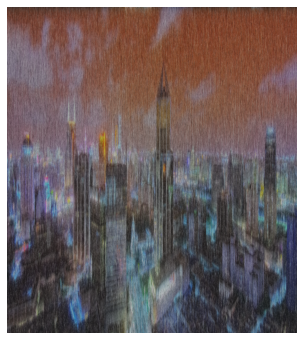

MSE Error = 0.008727053126352993
SNR = 17.92204585891459
SNR(db) = 12.533875842615176


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(salt_and_peper_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_salt_and_peper_rnn_model(model_input).cpu().numpy().T, image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(salt_and_peper_noisy_image_test.T, image_test.shape, order='F'))
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test, (-1, 3), order='C') - salt_and_peper_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test, (-1, 3), order='C') - salt_and_peper_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test, (-1, 3), order='C'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred)
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

### Image - Salt and Peper Noise - LSTM

In [ ]:
input_size = 3
hidden_size = 50
output_size = 3
image_salt_and_peper_lstm_model = Custom3DLSTM(input_size, hidden_size, output_size)
image_salt_and_peper_lstm_model = image_salt_and_peper_lstm_model.to(device)

In [ ]:
lr = 1e-2
optimizer = torch.optim.Adam(image_salt_and_peper_lstm_model.parameters(), lr=lr)
loss_func = torch.nn.MSELoss()
for epoch in range(500):
  optimizer.param_groups[0]['lr'] = lr
  model_in = torch.Tensor(salt_and_peper_image_train_dataset)
  model_in.requires_grad = True
  model_in = model_in.to(device)
  model_out = torch.Tensor(salt_and_peper_noisy_image_train_dataset)
  model_out.requires_grad = True
  model_out = model_out.to(device)
  optimizer.zero_grad()
  pred = image_salt_and_peper_lstm_model(model_in)
  loss = loss_func(pred, model_out)
  if (epoch+1)%100==0:
    print((epoch+1), loss.data.item())
  loss.backward()
  optimizer.step()
  lr = lr/1.001

100 0.011309792287647724
200 0.010882852599024773
300 0.010362150147557259
400 0.009926654398441315
500 0.00942966528236866


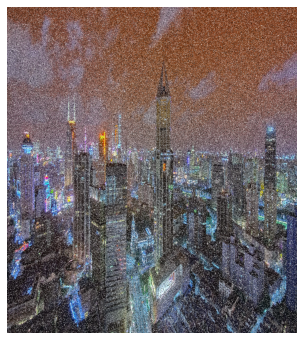

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


MSE Error = 0.05517809652092504
SNR = 2.834578504975586
SNR(db) = 4.524884894820659


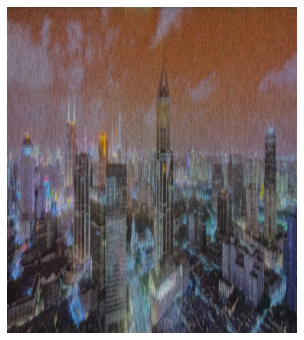

MSE Error = 0.006579242811435458
SNR = 23.772742673644768
SNR(db) = 13.760792893982018


In [ ]:
with torch.no_grad():
  model_input = torch.Tensor(salt_and_peper_noisy_image_test[np.newaxis, ...])
  model_input = model_input.to(device)
  pred = np.reshape(image_salt_and_peper_lstm_model(model_input).cpu().numpy().T, image_test.shape, order='F')
plt.figure(figsize=(8, 6))
plt.imshow(np.reshape(salt_and_peper_noisy_image_test.T, image_test.shape, order='F'))
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C') - salt_and_peper_noisy_image_test, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C') - salt_and_peper_noisy_image_test, 2))
signal_power = np.mean(np.power(np.reshape(image_test.T, (-1, 3), order='C'), 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))
plt.figure(figsize=(8, 6))
plt.imshow(pred, cmap='gray')
plt.axis('off')
plt.show()
MSE_erreor = np.mean(np.power(image_test - pred, 2))
print('MSE Error =', MSE_erreor)
noise_power = np.mean(np.power(image_test - pred, 2))
signal_power = np.mean(np.power(image_test, 2))
SNR = signal_power/noise_power
print('SNR =', SNR)
print('SNR(db) =', 10*np.log(SNR)/np.log(10))

## Expanation

Yes, it depends on what pixel series we choose for the training. <br>
As expected, the performance of the RNN and the LSTM models on the 2D picture is not as good as on 1D signals. The output image is completely blurred and has less quality than the input image.

In this part we will explain the method discused in [this paper](https://arxiv.org/abs/1806.02919).

The model consentrate on non-local RNN methods for image restoration task. They try to combine non-local operation with recurrent architecture.

> what is Non-Locality?

Image self-similarity, collaborative filtering, non-local means, and low-rank modeling are some different non-local operations. A non-local operation multi-channel image feature input with the size $ N_{pixel}*m_{channels} $ gives an output feature of size $ N*k $ with the following form:

$$ Out = diag\{{δ(X)}\}^{-1}Φ(X)G(X) $$

*   $ Φ(X) $ is the $ N*N $ non-local correlation matrix of the pixels
*   $ G(X) $ is the non-local transform from N channels to k channels
*   $ diag\{{δ(X)}\}^{-1} $ is the normalization term

So we can develop different non-linear approaches. One of them is BM. BM selects the $ Ki $ most similar patches from this neighborhood used jointly to restore $ Xi $. They use a soft block-matching approach as their non-local module and apply the Euclidean distance with a linearly embedded Gaussian kernel as the distance metric. The non-linear module mathematical details are available in the paper.

> Non-Local Recurrent Network

Their RNN model completely matches the standard models containing input, output, and recurrent states. They also add an identity path from the first state, which helps gradient backpropagation during training, and a residual path of the deep feature correlation between each location and the neighborhood from the previous layer. The weights in the non-local module are shared across recurrent states just as convolutional layers, so the NLRN still keeps high parameter efficiency.

> Relation to Other RNN Methods

*   DRCN applies a single convolutional layer multiple times. But in this model, as mentioned, we have non-local approaches and the identity path from the first state in its RNN part.

*   DRRN applies both the identity path and the residual path in each state, but without non-local operations

*   MemNet builds dense connections among several types of memory blocks, and weights are shared in the same types of memory blocks but are different across various types